# Chapter 1 - Data Preprocessing

1. Import libraries.


2. Import dataset. Split into **features** (x-var) and **dependent variable vector** (y-var):
    - To **locate indexes**, we use *iloc(row,col)*.
    - We use .values because we want to turn that pandas DF into a numpy array.


3. Handle missing data. There are several options:
    - Deletion. Okay for large datasets and few missing.
    - Replace with mean / median for numbers, and mode for categories. Use scikitlearn. 
    
    
4. Encode data.
    - For categorical data, we do this so that models will have a easier time to process them as numbers. But cannot just mere numbers or the machine will misinterpret wrong relationships and assume there is an order (1 2 3 got order). Prof's methods are to use **one hot encoding** into binary forms.
    - *ColumnTransformer(transformers=[(what_transformation, what_transformation_exactly, indexes)], remainder="do_what?")* where apply at index but don't touch remainder.
  
  
5. Split into train and test set.


6. Feature scaling. There are a lot of debates if should feature scale before or after train-test split. But there's only one answer: **only do this after splitting**. Feature scaling is done to prevent one feature from dominating the others **as many models are based on Euclidean distance**. The test set is meant to be separate from the train set to properly test it; it is akin to new data in the future. If you feature scale everything together, then it would cause **information leakage** on the test set. Additionally, you use the trainset's mean and SD to scale for each new testset; your testset needs to be scaled by the same scaler used on the training set. This is because the model is trained with a particular scaler, in order to make predictions that are congruent with how it was trained, we need to apply the trainset's scalar on any future testsets.
    - Standardisation's numbers fall between -3 and 3.
    - Normalisation's numbers fall between 0 and 1.
    - Normalisation better if most features have normal dist. Standardisation works well all the time. Since all the time and not needing to care about the features, use standardisation.
    - You do not need to apply standardisation to the dummy variables (aka the one hot encoding). Since dummy variables are already between -3 and 3, then no need. In fact, applying standardisation to them makes it worse as it'll stretch them to -3 and 3, losing the information / interpretation of what they stand for.
    - Not all models need feature scaling. A lot of them incorporate inside.

<div>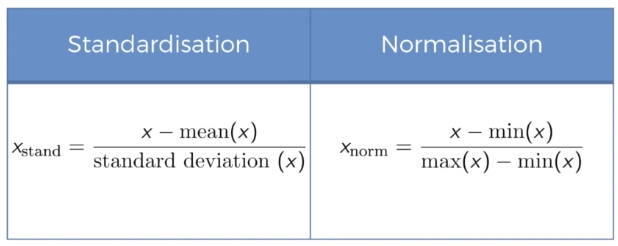</div>

<ins>Further Notes</ins>
- fit() only calculates mean and sd for each col. It is a function that **fits an equation/model to data**. It extracts out some information of the data on which the object is applied.
- transform() actually does the transformation. It is a function that **applies the fit() to a dataset**.

In [76]:
### 1. Libraries

import numpy as np # to work with arrays
import matplotlib.pyplot as plt # to make nice charts
import pandas as pd # to import datasets and as matrices

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/01 Data Processing/Data.csv")
X = data.iloc[:,:-1].values # matrix of features
Y = data.iloc[:,-1].values # dependent variable vector

### 3. Missing Data

from sklearn.impute import SimpleImputer # import class
imputer = SimpleImputer(missing_values=np.nan, strategy='mean') # create instance. The missing values have the np value of None, and replace by mean.
imputer.fit(X[:,1:3]) # to apply the function to the dataset, calculate mean etc. Calculations here only.
X[:,1:3] = imputer.transform(X[:,1:3]) # the actual replacement

### 4. Encoding

# Categorical Data (One-Hot Encoding)
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
ct = ColumnTransformer(transformers=[('encoder',OneHotEncoder(),[0])], remainder="passthrough") # create new object / instance of the CT class
X = np.array(ct.fit_transform(X)) # fit and transform together. returns DF, so must make it array again.

# Dependent Variable (turn into 1s and 0s)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
Y = le.fit_transform(Y)

# print(data,"\n",X,"\n",Y)

### 5. Split (into 4 sets)

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 1) # random_state = set seed
# print(X_train,"\n###\n",X_test,"\n###\n",Y_train,"\n###\n",Y_test)

### 6. Feature Scaling (prevent dominating features)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train[:,3:] = sc.fit_transform(X_train[:,3:])
X_test[:,3:] = sc.transform(X_test[:,3:]) # no fitting!!!

print(X_train, "\n", X_test)

[[0.0 0.0 1.0 -0.19159184384578545 -1.0781259408412425]
 [0.0 1.0 0.0 -0.014117293757057777 -0.07013167641635372]
 [1.0 0.0 0.0 0.566708506533324 0.633562432710455]
 [0.0 0.0 1.0 -0.30453019390224867 -0.30786617274297867]
 [0.0 0.0 1.0 -1.9018011447007988 -1.420463615551582]
 [1.0 0.0 0.0 1.1475343068237058 1.232653363453549]
 [0.0 1.0 0.0 1.4379472069688968 1.5749910381638885]
 [1.0 0.0 0.0 -0.7401495441200351 -0.5646194287757332]] 
 [[0.0 1.0 0.0 -1.4661817944830124 -0.9069571034860727]
 [1.0 0.0 0.0 -0.44973664397484414 0.2056403393225306]]


# Chapter 2 - Simple Linear Regression

Basically represented as:

    y = b0 + b1x1
    
It creates a **best fit line** based on the least sum of squared error / min SSE. Also note that **p-values only apply to linear models**.

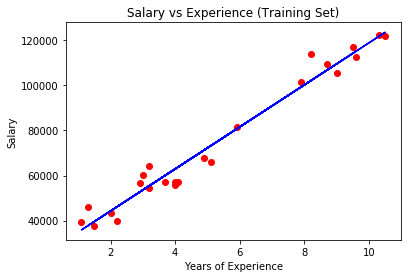

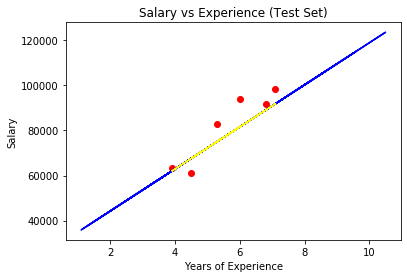

[137605.23485427]
[9332.94473799] 25609.89799835482


In [16]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Salary_Data.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values

### 3. Split (into 4 sets)

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 1) # random_state = set seed
# print(X_train,"\n###\n",X_test,"\n###\n",Y_train,"\n###\n",Y_test)

### 4. Training the Model

from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, Y_train) # at this point, fit() will take the values of both and compute the coefficients b0 and b1

### 5. Predict

Y_predictions = regressor.predict(X_test)

### 6. Visualisations

plt.scatter(X_train, Y_train, color='red')
plt.plot(X_train, regressor.predict(X_train), color='blue')
plt.title("Salary vs Experience (Training Set)")
plt.xlabel("Years of Experience")
plt.ylabel("Salary")
plt.show()

plt.scatter(X_test, Y_test, color='red')
plt.plot(X_train, regressor.predict(X_train), color='blue') # don't need change!
plt.plot(X_test, Y_predictions, color='yellow') # see? exact same line
plt.title("Salary vs Experience (Test Set)")
plt.xlabel("Years of Experience")
plt.ylabel("Salary")
plt.show()

### Bonus

# Predict an employee with 12 years experience:
print(regressor.predict([[12]])) # double brackets cos it expects a 2D array

# Get the coeffecients
print(regressor.coef_, regressor.intercept_)

# Chapter 3 - Multiple Linear Regression
<div>&nbsp;</div>
<div>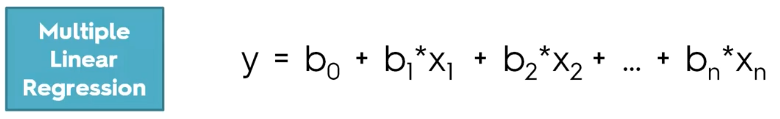</div>

<ins>Assumptions of All Kinds of Linear Regressions</ins>
- Linearity
- Homoscedasticity (the same variance at every X value)
- Multivariate normality (all residuals, aka y - yhat, are normally distributed)
- Independence of errors (all residuals, aka y - yhat, are independent)
- Lack of multicollinearity

Before using any LR model, need to check these are true. See [here](https://www.statisticssolutions.com/assumptions-of-multiple-linear-regression/).

<ins>Notes</ins>
- For MLR, **no need any feature scaling** because how big or small, the betas will adjust themselves and put everything on the same scale.
- You don't need to check for the 5 assumptions, because if they do not hold, you will have bad performance results anyway.
- For the model we are importing, we don't have to worry about **dummy variable trap**. Can just keep everything.
- The model we are importing also automatically takes care of selecting the best features. Hence, no need to do any backward eliminations etc.

In [9]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/50_Startups.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values

### 3. Encoding

# Categorical Data (One-Hot Encoding)
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
ct = ColumnTransformer(transformers=[('encoder',OneHotEncoder(),[3])], remainder="passthrough") # create new object / instance of the CT class
X = np.array(ct.fit_transform(X)) # fit and transform together. returns DF, so must make it array again.

### 4. Split (into 4 sets)

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 1) # random_state = set seed

### 5. Modelling

from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train,Y_train)

### 6. Predictions

Y_pred = regressor.predict(X_test)

### 7. Comparisons

np.set_printoptions(precision=2) # 2 dp only
print(np.concatenate((Y_pred.reshape(len(Y_pred),1), Y_test.reshape(len(Y_test),1)),1)) # reshape both into vertical arrays, then concatenate them side by side horizontally. the form is concatenate((tuple_part1,tuple_part2),axis)
# since numbers are close, the model is probably good

### 8. Bonus

# Predict profit if R&D 160K, Admin 130K, Mkt 300K, State California
print(regressor.predict([[1,0,0,160000,130000,300000]])) # need 2D

# Model?
print(regressor.coef_, regressor.intercept_)

[[114664.42 105008.31]
 [ 90593.16  96479.51]
 [ 75692.84  78239.91]
 [ 70221.89  81229.06]
 [179790.26 191050.39]
 [171576.92 182901.99]
 [ 49753.59  35673.41]
 [102276.66 101004.64]
 [ 58649.38  49490.75]
 [ 98272.03  97483.56]]
[180892.25]
[-2.85e+02  2.98e+02 -1.24e+01  7.74e-01 -9.44e-03  2.89e-02] 49834.88507321703


# Chapter 4 - Polynomial Regression
<div>&nbsp;</div>
<div>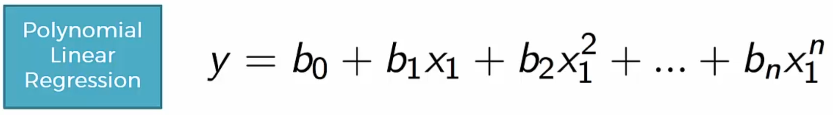</div>

**Q: Why is it still called LINEAR?** When you're talking about the class of regression, you're actually referring to the coefficients b0 b1 bn etc.!!! You're actually asking "can this function be expressed as a linear combination of these coefficients?" An example of a non-linear regression would be the equation y = 0 + b1X1 / b2+x2 etc, where you cannot replace the coefficients with other coefficients to turn the equation into a linear one in regards to the coefficients not the x-values.

But note that while PR is linear on its coefficients, but it is a non-linear function of X.

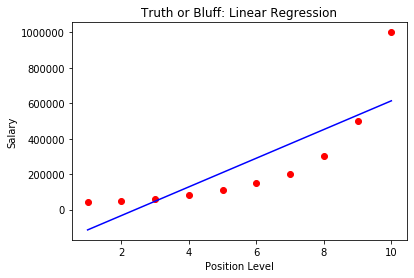

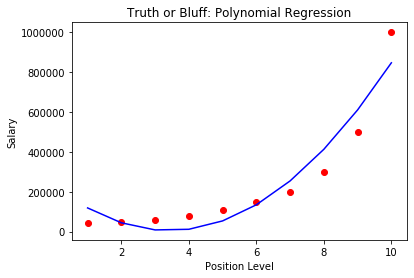

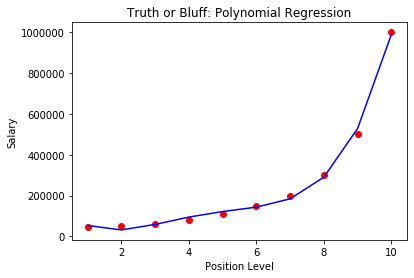

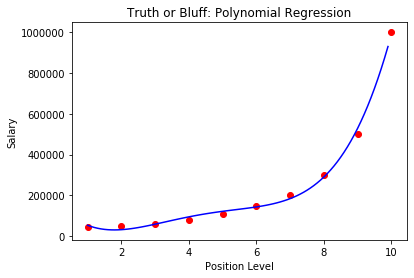

LR Prediction: [330378.78787879]
Poly LR Prediction X^4: [158862.45265153]


array([[1.0000000e+00, 6.5000000e+00, 4.2250000e+01, 2.7462500e+02,
        1.7850625e+03]])

In [55]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Position_Salaries.csv")
X = data.iloc[:,1:-1].values # still need : for 2D. X must always be 2D.
Y = data.iloc[:,-1].values

### 3. Modelling

# Simple Linear Regression (for testing)
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X,Y)

# Polynomial Linear Regression
from sklearn.preprocessing import PolynomialFeatures # to create polynomial Xs
poly_reg = PolynomialFeatures(degree = 2) # max is X^2
X_poly = poly_reg.fit_transform(X)
lin_reg2 = LinearRegression()
lin_reg2.fit(X_poly, Y)

### 4. Visualisations

# Simple Linear Regression
plt.scatter(X,Y, color='red')
plt.plot(X,lin_reg.predict(X),color = 'blue')
plt.title("Truth or Bluff: Linear Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()
# red = real, blue = predicted. prediction is far-off.

# Polynomial Linear Regression
plt.scatter(X,Y, color='red')
plt.plot(X,lin_reg2.predict(X_poly),color = 'blue') # note which ones we using!
plt.title("Truth or Bluff: Polynomial Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Polynomial Linear Regression (when up to X^4)
poly_reg4 = PolynomialFeatures(degree=4)
X_poly4 = poly_reg4.fit_transform(X)
lin_reg4 = LinearRegression()
lin_reg4.fit(X_poly4,Y)

plt.scatter(X,Y, color='red')
plt.plot(X,lin_reg4.predict(X_poly4),color = 'blue') # note which ones we using!
plt.title("Truth or Bluff: Polynomial Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Smoother Curve for X^4 where position levels are continuous instead of just integers
X_grid = np.arange(min(X),max(X), 0.1)
X_grid = X_grid.reshape((len(X_grid),1))
plt.scatter(X,Y, color='red')
plt.plot(X_grid,lin_reg4.predict(poly_reg4.fit_transform(X_grid)),color = 'blue')
plt.title("Truth or Bluff: Polynomial Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

### 5. Predictions

print(f'LR Prediction: {lin_reg.predict([[6.5]])}')
print(f'Poly LR Prediction X^4: {lin_reg4.predict(poly_reg4.fit_transform([[6.5]]))}')
poly_reg4.fit_transform([[6.5]])

# Chapter 5 - Support Vector Regression SVR
<div>&nbsp;</div>
<div>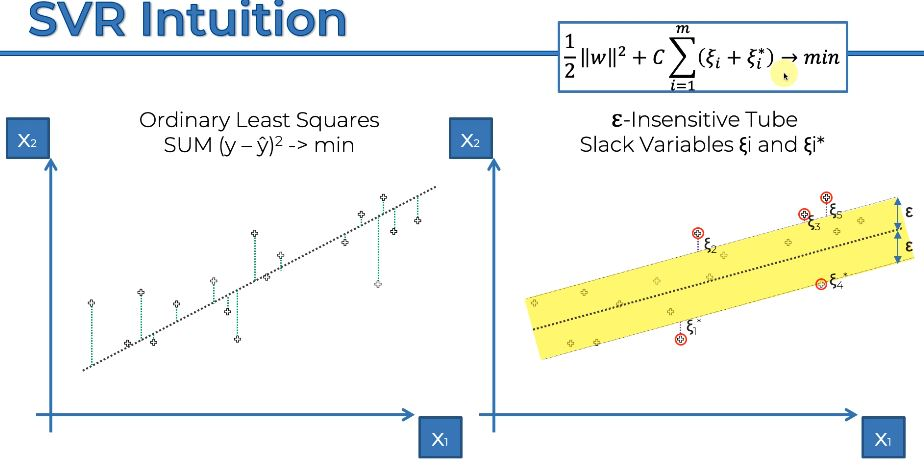</div>

*This is just a simple LINEAR SVR model. There are other types to be covered later.*

Instead of just a single line, there is a **tube** with a **width of epsilon** measured vertically. It is called the **epsilon-insensitive tube**, which means that any points in the dataset that fall inside the tube will not be disregarding the error. Think of it as allowing a margin of error, and any data point inside it we will consider it as not having any error. Hence, it gives some sort of buffer to the model. 

For the data points outside the tube, their error is their distance from the tube - ε* if below the tube and ε if above it.

The name **SVR** is because the outside data points are **support vectors** that dictate how the tube is created. They are supporting the structure / formation of the tube.

#### Kernels

There are linear kernels that learn linear relationships, and nonlinear kernels (RBF radial basis) that learn nonlinear relationships. See [here](https://data-flair.training/blogs/svm-kernel-functions/). We will be using the RBF model which is the most popular version.

#### Application

- We have to apply feature scaling. SVR model has no explicit equation of Y wrt Xs. There are not those coefficients multiplying each X and therefore no compensation of lower values for features that take high values. In fact, the SVR model has an implicit equation of Y and Xs where there are no such coefficients around.
- AKA if there is only an implicit equation btw Y and Xs, then probably need features scaling.
- We also feature scale Y here. Previously we didn't do it because it was just 0 and 1. Furthermore, **explicit equations have parameters that will take care of the high feature values by reducing their value**. Now we do it here because **Y is extremely high compared to X** AND **it is an implicit equation**. 
- Feature scaling is done separately on X and Y because they are separate datasets. Unless you merge and do it, then unmerge.

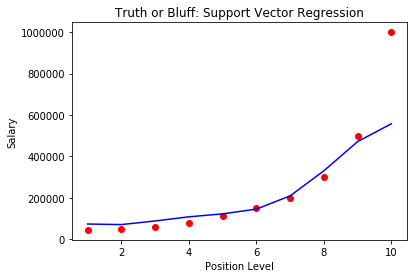

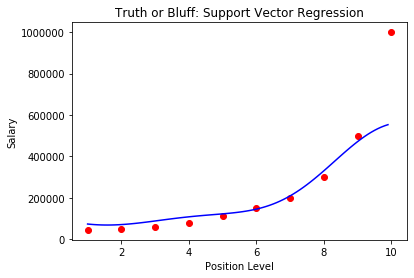

In [38]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Position_Salaries.csv")
X = data.iloc[:,1:-1].values # still need : for 2D. X must always be 2D.
Y = data.iloc[:,-1].values 
Y = Y.reshape(len(Y),1) # Y must be 2D to do feature scaling

### 3. Feature Scaling

from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
X = sc_X.fit_transform(X)
sc_Y = StandardScaler()
Y = sc_Y.fit_transform(Y)

### 4. Modelling

from sklearn.svm import SVR
regressor = SVR(kernel = 'rbf') # there are many types of SVR kernels
regressor.fit(X,Y.ravel()) # ravel() turns it into a 1D array

## 5. Predictions (inverse scaling)
regressor.predict([[6.5]]) # this is WRONG! cos you must first scale it to what X were
y_predicted = regressor.predict(sc_X.transform([[6.5]])) # this is right
sc_Y.inverse_transform(y_predicted)

### 6. Visualisation

plt.scatter(sc_X.inverse_transform(X),sc_Y.inverse_transform(Y), color='red')
plt.plot(sc_X.inverse_transform(X),sc_Y.inverse_transform(regressor.predict(X)),color = 'blue') # note which ones we using!
plt.title("Truth or Bluff: Support Vector Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Smoother Curve
X_grid = np.arange(min(sc_X.inverse_transform(X)),max(sc_X.inverse_transform(X)), 0.1)
X_grid = X_grid.reshape((len(X_grid),1))
plt.scatter(sc_X.inverse_transform(X),sc_Y.inverse_transform(Y), color='red')
plt.plot(X_grid,sc_Y.inverse_transform(regressor.predict(sc_X.transform(X_grid))),color = 'blue')
plt.title("Truth or Bluff: Support Vector Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Chapter 6 - Decision Tree Regression
<div>&nbsp;</div>
<div>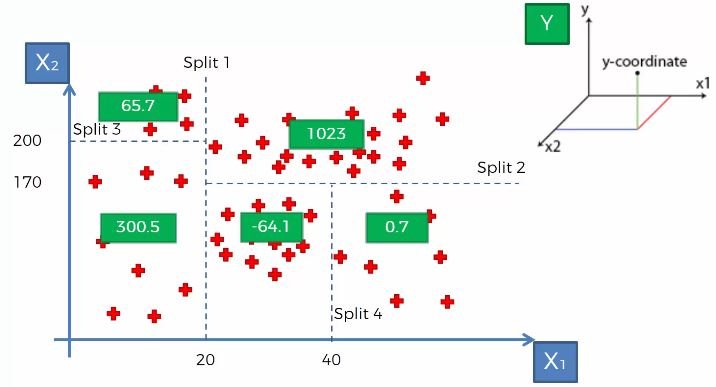</div>
<div>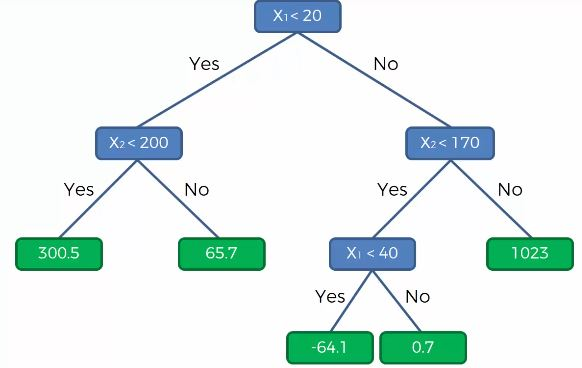</div>

Ignoring Y, we will first create a scatterplot based on the Xs. We will then slowly split the dataset based on **information entropy** (math not covered here). Each split is only for the dataset it covers, ie Split 4 is only splitting dataset that is for X2 < 170. The splits will keep on carrying on until a terminal leaf hits some yardstick (eg each terminal leaf must have at least 5% of total population) and then the splits will stop.

To predict a new value, we will take its X values and insert it into a terminal leaf. Its Y-value will then be the average of that leaf node's Y-value.

**Note:** No need feature scaling because there are no equations we are working here, just splits. Still works with original scaling of features.

**Note 2:** Decision trees are better for models with many features. With just one feature, it doesn't do as well.

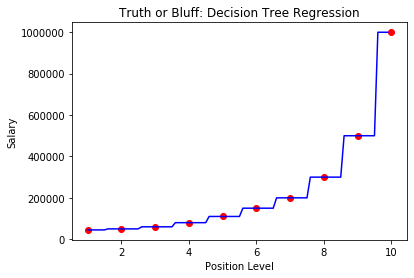

In [17]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Position_Salaries.csv")
X = data.iloc[:,1:-1].values # still need : for 2D. X must always be 2D.
Y = data.iloc[:,-1].values 

### 3. Modelling

from sklearn.tree import DecisionTreeRegressor # to predict a continuous value
regressor = DecisionTreeRegressor(random_state=0) # set seed
regressor.fit(X,Y)

### 4. Predictions

regressor.predict([[6.5]])

### 5. Visualisation

X_grid = np.arange(min(X),max(X),0.1)
X_grid = X_grid.reshape(len(X_grid),1)
plt.scatter(X,Y,color='red')
plt.plot(X_grid,regressor.predict(X_grid),color='blue')
plt.title("Truth or Bluff: Decision Tree Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Chapter 7 - Random Forest

RF is a version of **ensemble learning**. There are many other versions of ensemble learning such as gradient boosting etc. Ensemble learning is when you take multiple algorithms OR the same algorithm multiple times and you put them together to make something much more powerful than the original.

- Step 1: Pick randomly K data points from the train set.
- Step 2: Build the decision tree associated to these K data points.
- Step 3: Choose Ntree, the number of trees you want to build. Repeat Steps 1 and 2. Hence you build a lot of regression decision trees.
- Step 4: For a new data point, make each one of your Ntree trees predict the value of Y, and assign the new data point the average of all the predicted Y values.

This improves the accuracy of the prediction as you are taking the average of many predictions. Also it is more stable, as any changes in your data set could normally impact one tree but less so on an entire forest.

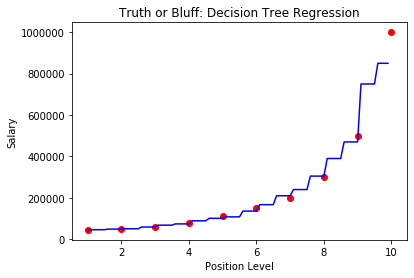

In [21]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Position_Salaries.csv")
X = data.iloc[:,1:-1].values # still need : for 2D. X must always be 2D.
Y = data.iloc[:,-1].values 

### 3. Modelling

from sklearn.ensemble import RandomForestRegressor
regressor = RandomForestRegressor(n_estimators = 10, random_state=0) # must specify no. of trees
regressor.fit(X,Y)

### 4. Predictions

regressor.predict([[6.5]])

### 5. Visualisation

X_grid = np.arange(min(X),max(X),0.1)
X_grid = X_grid.reshape(len(X_grid),1)
plt.scatter(X,Y,color='red')
plt.plot(X_grid,regressor.predict(X_grid),color='blue')
plt.title("Truth or Bluff: Decision Tree Regression")
plt.xlabel("Position Level")
plt.ylabel("Salary")
plt.show()

# Regression: Summary Thus Far

In [53]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/02 Regression/Data.csv")
X = data.iloc[:,:-1].values
y = data.iloc[:,-1].values 

In [37]:
##### Multiple Linear Regression #####

### 3. Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### 4. Modelling
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

### 5. Predictions
y_pred = regressor.predict(X_test)
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1)[:10]) # just print first 10 rows

### 6. Evaluation
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

[[2.25 2.  ]
 [2.03 2.  ]
 [3.52 4.  ]
 [3.7  4.  ]
 [1.89 2.  ]
 [2.09 2.  ]
 [2.26 2.  ]
 [3.94 4.  ]
 [2.07 2.  ]
 [1.94 2.  ]]


0.8354489501242135

In [39]:
##### Polynomial Linear Regression #####

### 3. Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### 4. Modelling
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
poly_reg = PolynomialFeatures(degree = 4)
X_poly = poly_reg.fit_transform(X_train)
regressor = LinearRegression()
regressor.fit(X_poly, y_train)

### 5. Predictions
y_pred = regressor.predict(poly_reg.transform(X_test))
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1)[:10])

### 6. Evaluation
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

[[2.4  2.  ]
 [2.   2.  ]
 [3.68 4.  ]
 [3.49 4.  ]
 [2.29 2.  ]
 [1.9  2.  ]
 [2.24 2.  ]
 [4.39 4.  ]
 [2.55 2.  ]
 [2.18 2.  ]]


0.6085482039668688

In [45]:
##### Support Vector Regression #####

### 2. Additional Reshape (because feature scaler takes in 2D)
y = y.reshape(len(y),1)

### 3. Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### 4. Feature Scaling
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
sc_y = StandardScaler()
X_train = sc_X.fit_transform(X_train)
y_train = sc_y.fit_transform(y_train)

### 5. Modelling
from sklearn.svm import SVR
regressor = SVR(kernel = 'rbf')
regressor.fit(X_train, y_train.ravel())

### 6. Predictions
y_pred = sc_y.inverse_transform(regressor.predict(sc_X.transform(X_test)))
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1)[:10])

### 7. Evaluation
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

[[2.1  2.  ]
 [1.91 2.  ]
 [3.97 4.  ]
 [3.98 4.  ]
 [2.01 2.  ]
 [1.94 2.  ]
 [1.97 2.  ]
 [4.05 4.  ]
 [2.11 2.  ]
 [2.04 2.  ]]


0.8671506597422487

In [47]:
##### Decision Tree Regression #####

### 3. Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### 4. Modelling
from sklearn.tree import DecisionTreeRegressor
regressor = DecisionTreeRegressor(random_state = 0)
regressor.fit(X_train, y_train)

### 5. Predictions
y_pred = regressor.predict(X_test)
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1)[:10])

### 6. Evaluation
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

[[2. 2.]
 [2. 2.]
 [4. 4.]
 [4. 4.]
 [2. 2.]
 [2. 2.]
 [2. 2.]
 [2. 4.]
 [2. 2.]
 [2. 2.]]


0.6535632183908047

In [54]:
##### Random Forest #####

### 3. Train Test Split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### 4. Modelling
from sklearn.ensemble import RandomForestRegressor
regressor = RandomForestRegressor(n_estimators = 10, random_state = 0)
regressor.fit(X_train, y_train)

### 5. Predictions
y_pred = regressor.predict(X_test)
np.set_printoptions(precision=2)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1)[:10])

### 6. Evaluation
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

[[2.  2. ]
 [2.  2. ]
 [4.  4. ]
 [4.  4. ]
 [2.  2. ]
 [2.  2. ]
 [2.4 2. ]
 [3.8 4. ]
 [2.  2. ]
 [2.  2. ]]


0.8447333333333333

# Chapter 8 - Logistic Regression

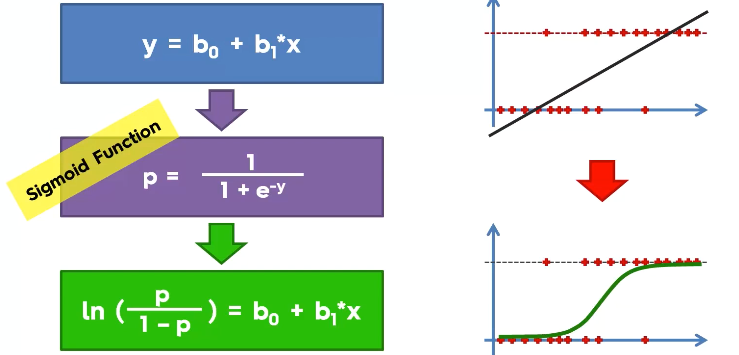

For logistic regression, **feature scaling is not compulsory but it improves results**.

[0]
[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[65  3]
 [ 8 24]] 0.89


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


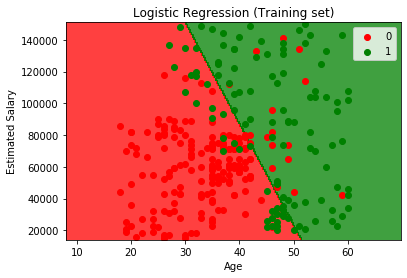

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


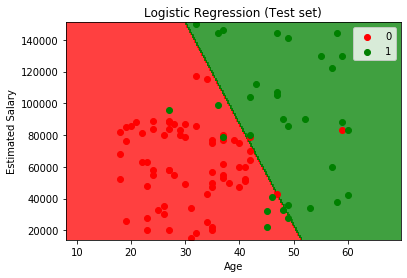

In [41]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state=0)
classifier.fit(X_train, Y_train) # smaller the C, stronger the regularisation, lesser the overfitting

### 4. Predictions

print(classifier.predict(sc.transform([[30,87000]])))

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 0.25),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 0.25))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Logistic Regression (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 0.25),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 0.25))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Logistic Regression (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 9 K-Nearest Neighbour KNN

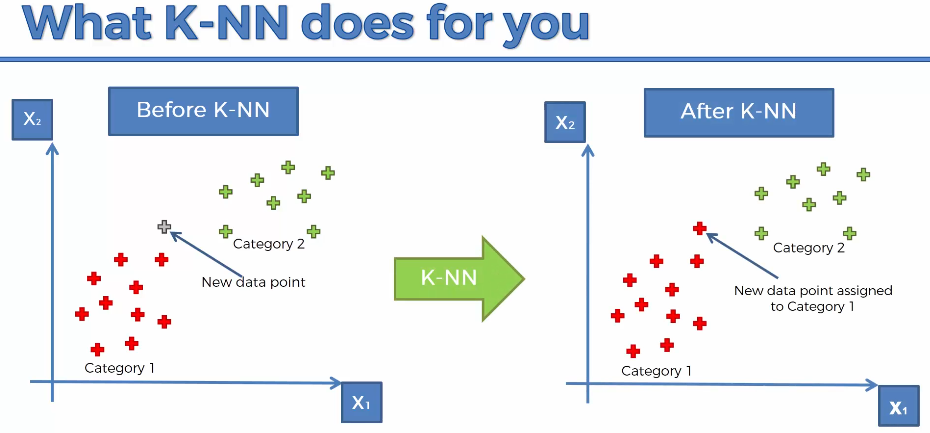

- Step 1: Choose the number K of neighbours. Common default K = 5.
- Step 2: Take the K nearest neighbours of the new data point based on Euclidean distance.
- Step 3: Among these K neighbours, count the number of data points in each category.
- Step 4: Assign the new data point to the category with the most neighbours.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[64  4]
 [ 3 29]] 0.93


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


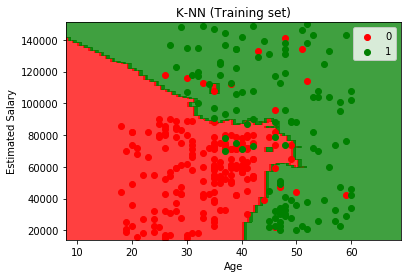

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


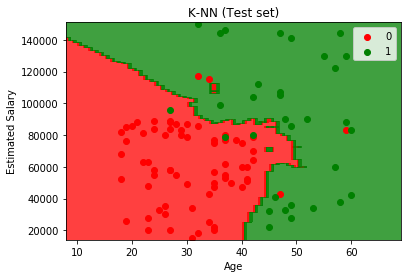

In [47]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.neighbors import KNeighborsClassifier
classifier = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2) # minkowski and p=2 means use euclidean dist
classifier.fit(X_train, Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('K-NN (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('K-NN (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 10 - Support Vector Machine SVM

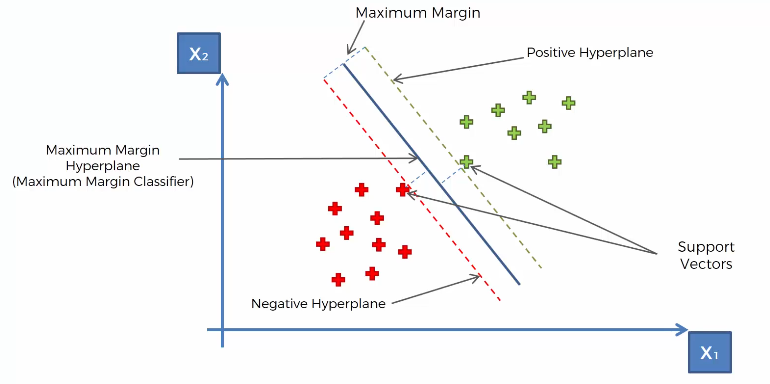
Basically it's drawing a line that separates groups, and the distance is at a **maximum margin**. Both **support vector** points are equidistant from the line. Only those two points contribute to / support the entire algorithm; the rest of the points do nothing at all.

Points are called vectors because if not in 2D space anymore, hard to visualise. In such a multidimensional space, they are called vectors.

The line is also called the **maximum margin hyperplane / maximum margin classifier**. Then arbitrarily, one line is the positive hyperplane and the other is negative hyperplane; whatever is left of the negative hyperplane is the negative category, vice versa.

The SVM is popular in the sense that it uses extreme data points that are close to each other as the support vectors. These data points are very similar, ie an oranged-color apple vs a green-colored orange. This is very different from the other ML algorithms and that is why sometimes it performs better than the others.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[66  2]
 [ 8 24]] 0.9


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


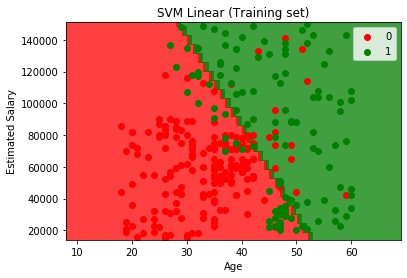

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


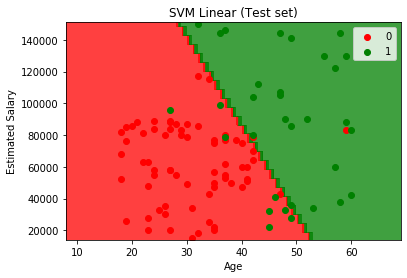

In [51]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.svm import SVC
classifier = SVC(kernel='linear', random_state=0) # trying out a linear kernel
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('SVM Linear (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('SVM Linear (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 11 - Kernel SVM

Sometimes, linear SVM does not work because the data is **not linearly separable**.

<div>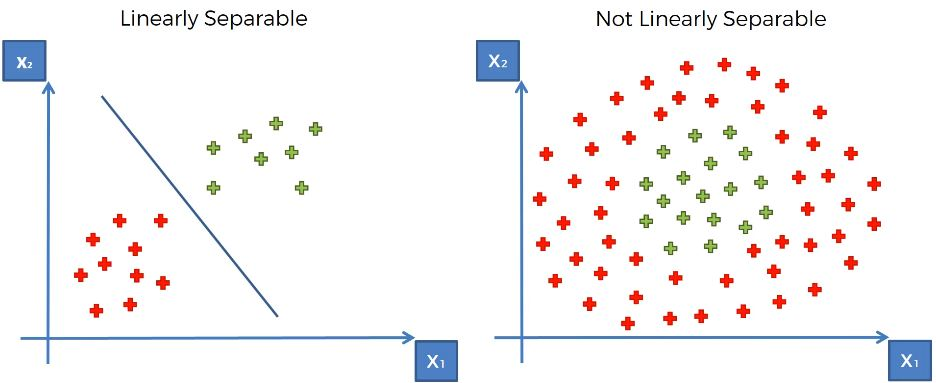</div>

There are several ways to go about this.

### Mapping into a Higher-Dimensional Space

Doing so will map the nonlinear dataset and turn it into a linearly separable dataset. For an original 2D dataset, it will have a new dimension Z, with a hyperplane between it. After that, we project it back into 2D, and that hyperplane would become a circle.

The disadvantage is that mapping into a higher dimensional space is highly compute-intensive, which is why it's not a good strategy for big data.
<div>&nbsp;</div>
<div>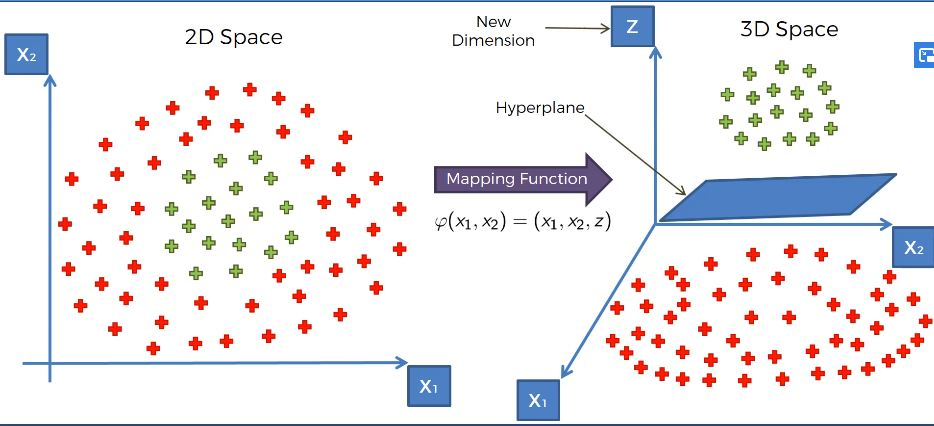</div>
<div>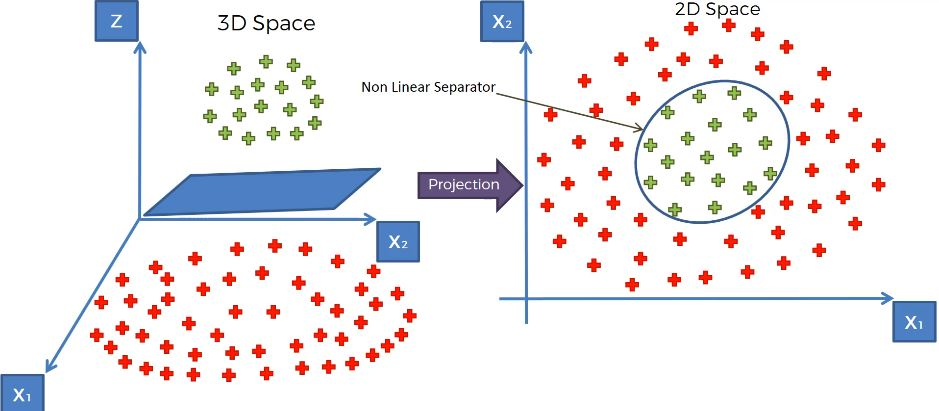</div>

### The Kernel Trick
<div>&nbsp;</div>
<div>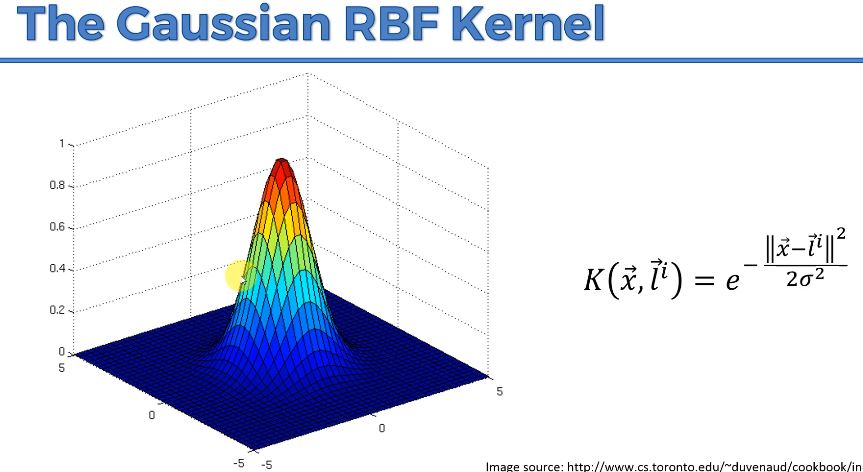</div>
<div>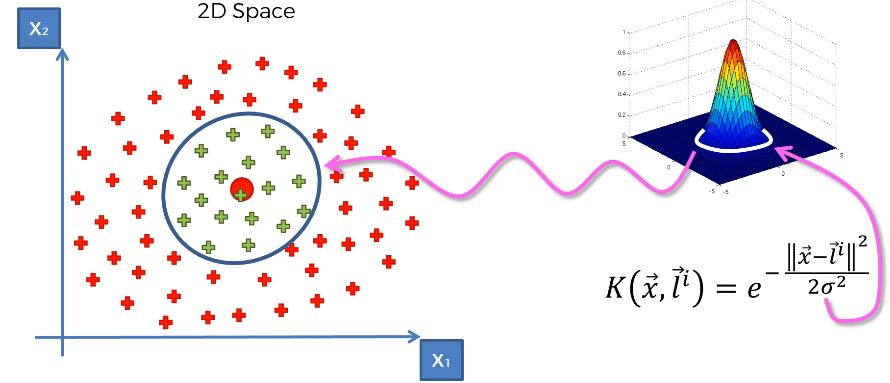</div>
<div>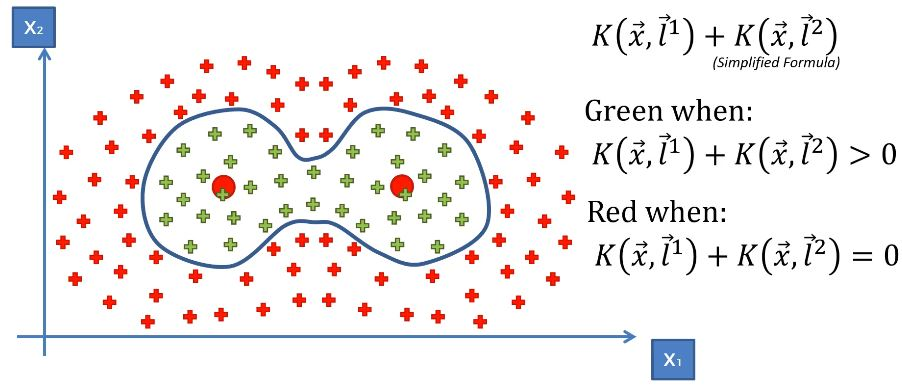</div>

The K equation is called the **kernel function**. l is landmark. It is in the middle of the 2D space. x is any other point on that 2D space. Any vertical is the result of the equation. The top part of the equation basically means "distance from x to the landmark, squared". Sigma is some fixed parameter. If you think about it, e^0=1 which is why it's the peak, and e^-inf=0.

The optimal landmark is not necessarily the center, and it is found via some algorithm. The base of the cone (the circumference) is then projected onto the 2D dataset: anything in the circumference is assigned a value above 0 while the rest are close to 0. The sigma's role is to define how wide the circumference is: the higher it is, the larger is the circle.

Hence the kernel function allows you to separate the points by adjusting the function itself, and sigma. All of this without going into a higher dimensional space. You can even make even more complex equations which do not interfere with each other.

### Types of Kernel Functions

<div>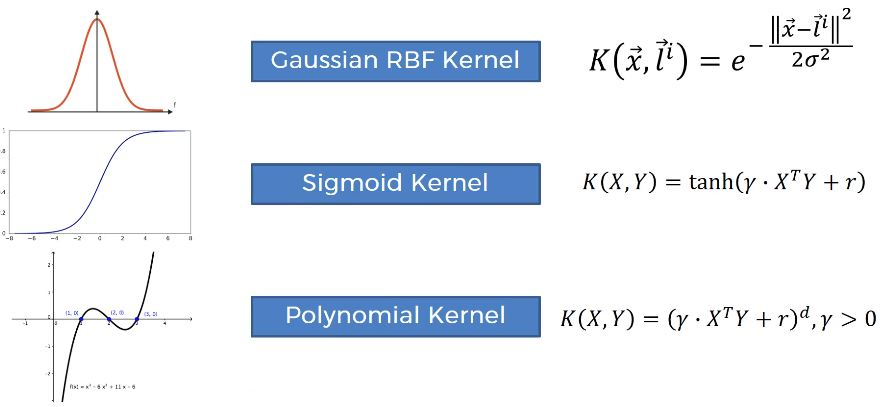</div>

- Gaussian RBF Kernel: for when data in the middle are different.
- Sigmoid Kernel: for when data on the right side are different.
- Polynomial Kernel: lol
- Read more [here](https://thatcher.dev/MLKernels.jl/dev/) and [here](https://github.com/trthatcher/MLKernels.jl).

### Showcase

<div>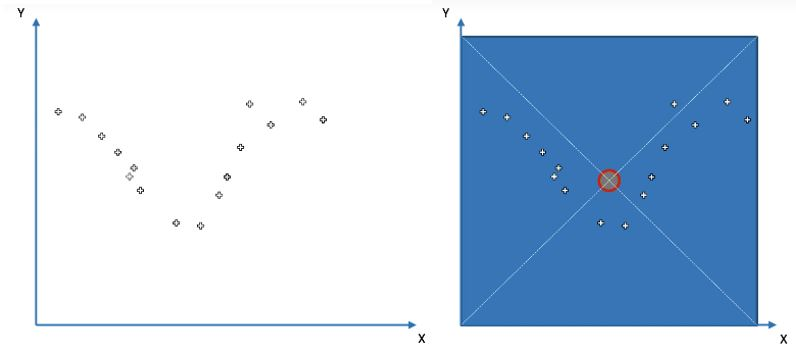</div>
We got the above and want to use SVR. But a linear SVR doesn't work. We can project into 3D and fit it with a kernel function.
<div>&nbsp;</div>
<div>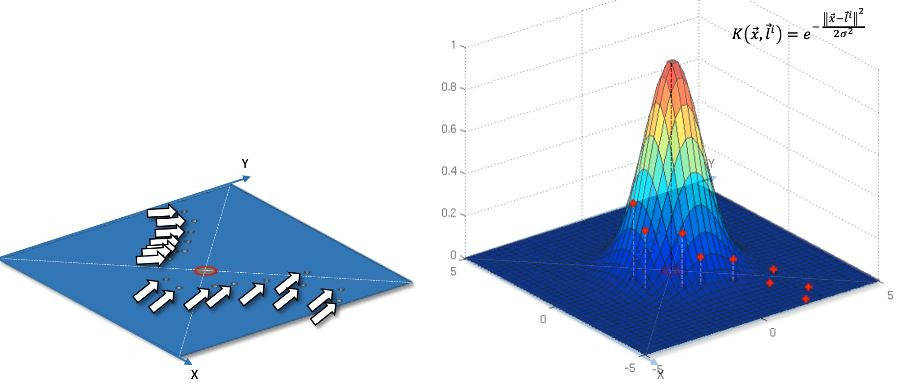</div>
<div>&nbsp;</div>
We set a hyperplane as per below.
<div>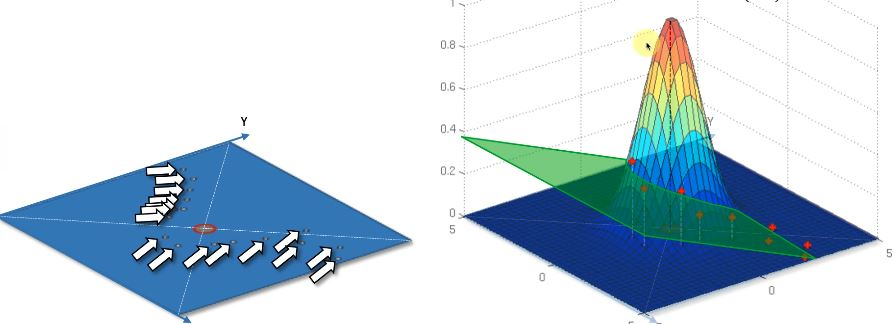</div>

<div>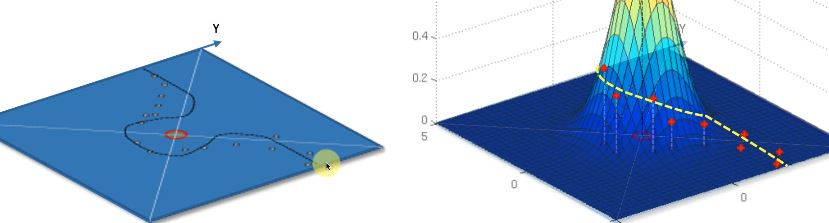</div>
<div>&nbsp;</div>
Then instead of an epsilon tube, we have an epsilon space. The intersections between the outer planes of the epsilon space and the kernel functions are the support vectors.
<div>&nbsp;</div>
<div>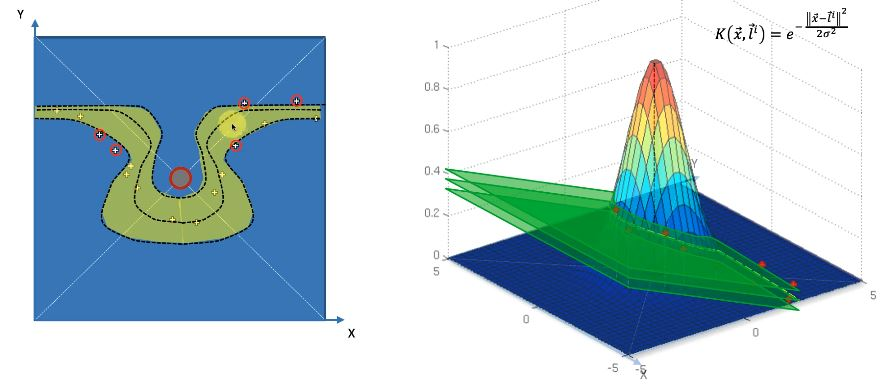</div>

**Note:** due to the kernel trick, you don't really map into a new dimension as the above pictures show. It's more for teaching value.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[64  4]
 [ 3 29]] 0.93


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


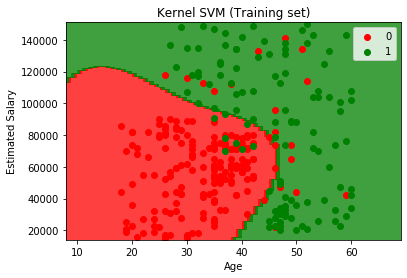

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


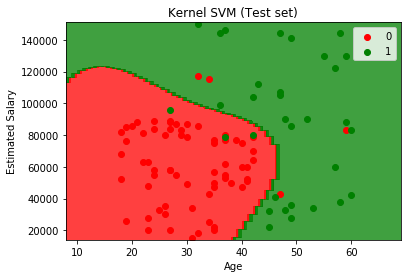

In [7]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.svm import SVC
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Kernel SVM (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Kernel SVM (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 12 - Bayes Theorem
<div>&nbsp;</div>
<div>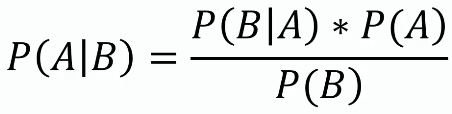</div>
<div>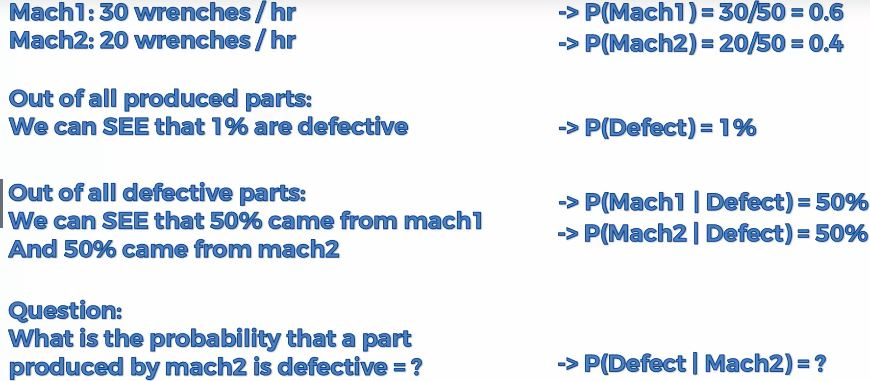</div>
<div>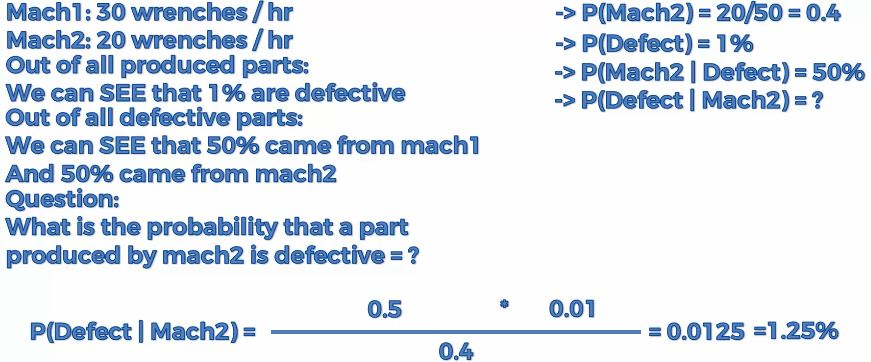</div>

### BT in Machine Learning
<div>&nbsp;</div>
<div>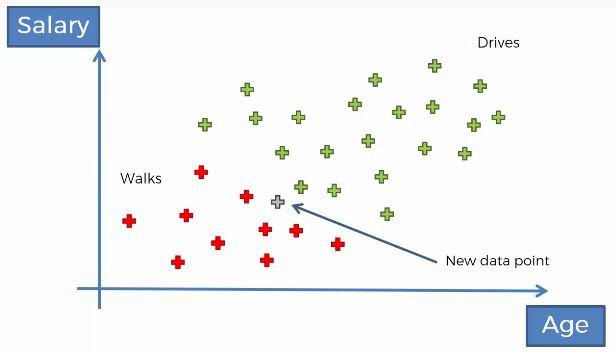</div>
<div>&nbsp;</div>
<div>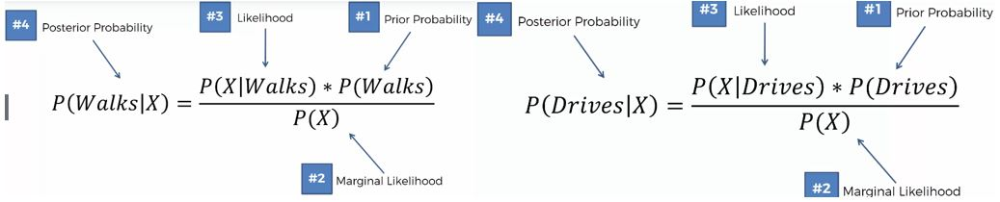</div>
<div>&nbsp;</div>
<div>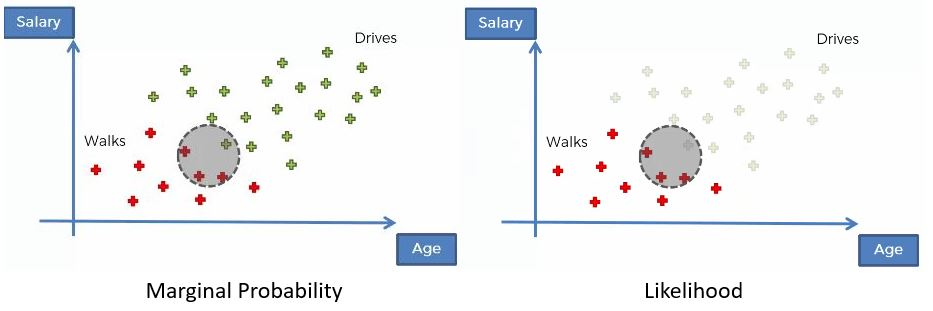</div>

For **marginal likelihood**, draw a circle (size depends on formula) where the new point would be. All points in that circle will be deemed similar to the new point. Hence, the no. of points in that circle out of total will be the marginal probability. AKA it is the probability of any new random variable being in that circle.

For **likelihood**, it is similar. Look at the circle again. You are asking what is the probability that the new point belongs to one of the classes. In the example, P(X|Walks) means we ignore all Drives, then count no. of red dots out of all the red dots only.

In the end, choose the one with the higher percentage.

### Extra Notes

- **Why "Naive"?** Because it uses Bayes' Theorem which has its own assumptions, and these assumptions are naive. For eg, it assumes features are independent, which is extremely hard in the real world (eg "age" and "salary" probably quite interlinked).

- Calculating marginal likelihood P(X) is not *necessary* when comparing two features. Because both denominators are P(X) so essentially it is just comparing the top. However when there are more features, this cannot apply.

- The above also applies if only 2 classes. If you calculate one, you know the other. But if > 2, need to calculate all.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[65  3]
 [ 7 25]] 0.9


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


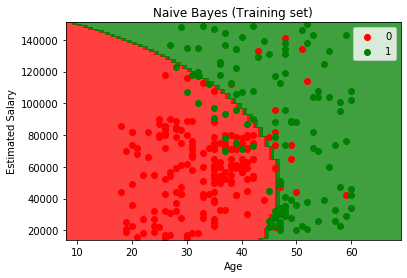

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


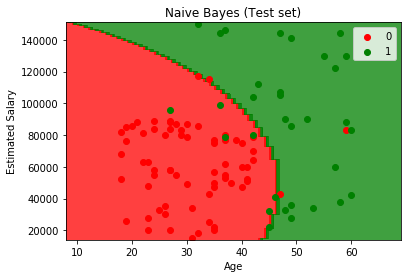

In [6]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.naive_bayes import GaussianNB
classifier = GaussianNB() # we use the Gaussian NB one
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Naive Bayes (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Naive Bayes (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 13 - Decision Trees (CART)
<div>&nbsp;</div>
<div>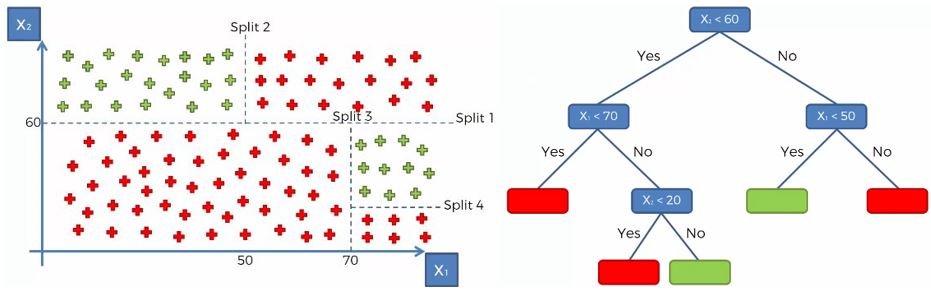</div>

Splits are made at points that best minimises information entropy. 

Decision trees are not as popular now and instead have been overtaken by Random Forest, Gradient Boosting etc.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[62  6]
 [ 3 29]] 0.91


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


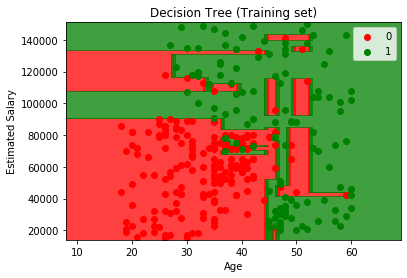

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


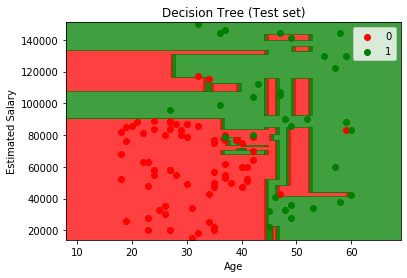

In [5]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier(criterion='entropy', random_state=0) # information gain; can be Gini
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Decision Tree (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Decision Tree (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Chapter 14 - Random Forest

**Ensemble learning** is when you use many ML algorithms and put them together to create one bigger ML algorithm. RF uses this by combining many smaller trees into one forest.

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[64  4]
 [ 2 30]] 0.94


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


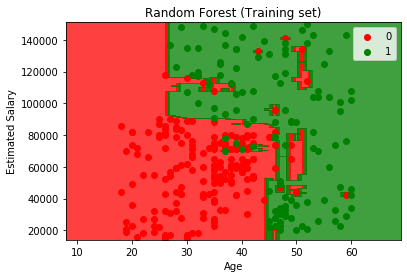

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


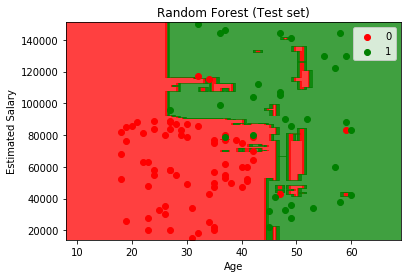

In [12]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.ensemble import RandomForestClassifier
classifier = RandomForestClassifier(n_estimators=40, criterion='gini', random_state=0)
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_train), Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Random Forest (Training set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = sc.inverse_transform(X_test), Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                     np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
plt.contourf(X1, X2, classifier.predict(sc.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green'))(i), label = j)
plt.title('Random Forest (Test set)')
plt.xlabel('Age')
plt.ylabel('Estimated Salary')
plt.legend()
plt.show()

# Classification: Further Notes

## Accuracy Paradox
<div>&nbsp;</div>
<div>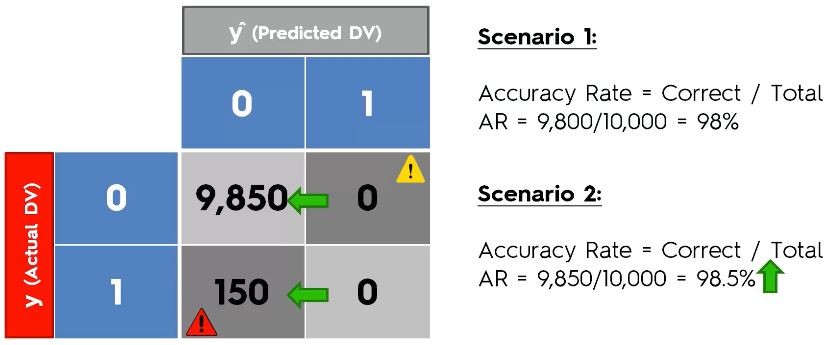</div>
<div>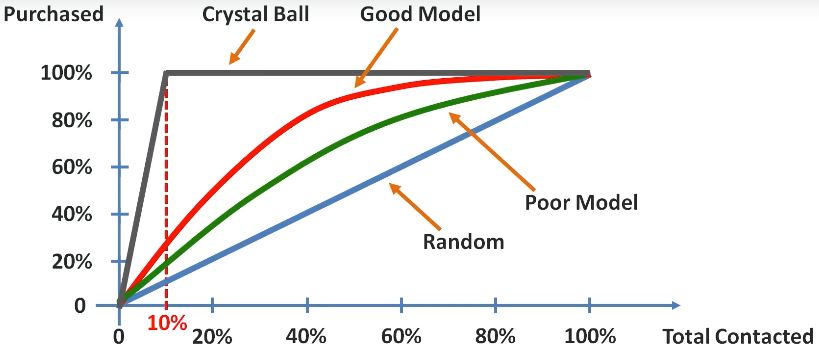</div>

Accuracy is not a good enough parameter on its own. Use the **cumulative accuracy profile (CAP)** to help analyse. The bigger the gap between the blue and red line, the better.

The red line is basically at first aiming all the confirm people first. That is why huge growth.

Note that the CAP curve =/= the ROC curve (receiver operating characteristic). Many people see similar then think they are similar.
<div>&nbsp;</div>
<div>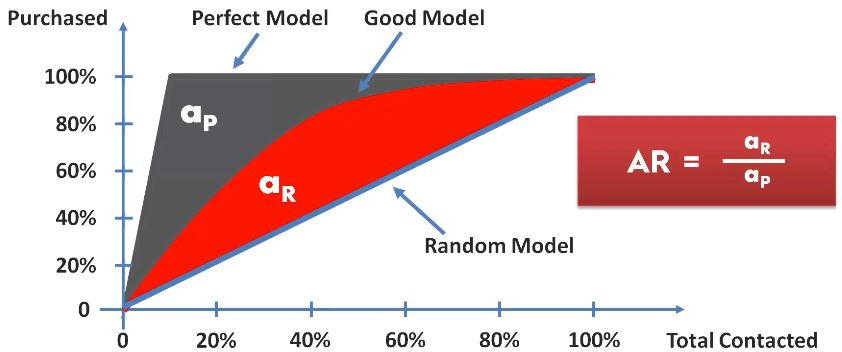</div>

To calculate the accuracy ratio, you take the area under the perfect model (everything until the blue line) divided by the area under the red model. The number will be between 0 and 1. The closer to 1, the better. However, while the method is calculable using statistical tools, it is hard to quantify by looking at it visually.

<div>&nbsp;</div>
<div>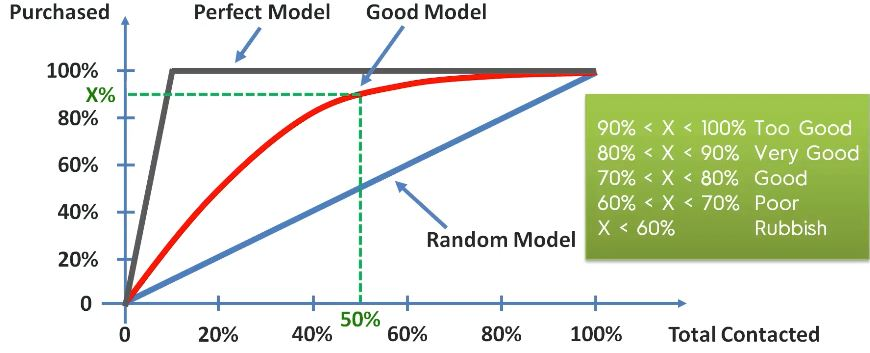</div>

This is the other method. Count from 50%. But note that if "too good", there may be overfitting, or **forward looking variables**.

### Which Model?

<div>&nbsp;</div>
<div>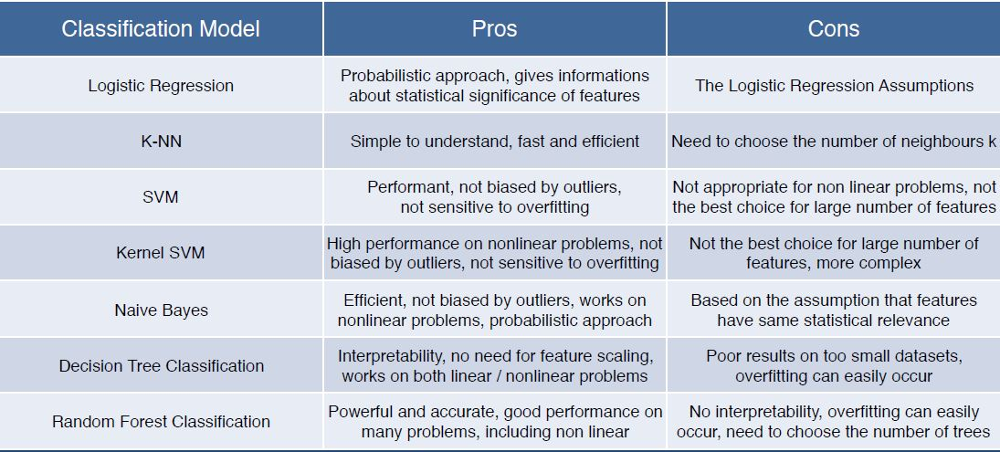</div>

- If linear, use logistic or SVM.
- If nonlinear, use KNN, NB, decision tree, or RF.

From a business POV:

- If you want to rank probabilities that your customer will buy, use logistic (linear) or NB (nonlinear) as they can provide probabilities.
- Segmentations of customers can use SVM.
- DT for clear interpretation of model results.
- RF for high performance model but less on interpretation.

# Chapter 14 - K Means Clustering
<div>&nbsp;</div>
<div>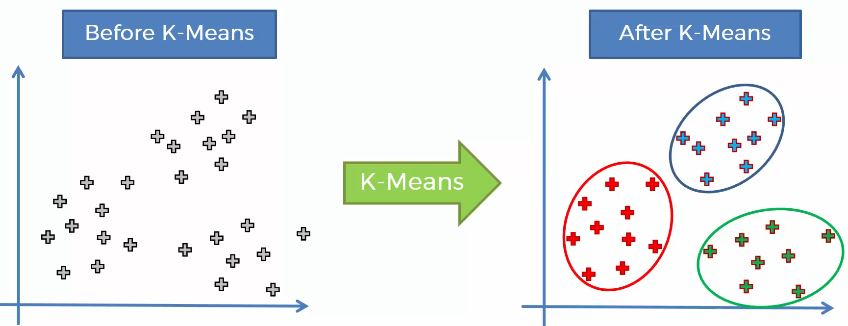</div>

Clustering is different from classification because you don't know what you are looking for - you are simply segmenting them.

- Step 1: Choose K number of clusters
- Step 2: Select random K points as centroids (no need to be from dataset)
- Step 3: Assign each data point to the closest centroid
- Step 4: Compute and place the new centroid of each cluster
- Step 5: Repeat from step 3 until no more reassignment

Note for step 3: can use the **perpendicular distance hack**, where you draw a line between two centroids and draw a perpendiccular line at its center. Anything on its side is closer to it.

<div>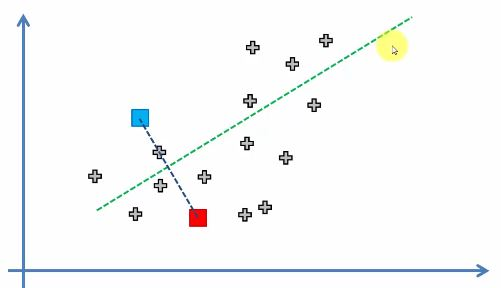</div>

Note that there is **NO** train test split because no Y!

### Problems

<div>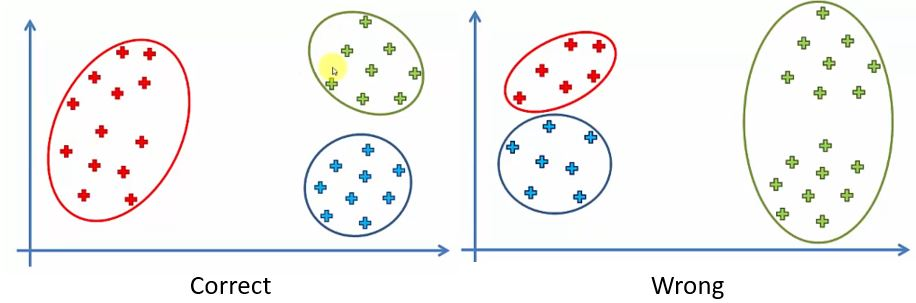</div>

The **random initialisation trap** where it will lead to wrong clusters formed. The solution is the **K-Means++ algorithm**.
<div>&nbsp;</div>
<div>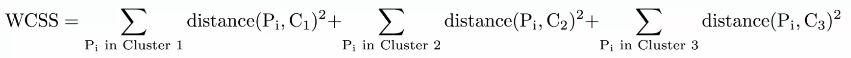</div>
<div>&nbsp;</div>
<div>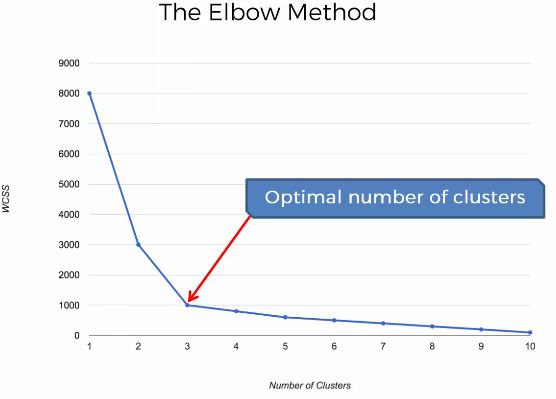</div>

Furthermore, how to choose the correct number of clusters? We use the **within cluster sum of squares (WCSS)**. It may look complicated, but actually each part is just summing the square of distance difference from the centroid for each data point, aka distance btw point and centroid + squared + sum all these. Then compare WCSS when calculated for 1 cluster, for 2, for 3 etc. When every single point is its own centroid, then WCSS = 0. Plot the WCSS, and the graph will be like an elbow, ie **the elbow method**. Choose arbitrarily the one that you think is optimal.

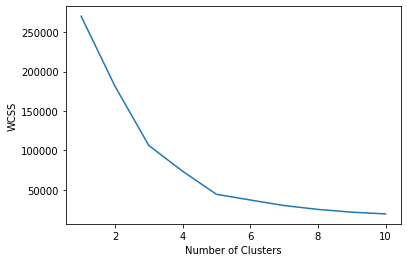

[3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3 0 3
 0 3 0 3 0 3 1 3 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 2 4 2 1 2 4 2 4 2 1 2 4 2 4 2 4 2 4 2 1 2 4 2 4 2
 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2 4
 2 4 2 4 2 4 2 4 2 4 2 4 2 4 2]


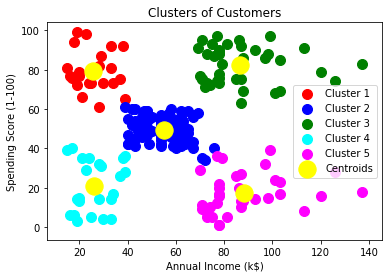

In [11]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Mall_Customers.csv")
X = data.iloc[:,1:].values # correct version actually
X = data.iloc[:,[3,4]].values # for vosualisation so only 2D 2 features :(

### 3. Modelling

# Elbow Method
from sklearn.cluster import KMeans
wcss = [] # stores all the wcss results
for i in range(1,11): # do 10 times
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42) # 42 is an arbitrary no.
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1,11), wcss) # x-axis is times, y-axis is wcss
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Actual
kmeans = KMeans(n_clusters=5, init='k-means++', random_state=42) # 42 is an arbitrary no.
y_kmeans = kmeans.fit_predict(X) # train AND predict
print(y_kmeans)

### 4. Visualisation

# plt.scatter(X[:,0]) # x-axis is annual income, choose all rows, only 0th column; y-axis is spending, choose all rows, 1th column
plt.scatter(X[y_kmeans==0,0], X[y_kmeans==0,1], s=100, c='red', label='Cluster 1') # xaxis for all rows of cluster 0, give me the annual income; same for yaxis; size = 100
plt.scatter(X[y_kmeans==1,0], X[y_kmeans==1,1], s=100, c='blue', label='Cluster 2')
plt.scatter(X[y_kmeans==2,0], X[y_kmeans==2,1], s=100, c='green', label='Cluster 3')
plt.scatter(X[y_kmeans==3,0], X[y_kmeans==3,1], s=100, c='cyan', label='Cluster 4')
plt.scatter(X[y_kmeans==4,0], X[y_kmeans==4,1], s=100, c='magenta', label='Cluster 5')
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], s=300, c='yellow', label='Centroids') # plotting the centroids. clustercenters attribute is 2D array of their coordinates
plt.title('Clusters of Customers')
plt.xlabel('Annual Income (k$)')
plt.ylabel('Spending Score (1-100)')
plt.legend()
plt.show()

# Chapter 15 - Hierarchical Clustering

HC is like K-Means, just that they use different methods to get the final results. There are 2 types: **agglomerative (bottom-up approach) and divisive (top-down approach)**. We will focus more on the agglomerative approach, while divisive is the same but reversed.

- Step 1: Make each data point a single-point cluster.
- Step 2: Take the two closest clusters and make them one cluster.
- Step 3: Repeat until there is 1 huge cluster left.

Take note that "distance between two clusters" can be any of the below. Each can impact your output differently:
- Closest points
- Furthest points
- Average distance (average of every distance between each point and the next)
- Distance between centroids

<div>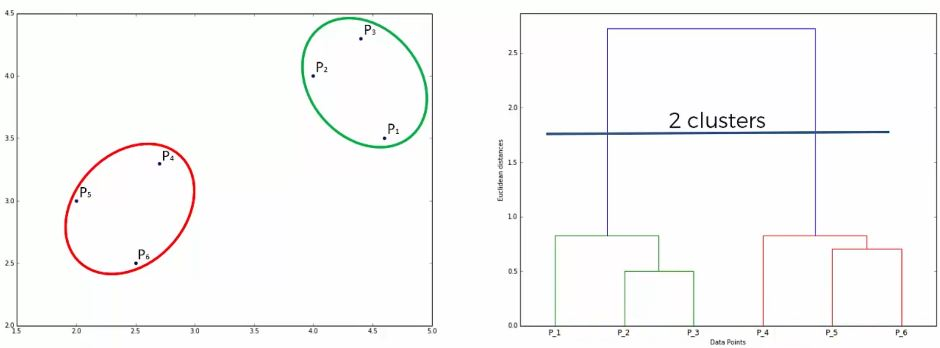</div>

After you do all the steps, the algorithm memorises the process of what we did and stores it in a **dendrogram**. The height you see is the Euclidean distance between the points; the distance between each cluster is measured by **dissimilarity**, the more dissimilar the higher the height. Then set a dissimilarity level, and cut off at there.

One method people use is to extend all horizontal lines, then choose any vertical line that has no horizontal lines crossing it. Choose the longest one. It means it is the largest distance, and so the resulting cluster would be closer to each other.

HC performs poorer than KM on large datasets. Furthermore, we use **within-cluster variance** to get clusters and create dendrograms.
<div>&nbsp;</div>
<div>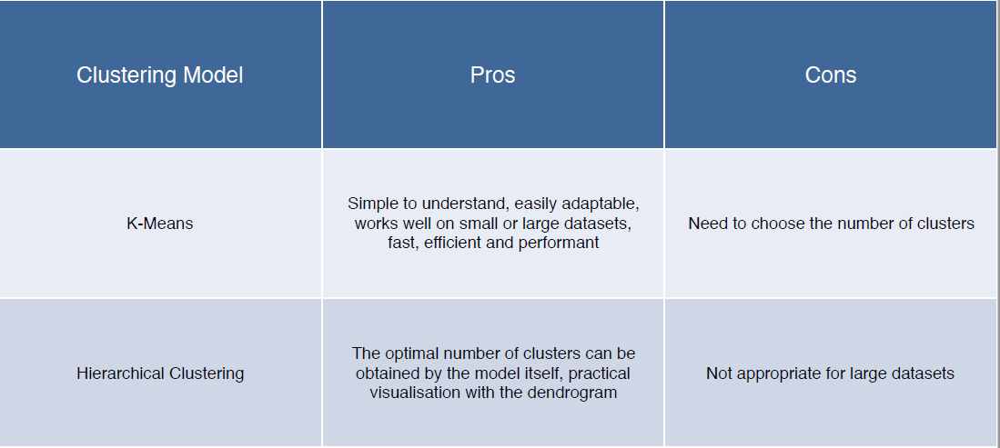</div>

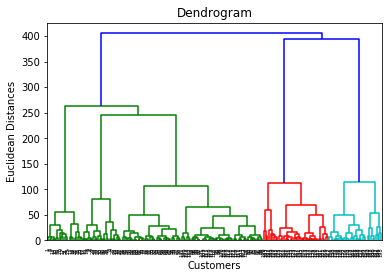

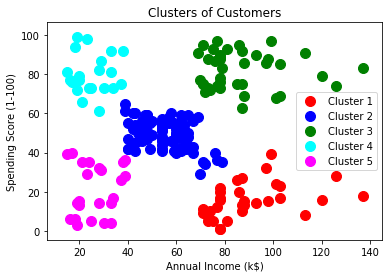

In [16]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Mall_Customers.csv")
X = data.iloc[:,1:].values # correct version actually
X = data.iloc[:,[3,4]].values # for vosualisation so only 2D 2 features :(

### 3. Modelling

# Dendrogram
import scipy.cluster.hierarchy as sch
dendrogram = sch.dendrogram(sch.linkage(X, method='ward')) # linkage(matrix, clustermethod). we use method of minimum variance, where within each cluster has the least variance; recommended method called ward.
plt.title('Dendrogram')
plt.xlabel('Customers') # becos each point on the xaxis is each data point! and yaxis will be the euclidean dist.
plt.ylabel('Euclidean Distances')
plt.show()

# Actual
from sklearn.cluster import AgglomerativeClustering
hc = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward') # affinity is about the distance computed to measure the variance within clusters; linkage is method
y_hc = hc.fit_predict(X)

### 4. Visualisation

plt.scatter(X[y_hc==0,0], X[y_hc==0,1], s=100, c='red', label='Cluster 1')
plt.scatter(X[y_hc==1,0], X[y_hc==1,1], s=100, c='blue', label='Cluster 2')
plt.scatter(X[y_hc==2,0], X[y_hc==2,1], s=100, c='green', label='Cluster 3')
plt.scatter(X[y_hc==3,0], X[y_hc==3,1], s=100, c='cyan', label='Cluster 4')
plt.scatter(X[y_hc==4,0], X[y_hc==4,1], s=100, c='magenta', label='Cluster 5')
plt.title('Clusters of Customers')
plt.xlabel('Annual Income (k$)')
plt.ylabel('Spending Score (1-100)')
plt.legend()
plt.show()

### 5. Evaluation

# Cluster 1: high income yet low spending. target them and incentivise them to spend.
# Cluster 2: up to you
# Cluster 3: target the most since high income and high purchase
# Cluster 4: if you wanna be socially responsible since poor but spend so much, then dont target
# Cluster 5: low salary and low spending. don't target.

# Association Rule Learning
# Chapter 16 - Apriori

An analytics team found that between 6-9pm, people who buy diapers also buy beer.

There are 3 parts of **apriori**: **support, confidence, and lift**. Imagine if total is 100 people.

<div>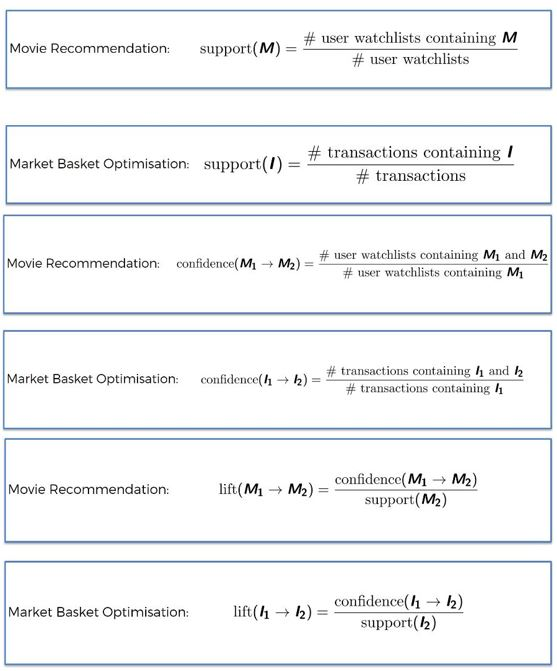</div>

**Support** means if 10 people out of 100 watched Movie B, then it is 10% (support can apply to multiple products also and the number tells you how many transactions contain all these pdts). **Confidence** is given that 40 people have watched Movie A and 7 out of those 40 have watched BOTH Movie A and Movie B, then it is 7/40 = 17.5%. 

**Lift** is confidence divided by support = 17.5% / 10% = 1.75. Lift means if we randomly ask a different population, what is the likelihood that these new people would like Product B given that they liked Product A. So in a sense, lift is like an improvement - earlier it was just 10%, but now since you know they liked Product A, you think they will like Product B too, and yes your chances of success are now at 17.5%. In essence, **lift measures the strength of your rule**.

- Step 1: Set a minimum support and confidence (eg there are just too many recommendations, so set a yardstick, and do not look at those with support less than 20% etc.)
- Step 2: Take all the subsets in transactions having higher support than minimum support
- Step 3: Take all the rules of these subsets having higher confidence than minimum confidence
- Step 4: Sort the rules by decreasing lift (aka strongest rule on top)

Interpretation:

    [RelationRecord(items=frozenset({'chicken', 'light cream'}), support=0.004532728969470737, ordered_statistics=[OrderedStatistic(items_base=frozenset({'light cream'}), items_add=frozenset({'chicken'}), confidence=0.29059829059829057, lift=4.84395061728395)]
    
    This means that people who buy light cream -> how likely will they buy chicken. Support of 0.45% means that the rule containing these two products appear in 0.45% of all transactions. The confidence is 29%; a customer who bought light cream will have 29% chance of buying chicken.
    
Problems:

- Products with high support (aka bought a lot) can appear in many rules but not because they are very related to the other products, but because they are abuden will definitely buy one. For eg, everyone who go NTUC will definitely buy Pepsi. So no matter what, all the rules will have Pepsi in them as it seems that people who buy Pepsi will buy other things, when in fact they are not related. To fix this, you can change either support or confidence. But since you don't want to touch your business rules, you will lower confidence instead so you will see more transactions, not only those that appear because Pepsi was in them.

In [53]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Market_Basket_Optimisation.csv", header=None)
transactions = []
for i in range(0,7501):
    transactions.append([str(data.values[i,j]) for j in range(0,20)]) # must be strings for apriori to work

### 3. Modelling

# for our min_support, we want to see products that bought min 3 times daily in a week. we have 7501 transactions in a full week. we only want one pdt on left, one pdt on right. hence 3*7/7501
# R's default min_confidence is 0.8, but that may be too high. 0.2 is just arbitrarily decided.
# generally, lift should be min 3, based on experience
# minlength and maxlength is min/max of # of pdts in both left and right
from apyori import apriori
rules = apriori(transactions=transactions, min_support=0.003, min_confidence=0.2, min_lift=3, min_length=2, max_length=2)

### 4. Interpretation

# display the results
results = list(rules)

# using a very customised method only for apriori
def inspect(results):
    lhs         = [tuple(result[2][0][0])[0] for result in results]
    rhs         = [tuple(result[2][0][1])[0] for result in results]
    supports    = [result[1] for result in results]
    confidences = [result[2][0][2] for result in results]
    lifts       = [result[2][0][3] for result in results]
    return list(zip(lhs, rhs, supports, confidences, lifts))
resultsinDataFrame = pd.DataFrame(inspect(results), columns = ['Left Hand Side', 'Right Hand Side', 'Support', 'Confidence', 'Lift'])

resultsinDataFrame # unsorted method

resultsinDataFrame.nlargest(n=10, columns = 'Lift') # 10 rows, sort by Lift

,Left Hand Side,Right Hand Side,Support,Confidence,Lift
3,fromage blanc,honey,0.003333,0.245098,5.164271
0,light cream,chicken,0.004533,0.290598,4.843951
2,pasta,escalope,0.005866,0.372881,4.700812
8,pasta,shrimp,0.005066,0.322034,4.506672
7,whole wheat pasta,olive oil,0.007999,0.271493,4.122410
5,tomato sauce,ground beef,0.005333,0.377358,3.840659
1,mushroom cream sauce,escalope,0.005733,0.300699,3.790833
4,herb & pepper,ground beef,0.015998,0.323450,3.291994
6,light cream,olive oil,0.003200,0.205128,3.114710


# Chapter 17 - Eclat

Also another associative rule learning model. It is like a simpler version of apriori. In apriori, we use the model to output rules and judge them based on their lift. 

For eclat, we are talking about **sets of products**. They use the concept of **support** only (calculated the same way). In essence, we use support to calculate (assume 2 movies) how many people watch both Movies A and B out of everyone. Hence if there is high support, then you can tell those who watched Movie A probably watch / will want to watch Movie B as well.

We use eclat more as a supplementary model. Apriori is the main one.

In [81]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Market_Basket_Optimisation.csv", header=None)
transactions = []
for i in range(0,7501):
    transactions.append([str(data.values[i,j]) for j in range(0,20)]) # must be strings for apriori to work

### 3. Modelling

from apyori import apriori
rules = apriori(transactions=transactions, min_support=0.003, min_confidence=0.2, min_lift=3, min_length=2, max_length=5)

### 4. Interpretation

results = list(rules)

def inspect(results):
    lhs         = [tuple(result[2][0][0]) for result in results]
    rhs         = [tuple(result[2][0][1]) for result in results]
    supports    = [result[1] for result in results]
    return list(zip(lhs, rhs, supports))
resultsinDataFrame = pd.DataFrame(inspect(results), columns = ['Product 1', 'Product 2', 'Support'])

resultsinDataFrame.nlargest(n=10, columns = 'Support')

,Product 1,Product 2,Support
4,"(herb & pepper,)","(ground beef,)",0.015998
43,"(herb & pepper,)","(ground beef, nan)",0.015998
30,"(spaghetti, frozen vegetables)","(ground beef,)",0.008666
95,"(spaghetti, frozen vegetables)","(ground beef, nan)",0.008666
7,"(whole wheat pasta,)","(olive oil,)",0.007999
60,"(whole wheat pasta,)","(olive oil, nan)",0.007999
34,"(mineral water, shrimp)","(frozen vegetables,)",0.007199
55,"(milk, spaghetti)","(olive oil,)",0.007199
102,"(mineral water, shrimp)","(frozen vegetables, nan)",0.007199
128,"(milk, spaghetti)","(olive oil, nan)",0.007199


# Reinforcement Learning
# Chapter 18 - Upper Confidence Bound

### The Multi-Armed Bandit Problem

The name refers to the casino machines that have the lever. Bandit as it takes peoples' money away.

We use the concept of **regret**, where the longer you spend on non-optimal choices, the more opportunity cost you would have incurred. OTOH if you don't explore enough, your non-optimal choice might appear as an optimal choice.

In practical terms, think of advertisement campaigns where there are multiple ads and the company will see their success rate / distribution only after thousands of people click the ads. The challenge here is to do the A/B testing and using the best one (exploration and exploitation) in the same phase. It can be simplified to this:

- Basically you are counting the total points each advertisement makes. Our goal is to maximise the total reward we get over many rounds.
- We have *d* arms. For eg, arms are ads that we display to users each time they connect to a webpage.
- Each time a user connects to this webpage, that makes a **round**.
- At each round *n*, we choose one ad to display to the user. This ad *i* gives a reward r<sub>i</sub>(n) $\in$ {0,1}: r<sub>i</sub>(n) = 1 if the user clicked on the ad *i*, 0 if never.
    - N<sub>i</sub>(n) = cumulative no. of times ad *i* was selected up to round *n*.
    - R<sub>i</sub>(n) = cumulative sum of rewards of ad *i* up to round *n*.
- From these we compute 2 things:
<div>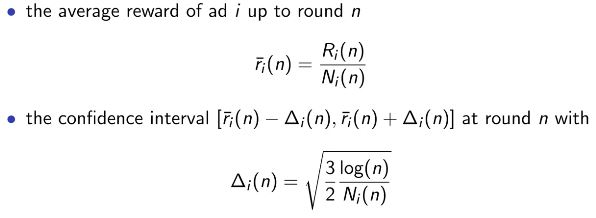</div>

- Choose the one with the highest UCB (mean+change).

### Pictorial Explanation

Do one round per ad to get the average. This is the red dotted line. Everyone will start from here.

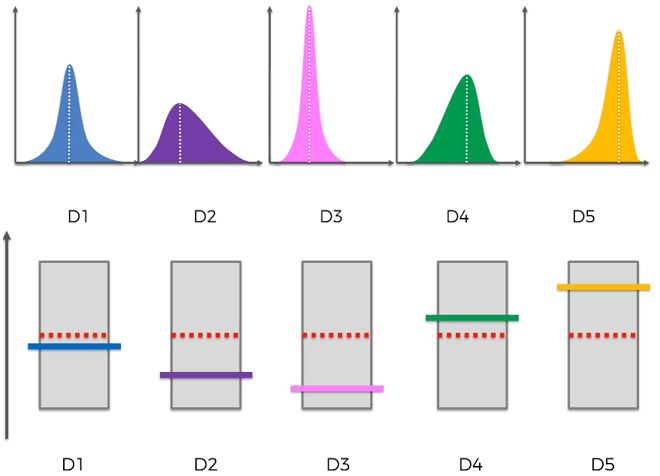

Test one of the ads. User didn't click. Hence shift the confidence interval down. We are more confident that it is not that good, so shorten it as well. Its UCB is now lower than the rest (gives chance to other options as we pick the higher one).

Test another ad. User clicks. Shift up the CI. We are more confident that it is good, so shorten the CI. Its UCB is now lower than the rest.

Keep repeating with the higher UCB option. May switch to a lower one just that you are not stuck with a seemingly good but actually suboptimal solution.

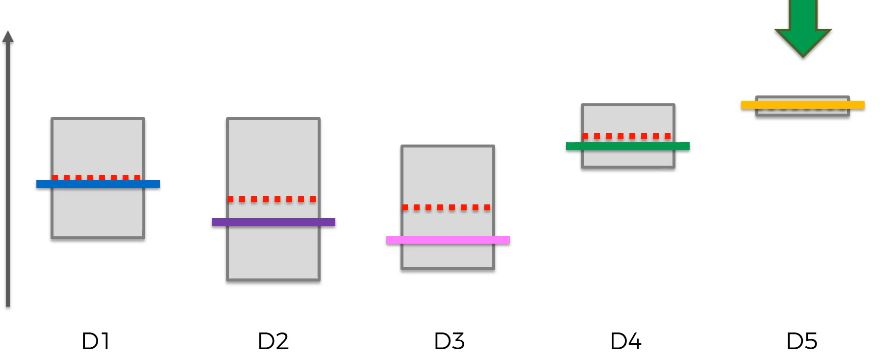

### Big Notes

- In reality, this is a dynamic process and not using static datasets. Everything happens in real time. Hence the dataset is not reliable and only serves as an introduction.
- Each advertisement in the dataset is assumed to have a **fixed conversion rate**. This is an important assumption and is close to reality.

0 0 0 inf inf
1 0 0 inf inf
2 0 0 inf inf
3 0 0 inf inf
4 0 0 inf inf
5 0 0 inf inf
6 0 0 inf inf
7 0 0 inf inf
8 0 0 inf inf
9 0 0 inf inf
0 [0] [1, 0, 0, 0, 0, 0, 0, 0, 0, 0] [1, 0, 0, 0, 0, 0, 0, 0, 0, 0] 1
was ran: 1.0 1.019666990168809
0 1 0 2.019666990168809 2.019666990168809
1 0 1 inf inf
2 0 1 inf inf
3 0 1 inf inf
4 0 1 inf inf
5 0 1 inf inf
6 0 1 inf inf
7 0 1 inf inf
8 0 1 inf inf
9 0 1 inf inf
1 [0, 1] [1, 1, 0, 0, 0, 0, 0, 0, 0, 0] [1, 0, 0, 0, 0, 0, 0, 0, 0, 0] 1
was ran: 1.0 1.2837127533066595
0 1 0 2.2837127533066592 2.2837127533066592
was ran: 0.0 1.2837127533066595
1 1 0 2.2837127533066592 1.2837127533066595
2 0 2 inf inf
3 0 2 inf inf
4 0 2 inf inf
5 0 2 inf inf
6 0 2 inf inf
7 0 2 inf inf
8 0 2 inf inf
9 0 2 inf inf
2 [0, 1, 2] [1, 1, 1, 0, 0, 0, 0, 0, 0, 0] [1, 0, 0, 0, 0, 0, 0, 0, 0, 0] 1
was ran: 1.0 1.442026886600883
0 1 0 2.4420268866008827 2.4420268866008827
was ran: 0.0 1.442026886600883
1 1 0 2.4420268866008827 1.442026886600883
was ran: 0.0 1.44202688660088

4 4 0 1.2717240404818435 1.1982239038190694
was ran: 0.0 1.1982239038190694
5 4 0 1.2717240404818435 1.1982239038190694
was ran: 0.2 1.0717240404818436
6 5 0 1.2717240404818435 1.2717240404818435
was ran: 0.3333333333333333 0.9783457206541427
7 6 7 1.311679053987476 1.311679053987476
was ran: 0.2 1.0717240404818436
8 5 7 1.311679053987476 1.2717240404818435
was ran: 0.0 1.1982239038190694
9 4 7 1.311679053987476 1.1982239038190694
45 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7] [5, 4, 4, 4, 4, 4, 5, 7, 5, 4] [1, 0, 0, 0, 0, 0, 1, 2, 1, 0] 5
was ran: 0.2 1.0747298639718808
0 5 0 1.2747298639718807 1.2747298639718807
was ran: 0.0 1.2015845166451138
1 4 0 1.2747298639718807 1.2015845166451138
was ran: 0.0 1.2015845166451138
2 4 0 1.2747298639718807 1.2015845166451138
was ran: 0.0 1.2015845166451138
3 4 0 1.2747298639718807 1.2015845166451138
was ran: 0.0 1.2015845166451138
4 4 0 1.274729863971880

was ran: 0.1111111111111111 0.8660070891097702
8 9 7 1.0560601582813587 0.9771182002208814
was ran: 0.0 0.9819597391728875
9 7 7 1.0560601582813587 0.9819597391728875
89 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7] [11, 9, 7, 7, 12, 7, 9, 12, 9, 7] [2, 1, 0, 0, 3, 0, 1, 4, 1, 0] 12
was ran: 0.18181818181818182 0.7842940809633309
0 11 0 0.9661122627815126 0.9661122627815126
was ran: 0.1111111111111111 0.8670697306173294
1 9 1 0.9781808417284406 0.9781808417284406
was ran: 0.0 0.9831646613850946
2 7 2 0.9831646613850946 0.9831646613850946
was ran: 0.0 0.9831646613850946
3 7 2 0.9831646613850946 0.9831646613850946
was ran: 0.25 0.7509044135671372
4 12 4 1.0009044135671372 1.0009044135671372
was ran: 0.0 0.9831646613850946
5 7 4 1.0009044135671372 0.9831646613850946
w

8 12 7 0.8789249540540035 0.86755117024379
was ran: 0.0 0.8590675985475292
9 10 7 0.8789249540540035 0.8590675985475292
136 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7] [16, 12, 10, 10, 18, 10, 12, 27, 12, 10] [3, 1, 0, 0, 4, 0, 1, 9, 1, 0] 19
was ran: 0.1875 0.6796543481678669
0 16 0 0.8671543481678669 0.8671543481678669
was ran: 0.08333333333333333 0.7847972417412351
1 12 1 0.8681305750745685 0.8681305750745685
was ran: 0.0 0.8597023047390189
2 10 1 0.8681305750745685 0.8597023047390189
was ran: 0.0 0.8597023047390189
3 10 1 0.8681305750745685 0.8597023047390189
was ran: 0.2222222222222222 0.6407842646032286
4 18 1 0.868130

6 20 4 0.7801237569619665 0.7763650263736745
was ran: 0.30303030303030304 0.48762451169161014
7 33 7 0.7906548147219132 0.7906548147219132
was ran: 0.06666666666666667 0.723264033175616
8 15 7 0.7906548147219132 0.7899306998422827
was ran: 0.0 0.7769101980222127
9 13 7 0.7906548147219132 0.7769101980222127
186 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7] [20, 22, 13, 13, 24, 13, 20, 34, 15, 13] [3, 4, 0, 0, 5, 0, 3, 10, 1, 0] 26
was ran: 0.15 0.6266842484156165
0 20 0 0.77668424

8 19 4 0.7264539158828474 0.7096619880690986
was ran: 0.0 0.7159822890487016
9 16 4 0.7264539158828474 0.7159822890487016
236 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4] [24, 26, 16, 16, 35, 16, 26, 43, 19, 16] [3, 4, 0, 0, 9, 0, 4, 12, 1, 0] 33
was ran: 0.125 0.5848221243288143
0 24 0 0.7098221243288143 0.7098221243288143
was ran

7 53 3 0.6690457220026454 0.6647359256520302
was ran: 0.045454545454545456 0.6217578227921361
8 22 3 0.6690457220026454 0.6672123682466815
was ran: 0.0 0.6690457220026454
9 19 3 0.6690457220026454 0.6690457220026454
289 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0,

was ran: 0.2459016393442623 0.3788809162531175
7 61 3 0.6308938705861171 0.6247825555973798
was ran: 0.038461538461538464 0.5803379542840967
8 26 3 0.6308938705861171 0.6187994927456352
was ran: 0.04 0.5918309106746253
9 25 9 0.6318309106746254 0.6318309106746254
342 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1,

6 44 4 0.6033646822826794 0.5879296316632694
was ran: 0.22388059701492538 0.3659402389201291
7 67 4 0.6033646822826794 0.5898208359350545
was ran: 0.034482758620689655 0.5562225217353003
8 29 4 0.6033646822826794 0.5907052803559899
was ran: 0.034482758620689655 0.5562225217353003
9 29 4 0.6033646822826794 0.5907052803559899
395 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 

5 28 4 0.5760380828555766 0.5719807168207366
was ran: 0.1276595744680851 0.4414804477879039
6 47 4 0.5760380828555766 0.569140022255989
was ran: 0.2191780821917808 0.3542411208004186
7 73 4 0.5760380828555766 0.5734192029921994
was ran: 0.07894736842105263 0.4909854304734452
8 38 4 0.5760380828555766 0.5699327988944978
was ran: 0.03225806451612903 0.5436001356432865
9 31 4 0.5760380828555766 0.5758582001594155
448 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9,

was ran: 0.0 0.5485435313551107
5 31 5 0.5485435313551107 0.5485435313551107
was ran: 0.11764705882352941 0.4276680997226061
6 51 5 0.5485435313551107 0.5453151585461355
was ran: 0.2073170731707317 0.33727567394975777
7 82 5 0.5485435313551107 0.5445927471204894
was ran: 0.07142857142857142 0.47126729296394176
8 42 5 0.5485435313551107 0.5426958643925132
was ran: 0.02857142857142857 0.5162474539414932
9 35 5 0.5485435313551107 0.5448188825129218
501 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0,

was ran: 0.2376237623762376 0.3063430447965876
4 101 4 0.5439668071728252 0.5439668071728252
was ran: 0.0 0.5359345327109558
5 33 4 0.5439668071728252 0.5359345327109558
was ran: 0.125 0.4114098619082325
6 56 4 0.5439668071728252 0.5364098619082325
was ran: 0.2 0.3339329304026334
7 85 4 0.5439668071728252 0.5339329304026335
was ran: 0.0851063829787234 0.44907593469208196
8 47 4 0.5439668071728252 0.5341823176708054
was ran: 0.02702702702702703 0.5061367236130178
9 37 4 0.5439668071728252 0.5331637506400448
554 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 

3 42 1 0.5278510296646848 0.5260903813612869
was ran: 0.256 0.27734833438042134
4 125 4 0.5333483343804213 0.5333483343804213
was ran: 0.02564102564102564 0.49653316884970483
5 39 4 0.5333483343804213 0.5221741944907304
was ran: 0.1206896551724138 0.407161374492271
6 58 4 0.5333483343804213 0.5278510296646848
was ran: 0.2 0.3268581466519833
7 90 4 0.5333483343804213 0.5268581466519833
was ran: 0.08163265306122448 0.44297837794354583
8 49 4 0.5333483343804213 0.5246110310047704
was ran: 0.02564102564102564 0.49653316884970483
9 39 4 0.5333483343804213 0.5221741944907304
607 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8,

6 63 6 0.5202387263256503 0.5202387263256503
was ran: 0.19791666666666666 0.3185726358485859
7 96 6 0.5202387263256503 0.5164893025152526
was ran: 0.0784313725490196 0.4370780505052174
8 51 6 0.5202387263256503 0.515509423054237
was ran: 0.045454545454545456 0.47056296878182163
9 44 6 0.5202387263256503 0.5160175142363671
661 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7,

0 81 0 0.509509940492249 0.509509940492249
was ran: 0.11290322580645161 0.39892581646421205
1 62 1 0.5118290422706636 0.5118290422706636
was ran: 0.023809523809523808 0.48468919930055054
2 42 1 0.5118290422706636 0.5084987231100744
was ran: 0.043478260869565216 0.4631365663129193
3 46 1 0.5118290422706636 0.5066148271824845
was ran: 0.26666666666666666 0.24453780815171686
4 165 1 0.5118290422706636 0.5112044748183835
was ran: 0.023809523809523808 0.48468919930055054
5 42 1 0.5118290422706636 0.5084987231100744
was ran: 0.12121212121212122 0.3866482238923576
6 66 1 0.5118290422706636 0.5078603451044787
was ran: 0.21739130434782608 0.29291328345168716
7 115 1 0.5118290422706636 0.5103045877995133
was ran: 0.07547169811320754 0.43146945138986503
8 53 1 0.5118290422706636 0.5069411495030726
was ran: 0.043478260869565216 0.4631365663129193
9 46 1 0.5118290422706636 0.5066148271824845
718 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1

was ran: 0.15476190476190477 0.34460844883793795
0 84 0 0.4993703535998427 0.4993703535998427
was ran: 0.11764705882352941 0.3830108770702659
1 68 1 0.5006579358937953 0.5006579358937953
was ran: 0.022727272727272728 0.47614499732179405
2 44 1 0.5006579358937953 0.49887227004906676
was ran: 0.058823529411764705 0.44226286595814535
3 51 3 0.5010863953699101 0.5010863953699101
was ran: 0.2712765957446808 0.23034916342325462
4 188 4 0.5016257591679354 0.5016257591679354
was ran: 0.022727272727272728 0.47614499732179405
5 44 4 0.5016257591679354 0.49887227004906676
was ran: 0.1267605633802817 0.3748317664488576
6 71 4 0.5016257591679354 0.5015923298291393
was ran: 0.21008403361344538 0.2895290086173299
7 119 4 0.5016257591679354 0.4996130422307753
was ran: 0.07272727272727272 0.4258770324631947
8 55 4 0.5016257591679354 0.4986043051904674
was ran: 0.041666666666666664 0.4558741276584546
9 48 4 0.5016257591679354 0.49754079432512127
772 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7,

824 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0,

9 56 9 0.4796513567382631 0.4796513567382631
877 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7,

6 83 4 0.4759519895080435 0.47191896226422075
was ran: 0.19708029197080293 0.2735434299872739
7 137 4 0.4759519895080435 0.4706237219580768
was ran: 0.06451612903225806 0.40662186421191554
8 62 4 0.4759519895080435 0.4711379932441736
was ran: 0.05172413793103448 0.4204095521286922
9 58 4 0.4759519895080435 0.47213369005972666
928 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6

9 59 4 0.47063042718022874 0.46924359837665464
977 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 

was ran: 0.018518518518518517 0.4390410619255431
5 54 3 0.46739600345051197 0.45755958044406164
was ran: 0.11494252873563218 0.3458934943223257
6 87 3 0.46739600345051197 0.4608360230579579
was ran: 0.1888111888111888 0.2697950649222099
7 143 3 0.46739600345051197 0.4586062537333987
was ran: 0.07246376811594203 0.3883984380157524
8 69 3 0.46739600345051197 0.46086220613169443
was ran: 0.04838709677419355 0.4097379358979438
9 62 3 0.46739600345051197 0.45812503267213733
1031 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1

1085 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

1140 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

5 59 4 0.44811936246039163 0.44141505626110555
was ran: 0.10638297872340426 0.33628298148405766
6 94 4 0.44811936246039163 0.4426659602074619
was ran: 0.18181818181818182 0.2627292678657725
7 154 4 0.44811936246039163 0.4445474496839543
was ran: 0.06666666666666667 0.3764767704523236
8 75 4 0.44811936246039163 0.44314343711899024
was ran: 0.06666666666666667 0.3764767704523236
9 75 4 0.44811936246039163 0.44314343711899024
1195 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1571 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

was ran: 0.056179775280898875 0.35299512429624097
9 89 8 0.4107035843241199 0.4091748995771398
1624 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7,

8 107 1 0.4067478607529443 0.4067478607529443
was ran: 0.054945054945054944 0.349851410068362
9 91 1 0.4067478607529443 0.40479646501341693
1677 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7,

7 234 0 0.40415750280504115 0.40238773060096816
was ran: 0.08256880733944955 0.3203307040132393
8 109 0 0.40415750280504115 0.40289951135268887
was ran: 0.05434782608695652 0.34867266686249354
9 92 0 0.40415750280504115 0.4030204929494501
1730 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




was ran: 0.25925925925925924 0.12971754314130582
4 675 2 0.3890746559920778 0.3889768024005651
was ran: 0.0125 0.37679541322291465
5 80 5 0.38929541322291467 0.38929541322291467
was ran: 0.1056338028169014 0.2828175975418417
6 142 5 0.38929541322291467 0.38845140035874315
was ran: 0.1952054794520548 0.19722373320313846
7 292 7 0.39242921265519326 0.39242921265519326
was ran: 0.07692307692307693 0.31157146049023565
8 117 7 0.39242921265519326 0.3884945374133126
was ran: 0.050505050505050504 0.3387138876955594
9 99 7 0.39242921265519326 0.3892189382006099
1942 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3

was ran: 0.1056338028169014 0.28330105081491624
6 142 6 0.3889348536318177 0.3889348536318177
was ran: 0.20606060606060606 0.1858383700291708
7 330 7 0.39189897608977686 0.39189897608977686
was ran: 0.07692307692307693 0.31210406611195024
8 117 7 0.39189897608977686 0.38902714303502717
was ran: 0.05 0.3375921640942318
9 100 7 0.39189897608977686 0.3875921640942318
1993 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 

was ran: 0.012048192771084338 0.37114706422095883
5 83 4 0.3848369479044773 0.38319525699204315
was ran: 0.10344827586206896 0.280802567679419
6 145 4 0.3848369479044773 0.384250843541488
was ran: 0.2028985507246377 0.18204364735602643
7 345 7 0.3849421980806641 0.3849421980806641
was ran: 0.075 0.30867002192506526
8 120 7 0.3849421980806641 0.3836700219250653
was ran: 0.049019607843137254 0.33479964585549526
9 102 7 0.3849421980806641 0.3838192536986325
2042 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5

2094 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0.36522824585720587
5 88 4 0.37804848479269465 0.3765918822208422
was ran: 0.10625 0.2708605164370813
6 160 4 0.37804848479269465 0.3771105164370813
was ran: 0.1989247311827957 0.17763732457322198
7 372 4 0.37804848479269465 0.37656205575601764
was ran: 0.07142857142857142 0.30522522387301676
8 126 4 0.37804848479269465 0.37665379530158816
was ran: 0.046296296296296294 0.3296809217557517
9 108 4 0.37804848479269465 0.375977218052048
2503 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6

was ran: 0.26833976833976836 0.10659279928449535
4 1036 1 0.37502980752530324 0.3749325676242637
was ran: 0.011235955056179775 0.3636744091771285
5 89 1 0.37502980752530324 0.37491036423330826
was ran: 0.10493827160493827 0.26955676644227067
6 162 1 0.37502980752530324 0.37449503804720896
was ran: 0.19733333333333333 0.17717078581029988
7 375 1 0.37502980752530324 0.37450411914363324
was ran: 0.0703125 0.3032513622475545
8 128 1 0.37502980752530324 0.3735638622475545
was ran: 0.045871559633027525 0.3286203821181567
9 109 1 0.37502980752530324 0.3744919417511842
2558 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 

6 164 4 0.372674341072455 0.37189019366024023
was ran: 0.19633507853403143 0.17575199971730912
7 382 4 0.372674341072455 0.3720870782513406
was ran: 0.06976744186046512 0.30243851812348116
8 129 4 0.372674341072455 0.3722059599839463
was ran: 0.04504504504504504 0.3260396867537245
9 111 4 0.372674341072455 0.37108473179876955
2607 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0.3658895518124912 0.36220320270680756
2865 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 

was ran: 0.042735042735042736 0.31983562226143675
9 117 7 0.3627131650434277 0.3625706649964795
2918 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7

3 187 2 0.36102736048077066 0.3602084230312832
was ran: 0.2616899097621001 0.09919268341518707
4 1219 2 0.36102736048077066 0.36088259317728716
was ran: 0.01020408163265306 0.3498391862647523
5 98 2 0.36102736048077066 0.3600432678974054
was ran: 0.1043956043956044 0.2567117799767323
6 182 6 0.3611073843723367 0.3611073843723367
was ran: 0.1891891891891892 0.17166599986298203
7 407 6 0.3611073843723367 0.36085518905217123
was ran: 0.08333333333333333 0.2772804133759888
8 156 6 0.3611073843723367 0.3606137467093221
was ran: 0.04201680672268908 0.31747388845378033
9 119 6 0.3611073843723367 0.3594906951764694
2968 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0.20074349442379183 0.15063857337410885
7 538 4 0.3520730366896361 0.3513820677979007
was ran: 0.0893854748603352 0.2611564860411586
8 179 4 0.3520730366896361 0.3505419609014938
was ran: 0.03968253968253968 0.3112734357345706
9 126 4 0.3520730366896361 0.3509559754171103
3424 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3

7 540 2 0.35054665216300107 0.3504851974612291
was ran: 0.09239130434782608 0.25779931014924357
8 184 2 0.35054665216300107 0.3501906144970697
was ran: 0.03937007874015748 0.3103050202936647
9 127 2 0.35054665216300107 0.34967509903382216
3471 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [352, 237, 120, 215, 1600, 109, 211, 553, 188, 130] [56, 28, 3, 23, 416, 1, 22, 109, 17, 5] 680
was ran: 0.1590909090909091 0.1871633694030659
0 352 0 0.346254278493975 0.346254278493975
was ran: 0.11814345991561181 0.22809618085601424
1 237 0 0.346254278493975 0.34623964077162606
was ran: 0.025 0.32055426802519976
2 120 0 0.346254278493975 0.3455542680251998
was ran: 0.10697674418604651 0.2394820442839533
3 215 3 0.34645878846999983 0.34645878846999983
was ran: 0.26 0.08778740175097946
4 1600 4 0.34778740175097944 0.34778740175097944
was ran: 0.009174311926605505 0.33634032363342986
5 109 4 0.34778740175097944 0.34551463556003537
was ran: 0.10426540284360189 0.24174135888731427
6 211 4 0.34778740175097944 0.34600676173091616
was ran: 0.19710669077757687 0.14932400207186036
7 553 4 0.34778740175097944 0.3464306928494372
was ran: 0.09042553191489362 0.25610217220057746
8 188 4 0.34778740175097944 0.34652770411547107
was ran: 0.038461538461538464 0.3079785787992979
9 130 4 0.34778740175

8 189 7 0.3494381621900924 0.3455784078799133
was ran: 0.03816793893129771 0.30705014961785715
9 131 7 0.3494381621900924 0.34521808854915487
3765 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 

6 211 4 0.34743460676718174 0.3464084398756829
was ran: 0.1996527777777778 0.1465554492549371
7 576 4 0.34743460676718174 0.3462082270327149
was ran: 0.08994708994708994 0.25584816751200334
8 189 4 0.34743460676718174 0.3457952574590933
was ran: 0.03816793893129771 0.3073106172955667
9 131 4 0.34743460676718174 0.3454785562268644
3818 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0.2208270862140237
3 259 1 0.3410891614684202 0.34051820590514337
was ran: 0.2664266426642664 0.07539285624016628
4 2222 4 0.3418194989044327 0.3418194989044327
was ran: 0.008695652173913044 0.3314006103153041
5 115 4 0.3418194989044327 0.34009626248921715
was ran: 0.1004566210045662 0.2401486594337669
6 219 4 0.3418194989044327 0.3406052804383331
was ran: 0.19838709677419356 0.14272707950838712
7 620 4 0.3418194989044327 0.3411141762825807
was ran: 0.09 0.25129695501036164
8 200 4 0.3418194989044327 0.3412969550103616
was ran: 0.0364963503649635 0.30362808501671795
9 137 4 0.3418194989044327 0.34012443538168147
4536 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6,

2 126 1 0.34123910799950874 0.34063220410664186
was ran: 0.11969111969111969 0.22097933091016758
3 259 1 0.34123910799950874 0.34067045060128726
was ran: 0.2681318681318681 0.07456084750078955
4 2275 4 0.3426927156326577 0.3426927156326577
was ran: 0.008695652173913044 0.33162908765512855
5 115 4 0.3426927156326577 0.3403247398290416
was ran: 0.1004566210045662 0.2403142249914695
6 219 4 0.3426927156326577 0.3407708459960357
was ran: 0.19838709677419356 0.14282547976002202
7 620 4 0.3426927156326577 0.34121257653421555
was ran: 0.09 0.25147020653132934
8 200 4 0.3426927156326577 0.3414702065313293
was ran: 0.0364963503649635 0.30383741515975726
9 137 4 0.3426927156326577 0.3403337655247208
4589 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9

1 267 1 0.3413872315575833 0.3413872315575833
was ran: 0.023809523809523808 0.3170383030040152
2 126 1 0.3413872315575833 0.340847826813539
was ran: 0.11969111969111969 0.22112972469338565
3 259 1 0.3413872315575833 0.34082084438450533
was ran: 0.2693298969072165 0.07375738643781074
4 2328 4 0.34308728334502725 0.34308728334502725
was ran: 0.008695652173913044 0.3318547872846467
5 115 4 0.34308728334502725 0.34055043945855973
was ran: 0.1004566210045662 0.24047777768804396
6 219 4 0.34308728334502725 0.34093439869261016
was ran: 0.19838709677419356 0.14292268371186934
7 620 4 0.34308728334502725 0.34130978048606286
was ran: 0.09 0.25164135174916985
8 200 4 0.34308728334502725 0.3416413517491699
was ran: 0.0364963503649635 0.3040442003742877
9 137 4 0.34308728334502725 0.3405405507392512
4642 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



was ran: 0.034482758620689655 0.2981630621953413
9 145 4 0.33474407488067315 0.33264582081603095
5397 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 

5447 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

was ran: 0.15571776155717762 0.1772846265468667
0 411 0 0.3330023881040443 0.3330023881040443
was ran: 0.12110726643598616 0.21141853855766551
1 289 0 0.3330023881040443 0.3325258049936517
was ran: 0.034482758620689655 0.2984750177364619
2 145 0 0.3330023881040443 0.33295777635715157
was ran: 0.11439114391143912 0.21832694727680244
3 271 0 0.3330023881040443 0.3327180911882416
was ran: 0.267273340074149 0.06598317582047722
4 2967 4 0.33325651589462624 0.33325651589462624
was ran: 0.008130081300813009 0.3240704499194616
5 123 4 0.33325651589462624 0.3322005312202746
was ran: 0.10245901639344263 0.23008964531361734
6 244 4 0.33325651589462624 0.33254866170706
was ran: 0.19593613933236576 0.13692488247578016
7 689 4 0.33325651589462624 0.3328610218081459
was ran: 0.08530805687203792 0.24742909129145288
8 211 4 0.33325651589462624 0.3327371481634908
was ran: 0.034482758620689655 0.2984750177364619
9 145 4 0.33325651589462624 0.33295777635715157
5495 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 4 0.3224721325674612 0.32221541297828316
was ran: 0.08296943231441048 0.2392215809033685
8 229 4 0.3224721325674612 0.322191013217779
was ran: 0.037037037037037035 0.28442029989007417
9 162 4 0.3224721325674612 0.3214573369271112
6226 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6

6272 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

3 301 2 0.32213539596582513 0.3217916714791091
was ran: 0.2608824400355345 0.06234773986667429
4 3377 4 0.3232301799022088 0.3232301799022088
was ran: 0.007518796992481203 0.31416689844816004
5 133 4 0.3232301799022088 0.32168569544064124
was ran: 0.09848484848484848 0.222989432168332
6 264 4 0.3232301799022088 0.3214742806531805
was ran: 0.1950920245398773 0.12691338880725525
7 815 4 0.3232301799022088 0.32200541334713256
was ran: 0.08260869565217391 0.2389033980750138
8 230 4 0.3232301799022088 0.3215120937271877
was ran: 0.037037037037037035 0.284661502801539
9 162 4 0.3232301799022088 0.32169853983857605
6319 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0.0072992700729927005 0.311381209236737
5 137 0 0.32043053965678053 0.3186804793097297
was ran: 0.09665427509293681 0.22221662354546204
6 269 0 0.32043053965678053 0.31887089863839885
was ran: 0.2073170731707317 0.11162824119997997
7 1066 0 0.32043053965678053 0.31894531437071166
was ran: 0.08333333333333333 0.2352594425381385
8 240 0 0.32043053965678053 0.31859277587147183
was ran: 0.03614457831325301 0.2828776532419038
9 166 0 0.32043053965678053 0.3190222315551568
7012 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1,

5 138 0 0.31844049347199577 0.31761432693179964
was ran: 0.0962962962962963 0.22188836445493246
6 270 0 0.31844049347199577 0.31818466075122875
was ran: 0.20673526660430308 0.11151352863234316
7 1069 0 0.31844049347199577 0.31824879523664623
was ran: 0.08298755186721991 0.23485936902495616
8 241 0 0.31844049347199577 0.3178469208921761
was ran: 0.03592814371257485 0.2821357860514045
9 167 0 0.31844049347199577 0.31806392976397935
7059 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [645, 354, 179, 317, 4350, 143, 278, 1118, 248, 173] [109, 42, 7, 34, 1125, 1, 26, 228, 20, 6] 1598
was ran: 0.16899224806201552 0.14437232186373844
0 645 0 0.31336456992575396 0.31336456992575396
was ran: 0.11864406779661017 0.19487770989125464
1 354 1 0.3135217776878648 0.3135217776878648
was ran: 0.03910614525139665 0.27405471787379865
2 179 1 0.3135217776878648 0.3131608631251953
was ran: 0.10725552050473186 0.20593689825250805
3 317 1 0.3135217776878648 0.3131924187572399
was ran: 0.25862068965517243 0.05559287956061974
4 4350 4 0.3142135692157922 0.3142135692157922
was ran: 0.006993006993006993 0.30661668196889463
5 143 4 0.3142135692157922 0.3136096889619016
was ran: 0.09352517985611511 0.21990818818046765
6 278 4 0.3142135692157922 0.3134333680365827
was ran: 0.2039355992844365 0.10965865040151139
7 1118 4 0.3142135692157922 0.3135942496859479
was ran: 0.08064516129032258 0.23282947450879948
8 248 4 0.3142135692157922 0.31347463579912205
was ran: 0.03468208092485549 0.27876660

7852 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [652, 364, 182, 326, 5054, 146, 282, 1129, 252, 182] [109, 43, 7, 35, 1319, 1, 26, 228, 20, 7] 1795
was ran: 0.16717791411042945 0.1443412926677588
0 652 0 0.31151920677818823 0.31151920677818823
was ran: 0.11813186813186813 0.19318068264365776
1 364 0 0.31151920677818823 0.3113125507755259
was ran: 0.038461538461538464 0.2731987413831536
2 182 2 0.311660279844692 0.311660279844692
was ran: 0.10736196319018405 0.20412941370120866
3 326 2 0.311660279844692 0.3114913768913927
was ran: 0.26098140087059757 0.0518437931815361
4 5054 4 0.31282519405213366 0.31282519405213366
was ran: 0.00684931506849315 0.3050267731050422
5 146 4 0.31282519405213366 0.3118760881735354
was ran: 0.09219858156028368 0.2194774137993284
6 282 4 0.31282519405213366 0.3116759953596121
was ran: 0.20194862710363154 0.10969009617439991
7 1129 4 0.31282519405213366 0.31163872327803144
was ran: 0.07936507936507936 0.23217428556694814
8 252 4 0.31282519405213366 0.3115393649320275
was ran: 0.038461538461538464 0.2731987

6 282 4 0.31347334608585586 0.31174366632789097
was ran: 0.20194862710363154 0.1097239166705058
7 1129 4 0.31347334608585586 0.31167254377413733
was ran: 0.07936507936507936 0.23224587133261665
8 252 4 0.31347334608585586 0.311610950697696
was ran: 0.038461538461538464 0.2732829761253165
9 182 4 0.31347334608585586 0.3117445145868549
8617 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6 284 4 0.3120470921501358 0.3112915700831784
was ran: 0.20241171403962102 0.10868176311804616
7 1161 4 0.3120470921501358 0.31109347715766716
was ran: 0.07874015748031496 0.23235708893409193
8 254 4 0.3120470921501358 0.3110972464144069
was ran: 0.03804347826086957 0.2730007710372242
9 184 4 0.3120470921501358 0.31104424929809377
9341 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6

9384 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



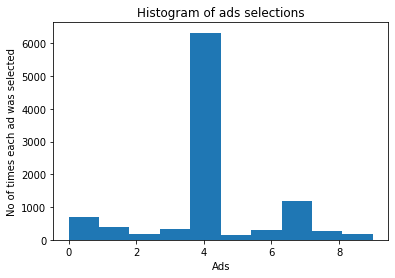

In [4]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Ads_CTR_Optimisation.csv")

### 3. Modelling

N = 10000 # no of times you wanna run. can be higher or lower
d = 10 # no of ads
ads_selected = [] # to store per round the ads selected
numbers_of_selections = [0]*d # this is Ni(n). if ad 3 was chosen then for it will be incremented by 1
sums_of_rewards = [0]*d # this is Ri(n)
total_reward = 0

import math
for n in range(0,N): 
    ad = 0
    max_upperbound = 0
    
    for i in range(0,d): 
        if numbers_of_selections[i] > 0: # if ad was chosen before
            average_reward = sums_of_rewards[i] / numbers_of_selections[i]
            delta_i = math.sqrt(3/2 * math.log(n+1) / numbers_of_selections[i]) # supposed to be log(n) but then first round will be log0=1. another way is to make for n in range(1,N+1).
            upper_bound = average_reward + delta_i
            print("was ran:",average_reward, delta_i)
            
        else: # this is actually what happens for the 10 first rounds aka the first row
            upper_bound = 1e400
        if upper_bound > max_upperbound:
            max_upperbound = upper_bound
            ad = i # choose the one with the highest upperbound
        print(i,numbers_of_selections[i],ad, max_upperbound, upper_bound)
            
    ads_selected.append(ad)
    numbers_of_selections[ad] += 1
    reward = data.values[n,ad]
    sums_of_rewards[ad] += reward
    total_reward += reward
    
    print(n,ads_selected,numbers_of_selections, sums_of_rewards, total_reward)

### 4. Visualisation

plt.hist(ads_selected)
plt.title('Histogram of ads selections')
plt.xlabel('Ads')
plt.ylabel('No of times each ad was selected')
plt.show()

In [2]:
data

,Ad 1,Ad 2,Ad 3,Ad 4,Ad 5,Ad 6,Ad 7,Ad 8,Ad 9,Ad 10
0,1,0,0,0,1,0,0,0,1,0
1,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,0,0
3,0,1,0,0,0,0,0,1,0,0
4,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
9995,0,0,1,0,0,0,0,1,0,0
9996,0,0,0,0,0,0,0,0,0,0
9997,0,0,0,0,0,0,0,0,0,0
9998,1,0,0,0,0,0,0,1,0,0


In [5]:
numbers_of_selections

[705, 387, 186, 345, 6323, 150, 292, 1170, 256, 186]

In [14]:
sums_of_rewards

[120, 47, 7, 38, 1675, 1, 27, 236, 20, 7]

In [16]:
print(ads_selected)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 0, 8, 1, 2, 3, 4, 5, 6, 6, 7, 7, 7, 9, 7, 0, 6, 8, 1, 2, 3, 4, 4, 4, 4, 4, 5, 9, 7, 0, 0, 6, 8, 4, 0, 7, 1, 1, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 2, 3, 5, 9, 4, 1, 6, 8, 0, 7, 7, 7, 7, 7, 7, 4, 2, 3, 5, 9, 1, 6, 8, 0, 0, 7, 0, 4, 1, 6, 8, 2, 3, 5, 9, 7, 0, 4, 4, 4, 7, 7, 7, 7, 1, 6, 8, 2, 3, 5, 9, 0, 7, 7, 4, 7, 7, 7, 1, 6, 8, 0, 4, 4, 2, 3, 5, 9, 4, 7, 0, 7, 1, 1, 1, 6, 6, 6, 6, 6, 8, 4, 2, 3, 5, 9, 7, 7, 7, 0, 6, 4, 1, 1, 1, 8, 7, 2, 3, 5, 9, 4, 0, 1, 1, 1, 6, 7, 8, 4, 1, 2, 3, 5, 9, 0, 6, 7, 8, 4, 7, 1, 0, 6, 2, 3, 5, 9, 7, 7, 7, 7, 4, 4, 4, 4, 4, 7, 8, 1, 0, 6, 6, 6, 7, 4, 2, 3, 5, 9, 1, 6, 8, 7, 0, 4, 4, 4, 4, 4, 2, 3, 5, 9, 1, 6, 7, 4, 8, 0, 7, 4, 4, 4, 1, 6, 2, 3, 5, 9, 0, 0, 0, 7, 8, 4, 0, 0, 0, 1, 6, 7, 4, 2, 3, 5, 9, 0, 8, 7, 1, 6, 4, 0, 7, 7, 7, 7, 7, 2, 3, 5, 9, 8, 4, 1, 6, 6, 6, 7, 7, 7, 0, 6, 7, 4, 1, 1, 1, 2, 2, 2, 3, 5, 9, 2, 8, 7, 0, 1, 6, 4, 7, 2, 8, 3, 5, 9, 9, 9, 9, 4, 0, 1, 

# Chapter 19 - Thompson Sampling
<div>&nbsp;</div>
<div>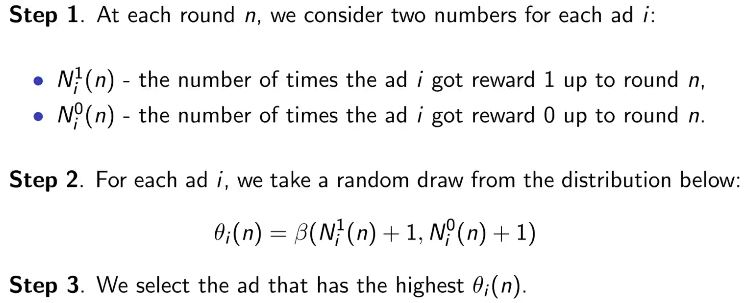</div>

It uses this:
<div>&nbsp;</div>
<div>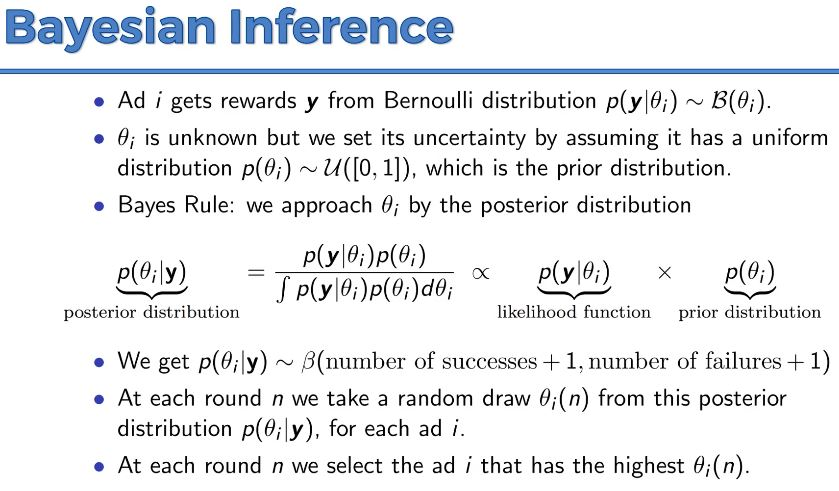</div>

The pictorial description:

The coloured vertical axis show us the expected returns of 3 machines. You cannot see it in actuality. The yellow one is the best.

<div>&nbsp;</div>
<div>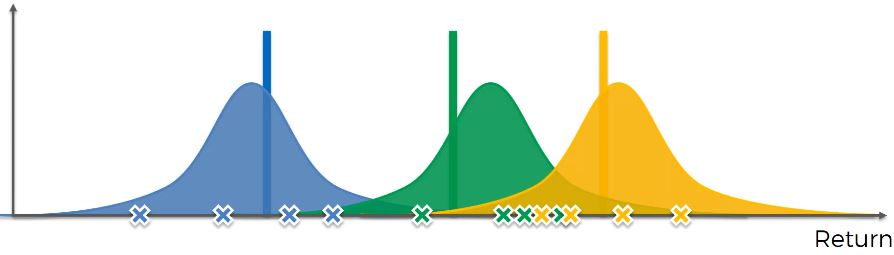</div>

As above: You then do several rounds for each machine to construct its respective initial distribution, to guess where we THINK the estimated value might lie.

<div>&nbsp;</div>
<div>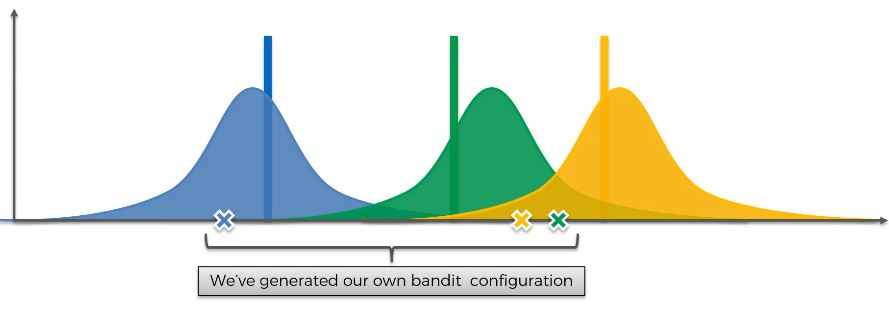</div>

As above: You then choose a random spot in each distribution. These are acted as if they were the expected values. We then choose the one with the highest value (green in picture) and pull the green machine. A new value is generated. Its curve will then shift towards it and become thinner.

Hence the earlier probabilites are the prior probability.

<div>&nbsp;</div>
<div>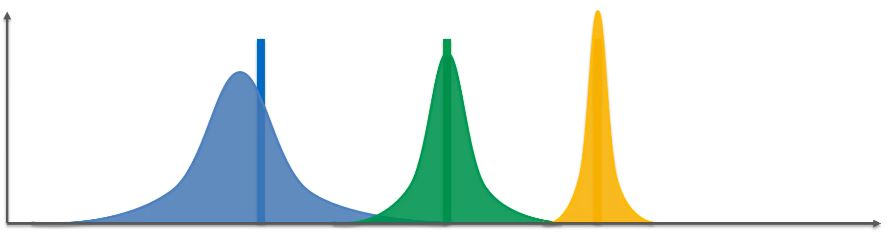</div>

### Comparison

The key difference is that TS can update in batches while UCB must update every round, which may be computationally expensive.

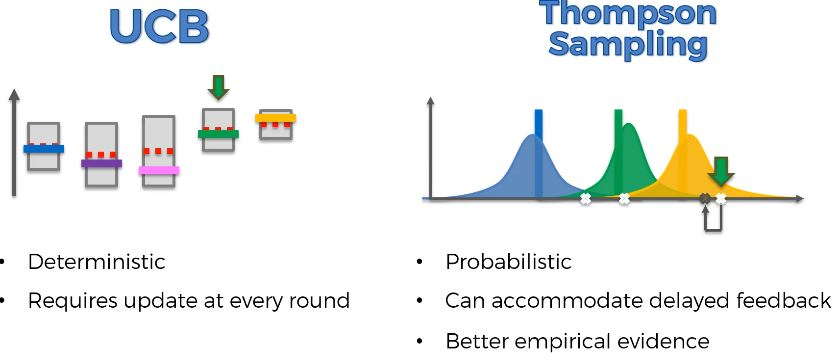

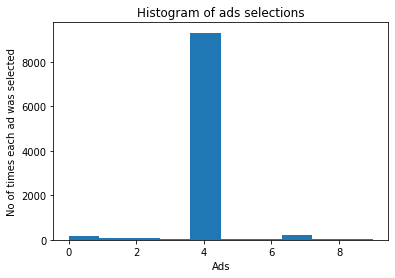

In [20]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Ads_CTR_Optimisation.csv")

### 3. Modelling

import random # since we need beta distributions
N = 10000
d = 10
ads_selected = []
numbers_of_rewards_1 = [0] * d
numbers_of_rewards_0 = [0] * d
total_reward = 0

for n in range(0, N):
    ad = 0 # index for ads
    max_random = 0 # highest beta distribution
    
    for i in range(0,d):
        random_beta = random.betavariate(numbers_of_rewards_1[i] + 1, numbers_of_rewards_0[i] + 1) # that equation
        if random_beta > max_random: # keep track of largest return
            max_random = random_beta
            ad = i
    
    ads_selected.append(ad)
    reward = data.values[n,ad]
    if reward == 1:
        numbers_of_rewards_1[ad] += 1
    elif reward == 0:
        numbers_of_rewards_0[ad] += 1
    total_reward += reward
    
### 4. Visualisation

plt.hist(ads_selected)
plt.title('Histogram of ads selections')
plt.xlabel('Ads')
plt.ylabel('No of times each ad was selected')
plt.show()

# Chapter 20 - Natural Language Processing (NLP)

### Bag of Words Model

Assume 20,000 words are commonly used (actually just 3,000!). Map each word to somewhere in the array. The first two are reserved for SOS (Start of Sentence) and EOS (End of Sentence), and the last one is Special Words (any words not in the 20K).
<div>&nbsp;</div>
<div>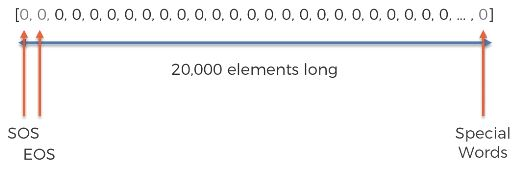</div>
You will then use past data and categorise them into Yes 1 or No 0. Using that, you predict what your current data would be categorised into.
<div>&nbsp;</div>
<div>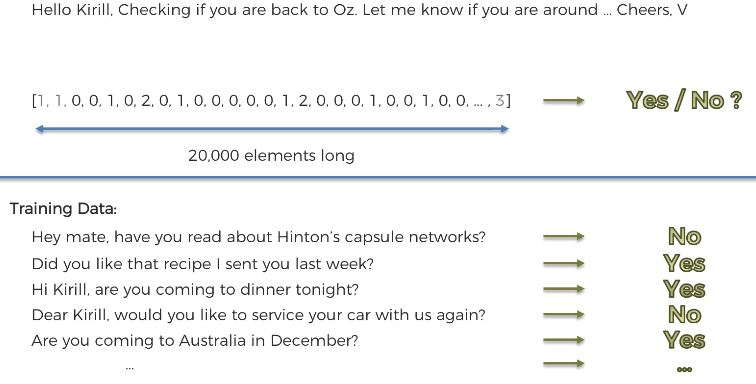</div>

In [15]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

# Get the Dataset
data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Restaurant_Reviews.tsv", delimiter='\t', quoting=3) # tsv means tab-separated values; quoting=3 means ignore all "" or else will have parsing errors

# Preprocessing Preparation (incl. Stopwords + Stemming)
import re
import nltk # for stopwords, ie irrelevant words like 'the' 'and'
# nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer # to apply stemming, ie transform words into root word
corpus = [] # to store all the reviews but cleaned up
for i in range(0,1000):
    review = re.sub('[^a-zA-Z]',' ',data['Review'][i]) # re.sub() substitutes a letter to smth else. Read as substitute anything which is not an alphabet into a space (^ means NOT), using this dataset
    review = review.lower()
    review = review.split() # split into individual words
    
    ps = PorterStemmer()
    all_stopwords = stopwords.words('english')
    all_stopwords.remove('not') # remove the word 'not' from stopwords
    review = [ps.stem(word) for word in review if not word in set(all_stopwords)] # go through each word, remove those stopwords, stem them
    review = ' '.join(review) # link up and separate word with space
    corpus.append(review)
    
# Tokenisation = Bag of Words model

from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features=1500) # no. if max size of matrix you want (optional). without it youll get 1566 words.
X = cv.fit_transform(corpus).toarray() # fittransform puts the words in reviews into columns; toarray to change it into 2D array
Y = data.iloc[:,-1].values

# Train Test Split

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

### 3. Modelling

from sklearn.naive_bayes import GaussianNB
classifier = GaussianNB()
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

## use these other metrics other than just CM
# Accuracy = (TP + TN) / (TP + TN + FP + FN)
# Precision = TP / (TP + FP)
# Recall = TP / (TP + FN)
# F1 Score = 2 * Precision * Recall / (Precision + Recall)

### 6. Evaluations

# Predict if a Review is Positive or Negative

new_review = 'I love this restaurant so much'
new_review = re.sub('[^a-zA-Z]', ' ', new_review)
new_review = new_review.lower()
new_review = new_review.split()
ps = PorterStemmer()
all_stopwords = stopwords.words('english')
all_stopwords.remove('not')
new_review = [ps.stem(word) for word in new_review if not word in set(all_stopwords)]
new_review = ' '.join(new_review)
new_corpus = [new_review]
new_X_test = cv.transform(new_corpus).toarray()
new_y_pred = classifier.predict(new_X_test)
print(new_y_pred) # positive

new_review = 'I hate this restaurant so much'
new_review = re.sub('[^a-zA-Z]', ' ', new_review)
new_review = new_review.lower()
new_review = new_review.split()
ps = PorterStemmer()
all_stopwords = stopwords.words('english')
all_stopwords.remove('not')
new_review = [ps.stem(word) for word in new_review if not word in set(all_stopwords)]
new_review = ' '.join(new_review)
new_corpus = [new_review]
new_X_test = cv.transform(new_corpus).toarray()
new_y_pred = classifier.predict(new_X_test)
print(new_y_pred) # negative

[[1 0]
 [1 0]
 [1 0]
 [0 0]
 [0 0]
 [1 0]
 [1 1]
 [1 0]]
[[ 67  50]
 [ 20 113]] 0.72
[1]
[0]


In [22]:
data

,Review,Liked
0,Wow... Loved this place.,1
1,Crust is not good.,0
2,Not tasty and the texture was just nasty.,0
3,Stopped by during the late May bank holiday of...,1
4,The selection on the menu was great and so wer...,1
...,...,...
995,I think food should have flavor and texture an...,0
996,Appetite instantly gone.,0
997,Overall I was not impressed and would not go b...,0
998,"The whole experience was underwhelming, and I ...",0


In [7]:
corpus[:5]

['wow love place',
 'crust not good',
 'not tasti textur nasti',
 'stop late may bank holiday rick steve recommend love',
 'select menu great price']

# Deep Learning
# Chapter 21 - Artificial Neural Networks

Everything here can be found [here](https://www.superdatascience.com/blogs/the-ultimate-guide-to-artificial-neural-networks-ann) as well.

<div>&nbsp;</div>
<div>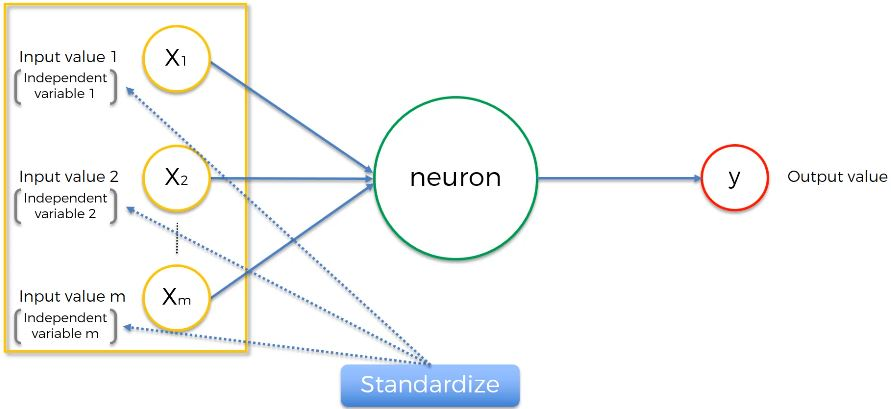</div>

Each input layer is for each feature. We should standardise or normalise each input as well. Furthermore, all of this is for ONE ROW of our data. You also see one output node there which can be continuous, binary, or categorical. If categorical, then there will be many output nodes; the rest are just one node. Each node is called a **perceptron**.

Furthermore each line has a weight, which says which signal is important and which is not for that neuron.

Inside each node, it (a) sums up all the weights, (b) applies activation function on the weighted sum, and (c) pass or not pass the signal.

### Activation Function (4 Types)

1) Threshold Function

<div>&nbsp;</div>
<div>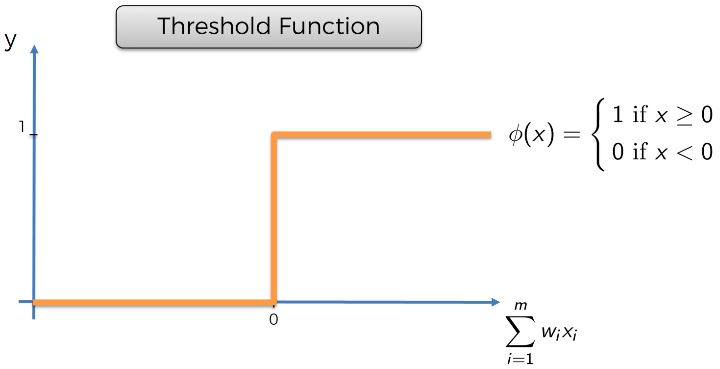</div>

If weighted sum is negative = 0; if positive = 1.

2) Sigmoid

<div>&nbsp;</div>
<div>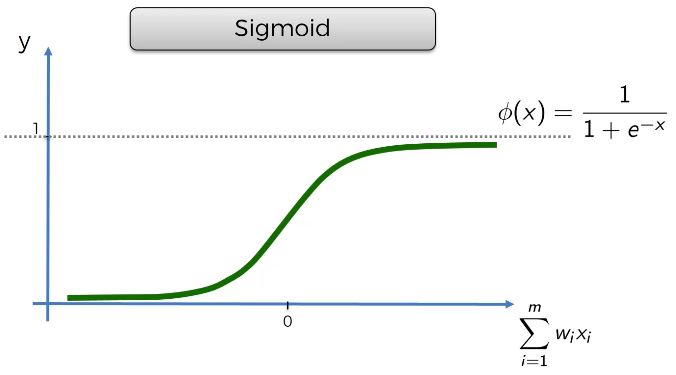</div>

If weighted sum is negative then tends towards 0; if positive tends towards 1.

3) Rectifier

<div>&nbsp;</div>
<div>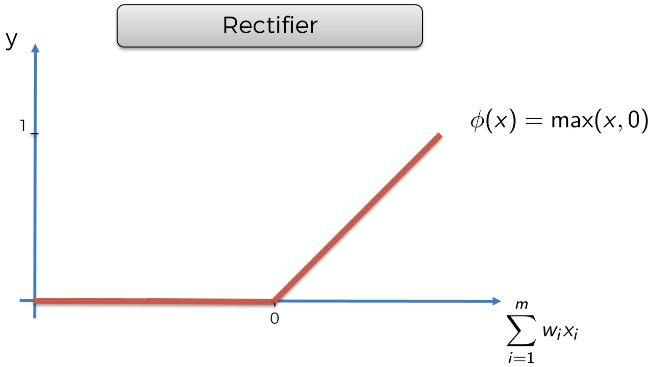</div>

If negative = 0; if positive tends towards 1. Most used.

4) Hyperbolic Tangent / Tanh

<div>&nbsp;</div>
<div>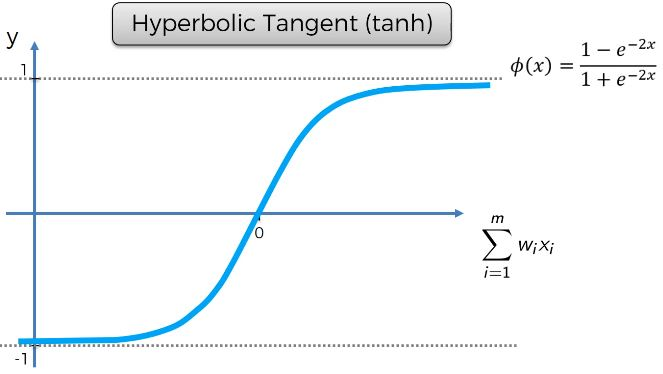</div>

If negative tends towards -1; if positive tends towards 1.

But **practically** for binary outputs, usually use **rectifier function for hidden layers** and use **sigmoid function for the output layer**.
<div>&nbsp;</div>
<div>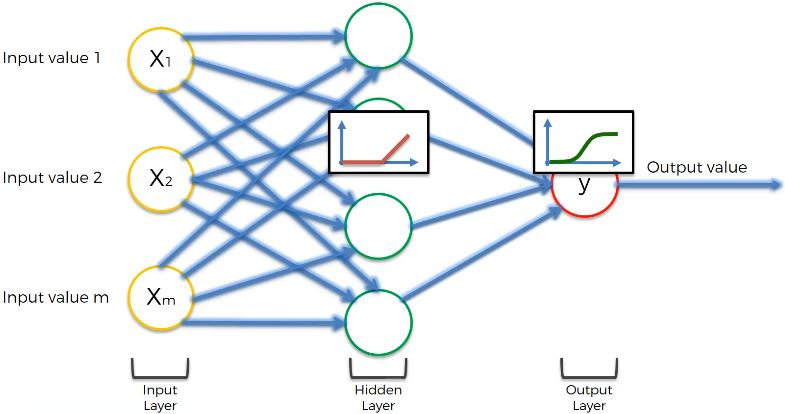</div>

### Mechanism

<div>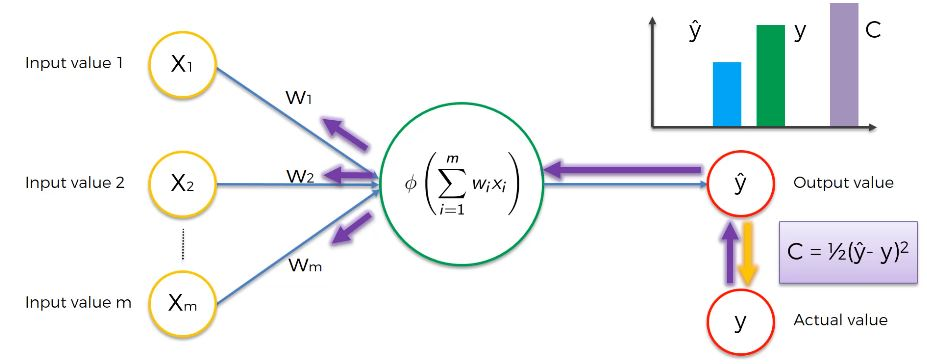</div>

The input values go inside the perceptron, through the activation function outputs a value y-hat. The y-hat is then compared to the actual y. This comparison is called the **cost function** and there are many types - one popular type is 0.5 * (y-hat - y)^2. The cost function tells us what is the error we have in our prediction; the lower it is the less error.

After calculating the cost function, you feed this value back into the NN, and it goes backwards to the weights to update them. The weights are tweaked until the error is minimised.

Then we repeat the entire process again, the error reduces, and y-hat gets closer to y.

Now let us visualise working with many rows.
<div>&nbsp;</div>
<div>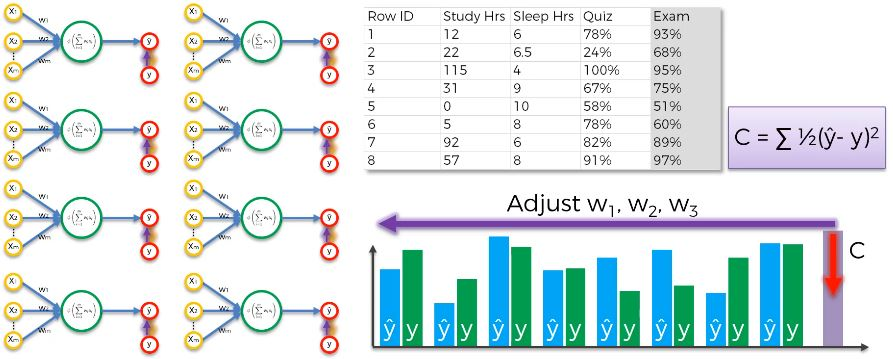</div>

All the rows are fed into the NN to calculate their y-hats. They are then compared to their actual y's. The cost function then calculates the **sum of all cost functions**. We then backpropagate and update the weights. Note that the weights are the same for ALL rows. This is one epoch. Repeat this again many times with a decreasing cost function.

Read more [here](https://iamtrask.github.io/2015/07/12/basic-python-network/).

### Gradient Descent

This is basically how the weights are adjusted.

One method would be a brute force method. You try out millions of combinations of weights, measure the cost functions, and choose the minimum. However, as you increase no. of features, you will increase no. of weights, and will lead to the **curse of dimensionality**. Basically, no don't do this. Hence we invited gradient descent.

<div>&nbsp;</div>
<div>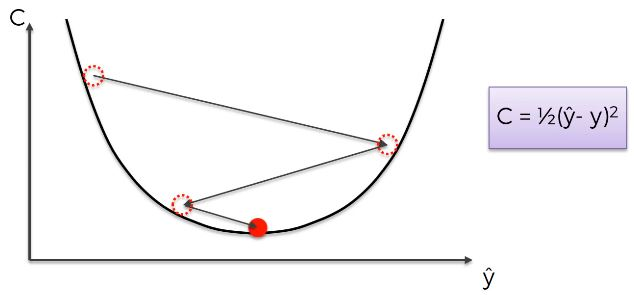</div>
<div>&nbsp;</div>
<div>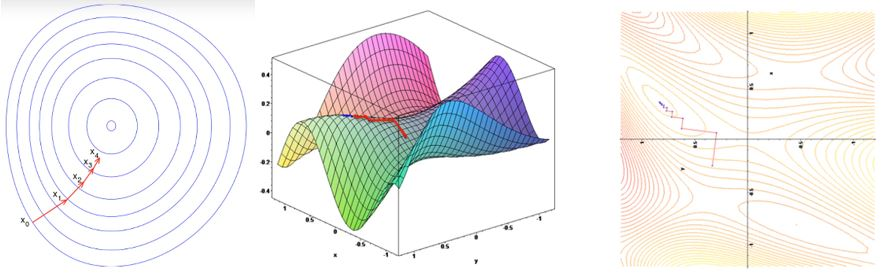</div>

Basically what happens is we calculate our first cost function, then calculate its tangent by using differentiation. If the slope is negative it means you're downhill, so you need to go right. If the slope is positive you're uphill, you need to go left. So keep repeating until you find the minimum.

Pictured above is the 1D showcase, then the 2D concentric circles, and 3D and mapped to a 2D graph. All show how the gradient descents.

But all that is only possible if the cost function is **convex** and has only **one global minimum**. It is convex because its equation is the squared difference between y-hat and y. But a cost function equation may not be convex, or may be convex but placed in a multidimensional space becomes not convex. In such a way, we would only be finding the **local minimum but not the global one**. This is why we use the **stochastic gradient descent**.
<div>&nbsp;</div>
<div>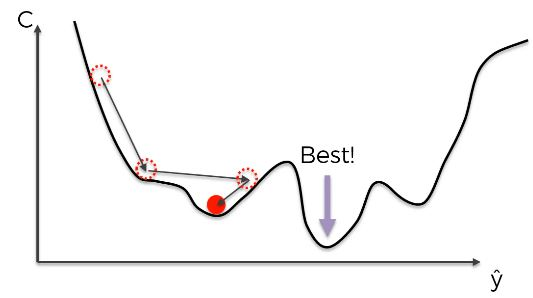</div>
<div>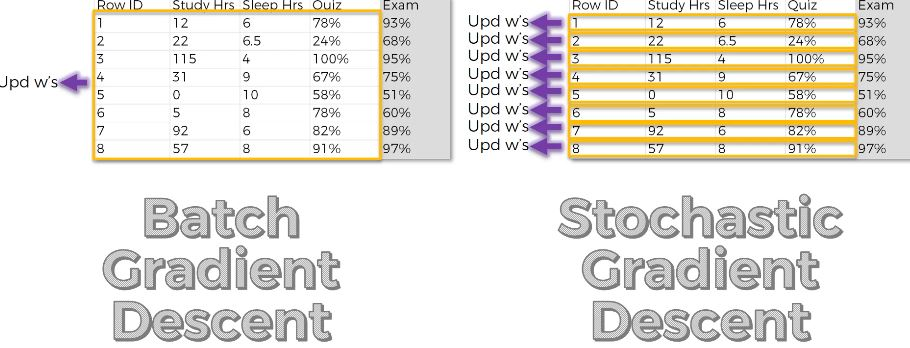</div>
<div>&nbsp;</div>
How does SGD work?

While the normal GD takes ALL the rows and feed it into the NN, SGD will take each row one by one, feed into the model to adjust the weights, then take the next row and repeat. In SGD, we are adjusting the weights after every single row rather than doing everything together. The normal GD is called **batch gradient descent** while the per row method is SGD.

SGD does one row at a time so the fluctuations are much higher, and hence it is much likelier to find the global minimum rather than the local minimum. It is also faster than BGD as it doesn't need to load up all the data into memory and run them all together.

BGD is better in one way as it is deterministic - if you start with the same starting weights, it will always give you the same results. But SGD is stochastic and is more random - you are picking your rows at random and updating the NN such that with the different process and iterations you will end with different results.

There is a hybrid version called the **mini batch gradient descent method** which is running 5, 10, 15 etc rows each time only. 

Read more about gradient descents [here](https://iamtrask.github.io/2015/07/27/python-network-part2/). Or for the heavy math read [here](http://neuralnetworksanddeeplearning.com/chap2.html), entire book [here](http://neuralnetworksanddeeplearning.com/index.html).

### Backpropagation

Backpropagation actually adjusts ALL the weights SIMULTANEOUSLY, not one by one. This means that **it knows which part of the error each of the weights is responsible for**.

### Method

- Step 1: Randomly initialise the weights to small numbers close to 0 but not 0.
- Step 2: Input the first observation in the input layer, each feature in one input node.
- Step 3: Forward propagation. Calculate the predicted result y-hat.
- Step 4: Compare with actual result y. Measure the generated error.
- Step 5: Back propagation. The error is backpropagated. Update the weights according to how much they are responsible for the error. The **learning rate** decides by how much we update the weights.
- Step 6: Repeat all and either: (i) update the weights after each observation for *reinforcement learning with SGD*, or (ii) update the weights only after a batch of observations for *batch learning with BGD*.
- Step 7: When the whole training set passes through the ANN, that makes an **epoch**. Redo more epochs.

**NOTE:** MUST do feature scaling for ALL types of deep learning, even if it's already 0 and 1. Only for the X's not Y.

In [29]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
print(tf.__version__)

### 2. Dataset

# Actual
data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/zzDataSets/Churn_Modelling.csv")
X = data.iloc[:,3:-1].values # correct version actually
Y = data.iloc[:,-1].values

# Preprocessing
from sklearn.preprocessing import LabelEncoder # 1s & 0s for Gender
le = LabelEncoder()
X[:,2] = le.fit_transform(X[:,2])

from sklearn.compose import ColumnTransformer # one-hot encoding Country
from sklearn.preprocessing import OneHotEncoder
ct = ColumnTransformer(transformers=[('encoder',OneHotEncoder(),[1])], remainder="passthrough") # create new object / instance of the CT class
X = np.array(ct.fit_transform(X)) # fit and transform together. returns DF, so must make it array again.

# Train Test Split

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

# Feature Scaling

from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
X_train = sc_X.fit_transform(X_train)
X_test = sc_X.transform(X_test)

### 3. Modelling

# Build
ann = tf.keras.models.Sequential() # keras built in TF2
ann.add(tf.keras.layers.Dense(units=6, activation='relu')) # input layer
ann.add(tf.keras.layers.Dense(units=6, activation='relu')) # hidden layer 1
ann.add(tf.keras.layers.Dense(units=1, activation='sigmoid')) # output layer

# Compile
ann.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy']) # for binary classification you must always do binary_crossentropy - if nonbinary then categorical_crossentropy with the output layer activation as 'softmax'

# Train
ann.fit(X_train, Y_train, batch_size=32, epochs=100) # batchsize gives exactly the no. of predictions you want in the batch to be compared to that same number of real results, usually 32. since batchsize != 1, means we are doing mini-batch SGD

### 4. Predictions

ann.predict(sc_X.transform([[1,0,0,600,1,40,3,60000,2,1,1,50000]]))

y_pred = ann.predict(X_test)
y_pred = (y_pred > 0.5) # turn it into 0 and 1
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

2.2.0
Epoch 1/100
250/250 [==============================] - 0s 495us/step - loss: 0.5338 - accuracy: 0.7960
Epoch 2/100
250/250 [==============================] - 0s 507us/step - loss: 0.4605 - accuracy: 0.7960
Epoch 3/100
250/250 [==============================] - 0s 499us/step - loss: 0.4378 - accuracy: 0.7989
Epoch 4/100
250/250 [==============================] - 0s 507us/step - loss: 0.4298 - accuracy: 0.8037
Epoch 5/100
250/250 [==============================] - 0s 507us/step - loss: 0.4262 - accuracy: 0.8085
Epoch 6/100
250/250 [==============================] - 0s 589us/step - loss: 0.4233 - accuracy: 0.8111
Epoch 7/100
250/250 [==============================] - 0s 624us/step - loss: 0.4211 - accuracy: 0.8156
Epoch 8/100
250/250 [==============================] - 0s 538us/step - loss: 0.4186 - accuracy: 0.8164
Epoch 9/100
250/250 [==============================] - 0s 530us/step - loss: 0.4169 - accuracy: 0.8184
Epoch 10/100
250/250 [==============================] - 0s 539us/st

# Chapter 22 - Convolutional Neural Network (CNN)

Everything below you can also read [here](https://www.superdatascience.com/blogs/the-ultimate-guide-to-convolutional-neural-networks-cnn).

<div>&nbsp;</div>
<div>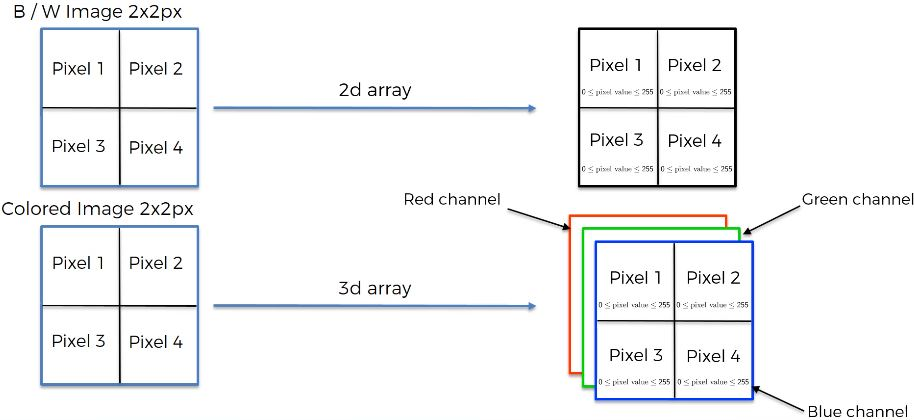</div>

CNN consists of 4 steps: convolution > max pooling > flattening > full connection.

### Convolution

<div>&nbsp;</div>
<div>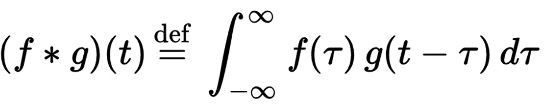</div>

For the math part, can read [here](https://cs.nju.edu.cn/wujx/paper/CNN.pdf).

The first thing to note is the use of **feature detectors** which can come in 3x3, 5x5, 7x7 and more. It is usually 3x3. Its other names include **kernel or filter**. Putting this feature detector on the input image, you do some maths like **element-wise multiplication** (input image's square * feature detector's square) and sum all the 9 results here, and the result appears on the **feature map / convolved feature**.

<div>&nbsp;</div>
<div>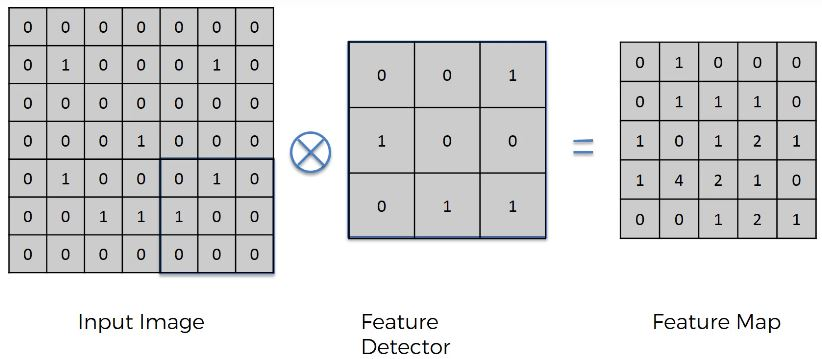</div>

The end result is that the image is reduced. The **stride** makes it even smaller; the bigger the stride, the smaller the image. A smaller image is easier to process and faster. If stride=1 then move filter 1 pixel at a time, if stride=2 move filter 2 pixels at a time.

Doing so also makes you lose information - but when doing CNN you are finding important patterns / features. The highest number in the feature map is where that pattern matches up with the feature detector, ie the "4" is where the input image best matches the feature detector. Hence we do not mind "losing information" because our main aim is to find the features that we are looking for only.

<div>&nbsp;</div>
<div>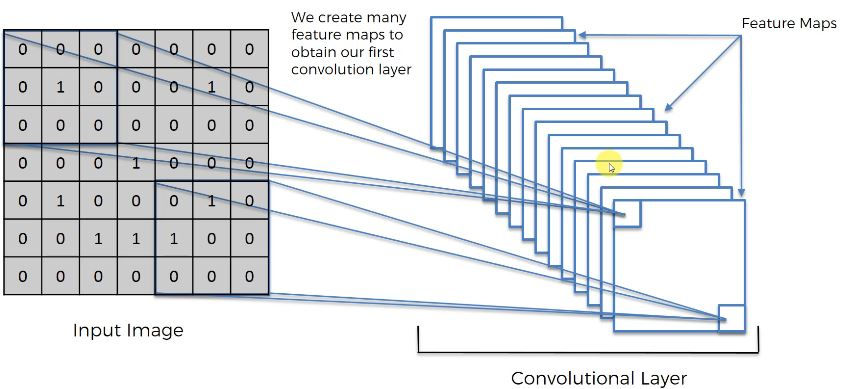</div>

This process is repeated using different feature maps, each finding its own thing. The CNN decides through its training to figure out which features are important and so looks for them.

<div>&nbsp;</div>
<div>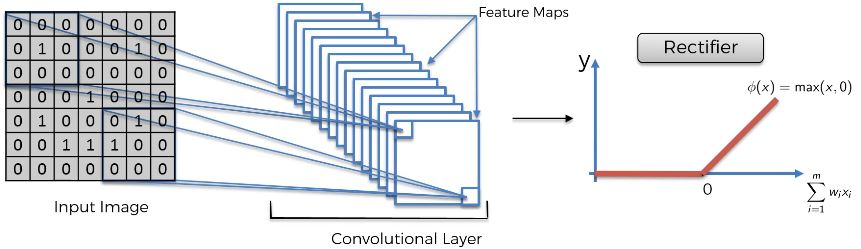</div>

After getting the convolutional layer as above, you apply the rectifier reLU function. This is to increase nonlinearity in our CNN. Pictures normally are nonlinear because each object has its own borders / colours etc and the transition of pixels from each object is nonlinear. Using convolution risks creating something linear so we need to break it up if so.

<div>&nbsp;</div>
<div>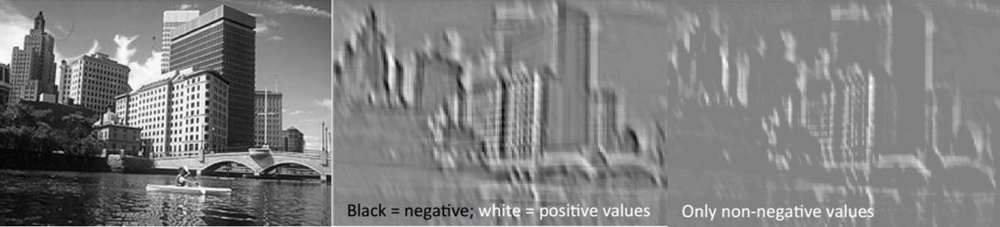</div>

For example, the middle picture's white-grey-black linearity is broken up by removing the black. There is only white and grey left; there is an abrupt change.

**NOTE:** You can also use the **parametric ReLU (PReLU)** as well which some people claim is a better ReLU.

### Max Pooling

If I flip an image, then by right the pattern would not match and it will be seen as a different image when actually it is the same thing. That is why we must ensure our NN has **spatial invariance** meaning that it doesn't care if the features are slightly tilted, different in texture, closer / further / distorted, our NN must still find that feature. And that is what **max pooling** is about.

<div>&nbsp;</div>
<div>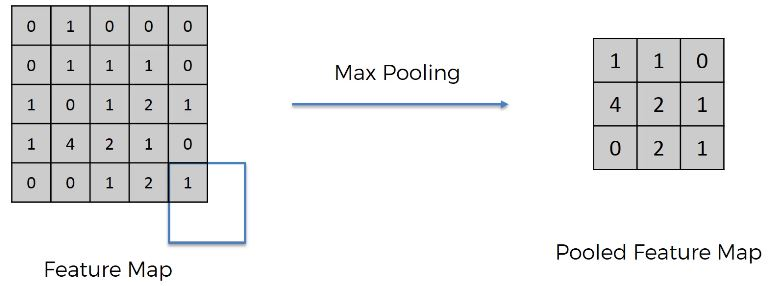</div>
<div>&nbsp;</div>
<div>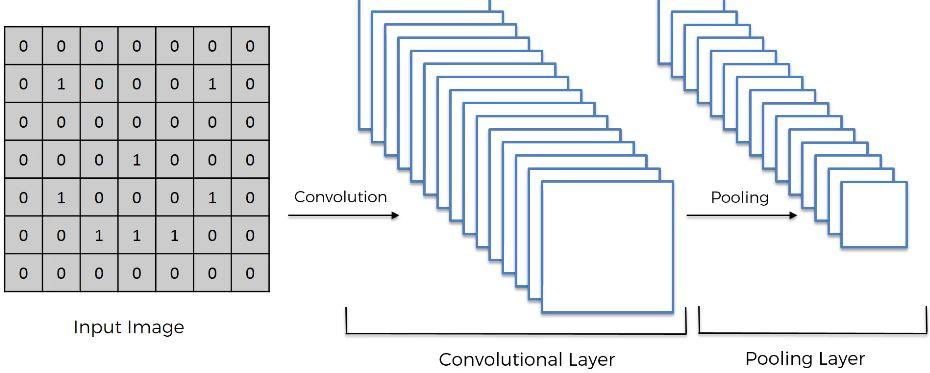</div>

Using the feature map, use a 2x2 (or any size) box, take the max, and place it into the pooled feature map. Then you move the box by a stride (here stride = 2) and do it again. It is okay if the box goes out of borders. All of these will form the **pooling layer**.

By doing this, we further reduce the info and even if there are distortions, the pooled feature map will still be the exact same. In essence, we still preserve the original features and still account for distortions and reduce the size which helps to prevent overfitting(! because the model does not train on everything but just these main big features).

There are also other pooling methods like mean pooling and sum pooling.

### Flattening

<div>&nbsp;</div>
<div>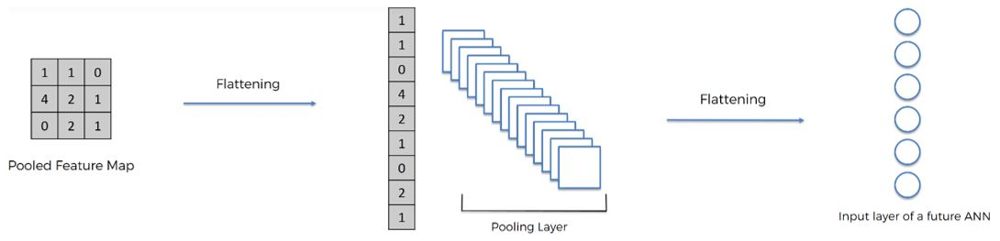</div>

Basically just turning the pooled feature map into a single column.

### Full Connection

<div>&nbsp;</div>
<div>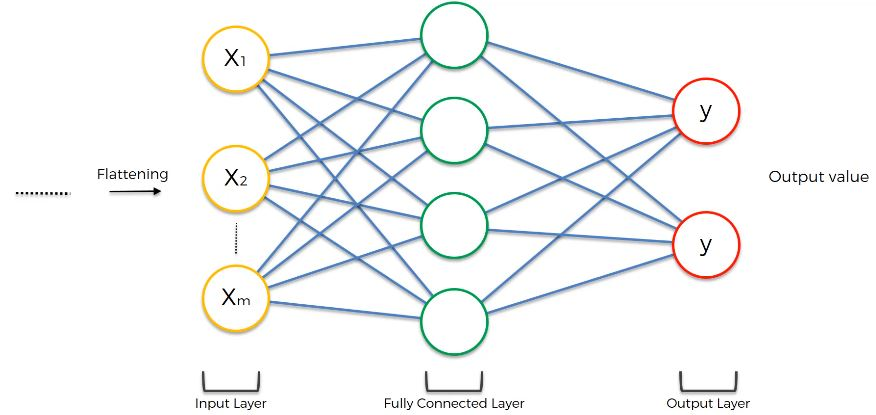</div>

Note: In ANN the hidden layers don't have to be fully connected (no need all the arrows), but for CNN MUST be fully connected.

<div>&nbsp;</div>
<div>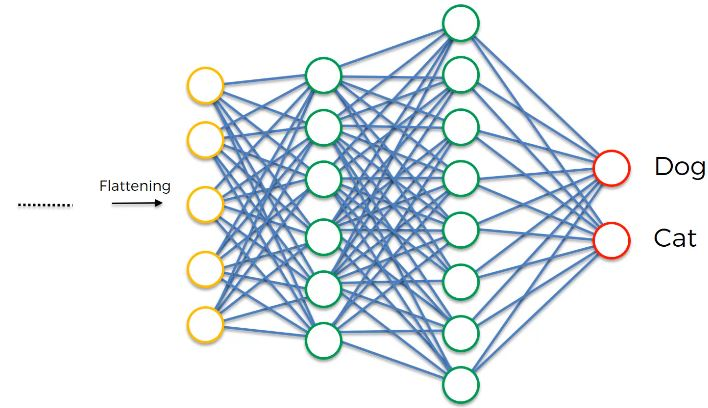</div>

Note 2: Also by right since dog vs cat is 2 categories, the output layer can be just 1. But it can also be 2.

For CNN, the same thing happens except that the cost function is called the **loss function** which is measured by the **cross-entropy function**. We then backpropagate and adjust the weights AND the feature detectors as well to see what happens. Repeat many times.

<div>&nbsp;</div>
<div>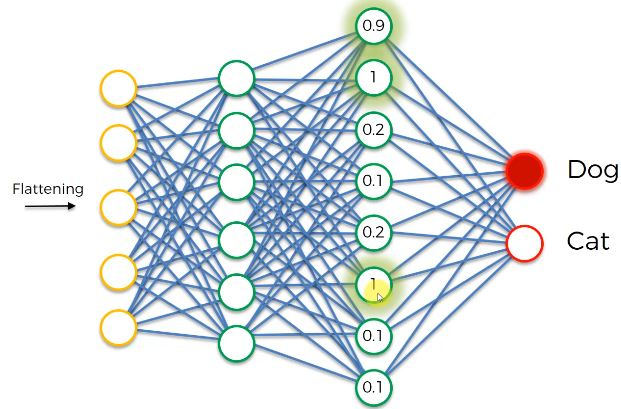</div>

Remember that we are working with FULLY CONNECTED neurons? This means that the number calculated within each neuron means the higher they are, the more confident they have detected a feature. Over many iterations, if the same nodes are firing up often and contributes to saying it is a dog and it indeed matches the actual result, then the model will remember and assign heavier weights for the edges between those nodes and the dog output layer. If not, lower weights.

<div>&nbsp;</div>
<div>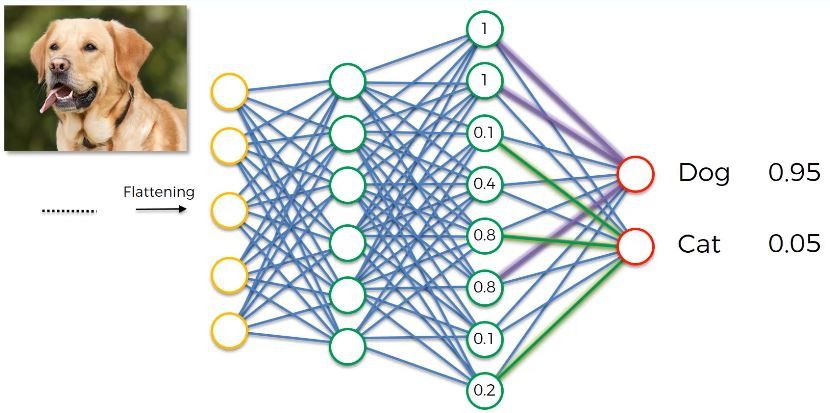</div>

Therefore in the future when a similar picture is fed, the dog or cat nodes will see the few nodes that it listens to and see which lights up. Some will, and some won't. It will then assign a probability based on which nodes light up.

### Softmax & Cross-Entropy

<div>&nbsp;</div>
<div>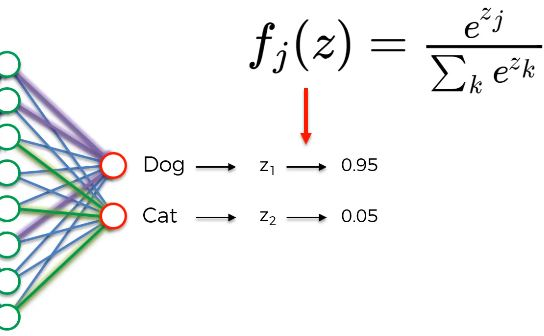</div>

In a normal ANN, the output layer(s) all give out a value that may not add up to 1. So it is not useful. Thus we apply **softmax** and it'll transform all these values and make them total to 1 so you know which one has higher votes. It is highly related to the cross-entropy function.

<div>&nbsp;</div>
<div>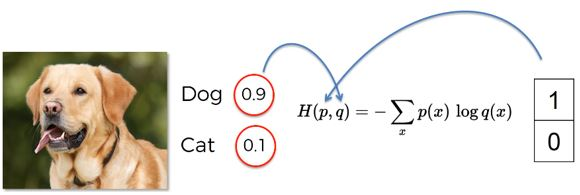</div>
<div>&nbsp;</div>
<div>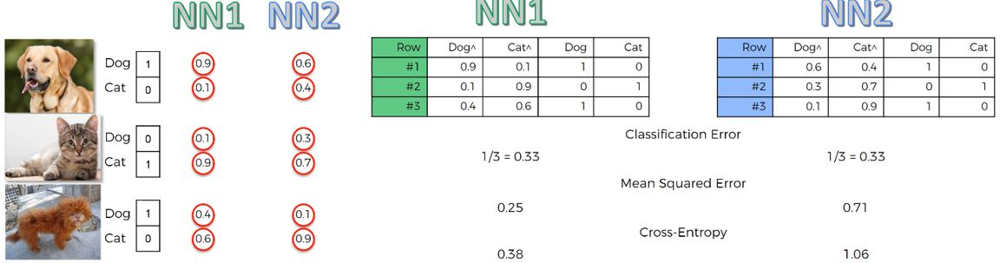</div>

Cross-entropy function is highly useful for CNNs. While other ANNs use MSE or cost functions, CNNs use loss functions. Basically we reduce as must cross-entropy to improve the model.

NN1 is always outperforming NN2, even though both wrong for the 3rd entry. If you use classification error, they both seem to be the same. If you use MSE, NN1 is better. If you use cross-entropy which is easier to calculate, NN1 is better also. Cross-entropy is better than MSE because in the first rounds the backpropagation output is very extremely tiny, then the gradient descent is very low and the NN will find it difficult to start doing something with MSE but XE uses logarithms so can access small values like that and allows bigger jumps AKA is faster. But take note regression only use MSE and categorical can use XE cos of softmax.

In [79]:
### 1. Libraries

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator # for model to see pictures
print(tf.__version__)

### 2. Dataset

# Preprocess the Training Set (to prevent overfitting with test)
train_datagen = ImageDataGenerator( # image augmentation model
    rescale=1./255, # this is feature scaling
    shear_range=0.2,
    zoom_range=0.2, # zooms in
    horizontal_flip=True) # flip
training_set = train_datagen.flow_from_directory( # feed images into model
    'zzDataSets/dataset/training_set', # where you keep it
    target_size=(64,64), # final size of images to be fed into CNN
    batch_size=32, # no of images you want in each batch
    class_mode='binary') # binary of categorical

# Preprocess the Test Set (no augmentation other than feature scaling)
test_datagen = ImageDataGenerator(rescale=1./255)
test_set = train_datagen.flow_from_directory(
    'zzDataSets/dataset/test_set',
    target_size=(64,64), 
    batch_size=32,
    class_mode='binary')

### 3. Modelling

# Initialising
cnn = tf.keras.models.Sequential()

# Convolution
cnn.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=[64,64,3])) # filters = no. of feature detectors; kernelsize = size of each featuredetector; activation = activation function; input_shape = your image size (w,b,123) where 1 for B&W and 3 for colors

# Pooling
cnn.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2)) # poolsize = size of the pool filter; strides = no. of pixels to shift filter

# Second Convolutional Layer (convolution+pooling together)
cnn.add(tf.keras.layers.Conv2D(filters=32, kernel_size=3, activation='relu')) # no need input shape anymore. only do it once at start.
cnn.add(tf.keras.layers.MaxPool2D(pool_size=2, strides=2))

# Flattening
cnn.add(tf.keras.layers.Flatten())

# Full Connection
cnn.add(tf.keras.layers.Dense(units=128, activation='relu')) # more neurons since pictures need more

# Output Layer
cnn.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

# Compile
cnn.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Training on Train Set + Evaluating on Test Set
cnn.fit(x=training_set, validation_data=test_set, epochs=25)

### 4. Prediction

import numpy as np
from tensorflow.keras.preprocessing import image
test_image = image.load_img( # load images in PIL format
    'zzDataSets/dataset/single_prediction/cat_or_dog_1.jpg',
    target_size = (64,64)) # need to be same size
test_image = image.img_to_array(test_image) # converts from PIL format to array
test_image = np.expand_dims(test_image, axis=0) # since we did batchsize=32, we need to transform this to fit with an extra dimension; axis=0 something about batch as first dimension...
result = cnn.predict(test_image)
training_set.class_indices # to find out what is 0 and 1 (dog=1,cat=0)
if result[0][0] == 1:
    prediction = 'dog'
else:
    prediction = 'cat'
print(prediction)

2.2.0
Found 8000 images belonging to 2 classes.
Found 2000 images belonging to 2 classes.
Epoch 1/25
250/250 [==============================] - 33s 133ms/step - loss: 0.6539 - accuracy: 0.5990 - val_loss: 0.6116 - val_accuracy: 0.6700
Epoch 2/25
250/250 [==============================] - 33s 132ms/step - loss: 0.5862 - accuracy: 0.6923 - val_loss: 0.5524 - val_accuracy: 0.7190
Epoch 3/25
250/250 [==============================] - 33s 133ms/step - loss: 0.5560 - accuracy: 0.7160 - val_loss: 0.5395 - val_accuracy: 0.7225
Epoch 4/25
250/250 [==============================] - 33s 132ms/step - loss: 0.5320 - accuracy: 0.7340 - val_loss: 0.5371 - val_accuracy: 0.7355
Epoch 5/25
250/250 [==============================] - 33s 132ms/step - loss: 0.5123 - accuracy: 0.7425 - val_loss: 0.5210 - val_accuracy: 0.7315
Epoch 6/25
250/250 [==============================] - 33s 134ms/step - loss: 0.4943 - accuracy: 0.7625 - val_loss: 0.5115 - val_accuracy: 0.7565
Epoch 7/25
250/250 [====================

# Dimensionality Reduction

We can choose features either by (i) feature selection using things like backward elimination / forward selection / bidirectional elimination / score comparison taught in the regression chapter, or (ii) **feature extraction** with PCA / LDA / kernel PCA / quadratic discriminant analysis QDA.

# Chapter 23 - Principal Component Analysis (PCA)

This is an unsupervised learning algorithm which is popular for: noise filtering, visualisation, stock market predictions, gene data analysis, and feature extraction.

The goal is to identify patterns in data and **detect correlation between variables**. If there is strong correlation, can eliminate it. Hence it reduces the dimensions of a d-dimensional dataset by projecting it onto a k-dimensional subspace where k < d.

Steps:
- Standardise the data.
- Obtain the **Eigenvectors and Eigenvalues** from the covariance matrix / correlation matrix, or perform Singular Vector Decomposition.
- Sort eigenvalues in descending order and choose the *k* eigenvectors that correspond to the *k* largest eigenvalues where *k* is the number of dimensions of the new feature subspace (k <= d).
- Construct the projection matrix **W** from the selected *k* eigenvectors.
- Transform the original dataset **X** via **W** to obtain a k-dimensional feature subspace **Y**.

The pros are that it can find relationship between X and Y values, and find the list of principal axes. The cons are that it is very affected by outliers. But considered very popular.

More [here](https://towardsdatascience.com/a-one-stop-shop-for-principal-component-analysis-5582fb7e0a9c) and [especially here](https://www.youtube.com/watch?v=FgakZw6K1QQ).

### Pictorial Explanation

That arrow is **eigenvector**.
The value of SS(distance) is **eigenvalue**.
The coefficients of features are **loading scores**.
The **variation** for each PC can be calculated as %. This can be represented on a **scree plot** as well.

<div>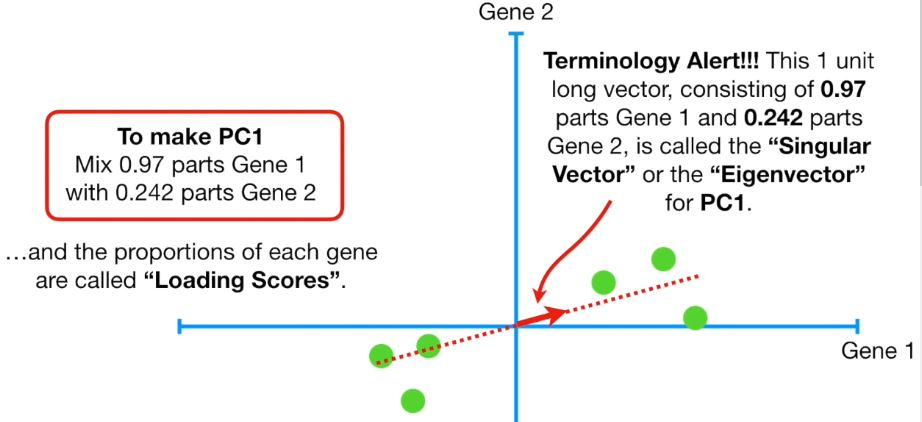</div>
<div>&nbsp;</div>
<div>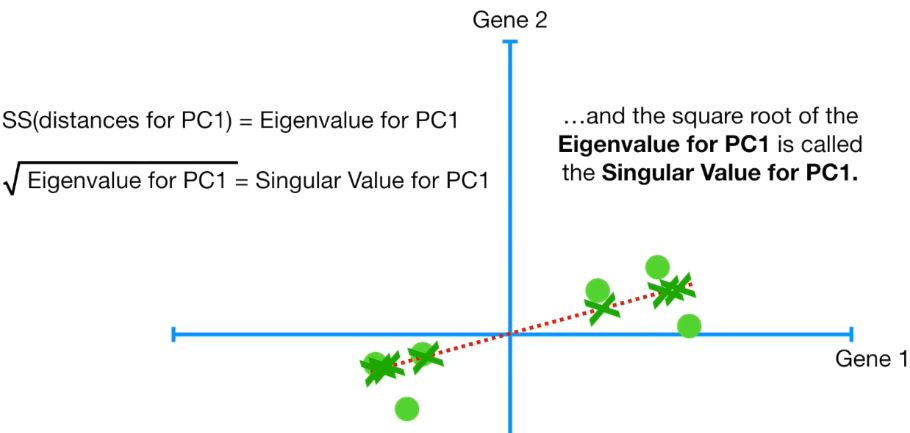</div>
<div>&nbsp;</div>
<div>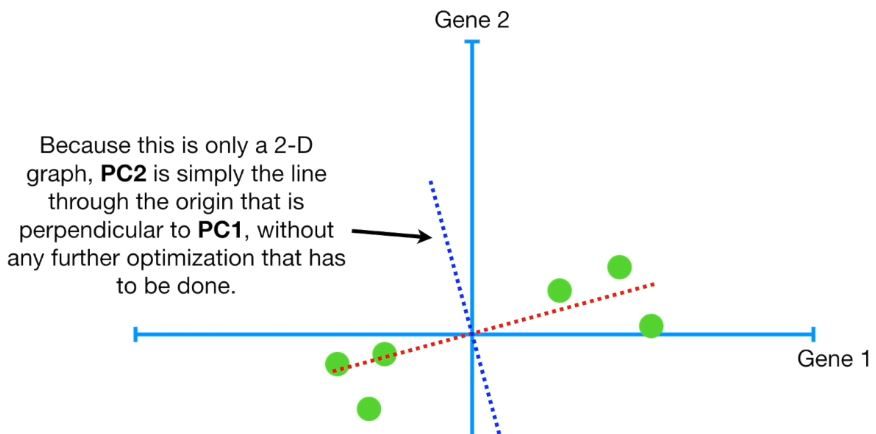</div>
<div>&nbsp;</div>
<div>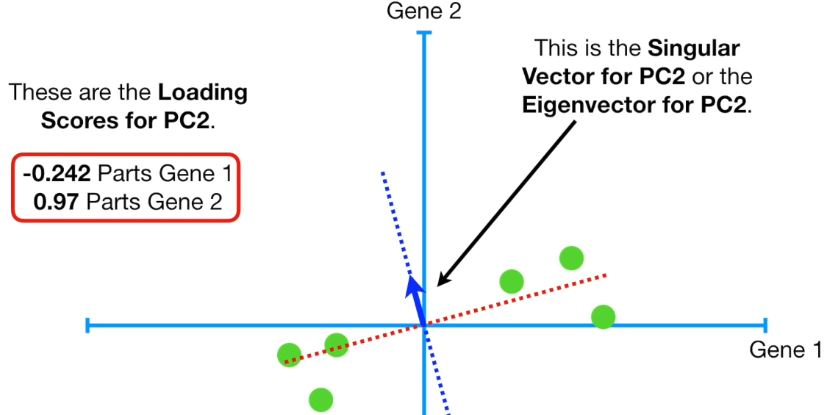</div>
<div>&nbsp;</div>
<div>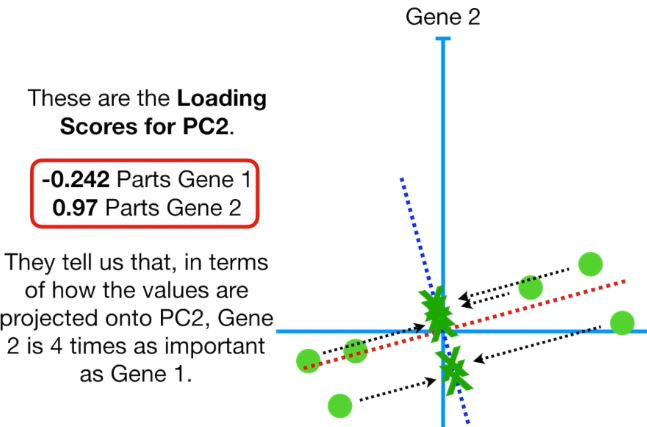</div>
<div>&nbsp;</div>
<div>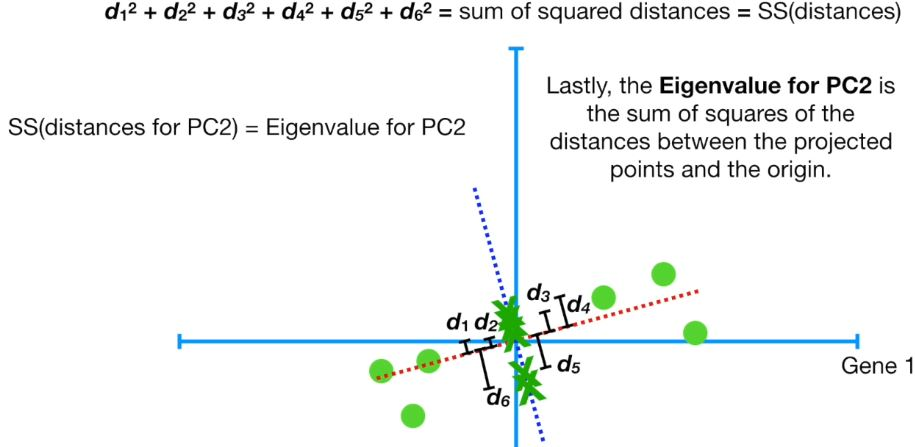</div>
<div>&nbsp;</div>
<div>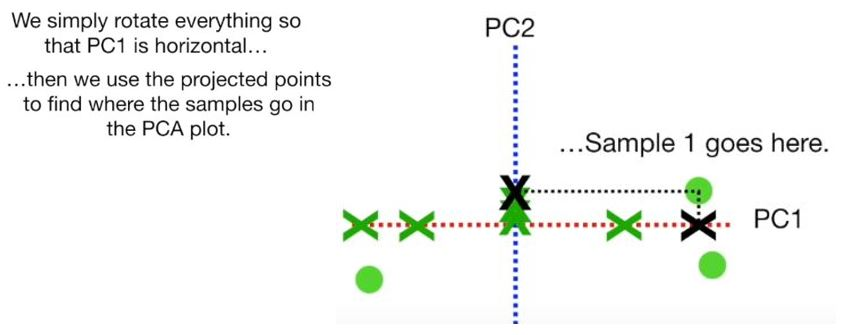</div>
<div>&nbsp;</div>
<div>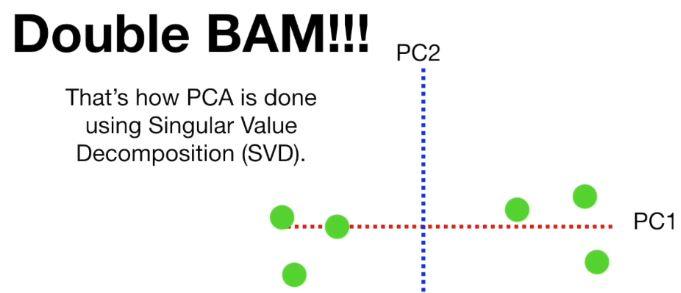</div>
<div>&nbsp;</div>
<div>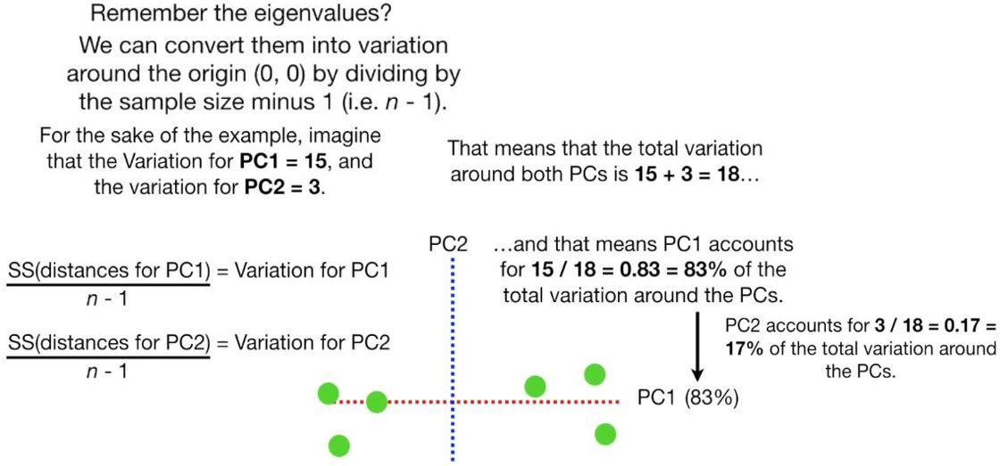</div>
<div>&nbsp;</div>
<div>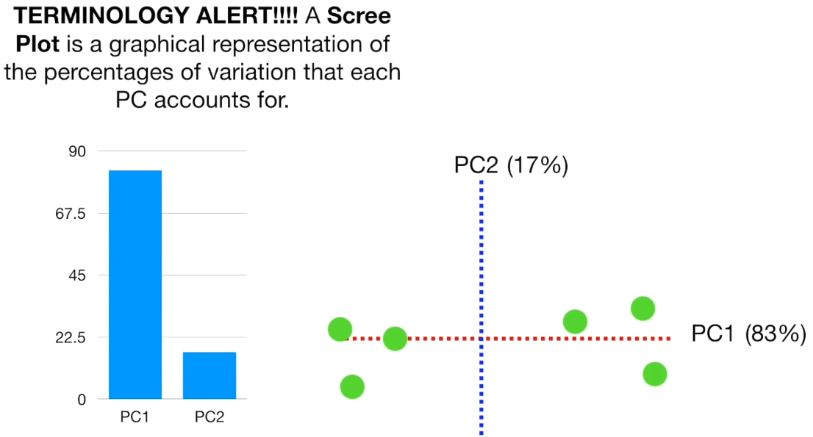</div>
<div>&nbsp;</div>

But when you go into 3 or more features, even though you may not be able to visualise, you can just plot the scree graph and choose those PC that account for most of the total variation. These are the important ones.

<div>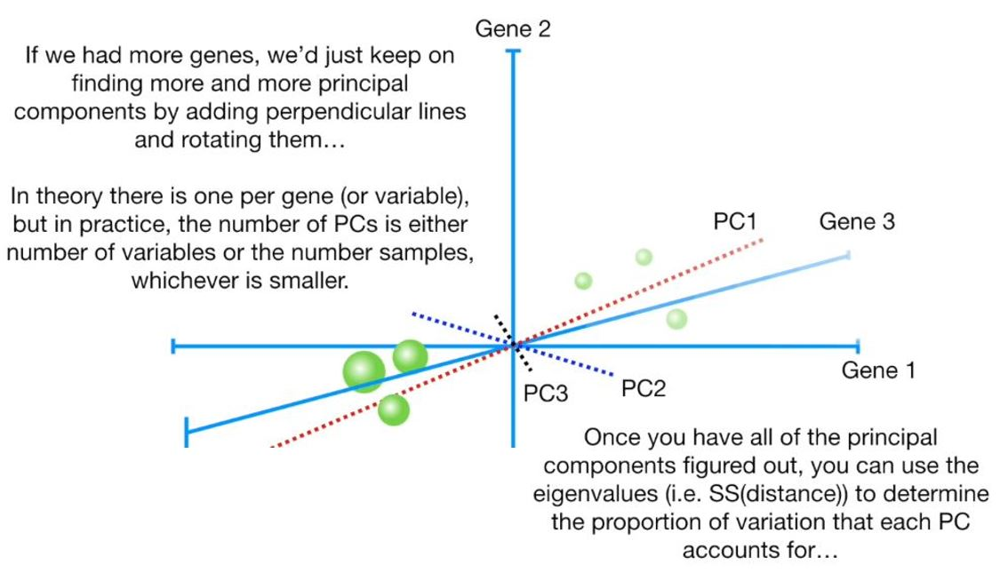</div>
<div>&nbsp;</div>
<div>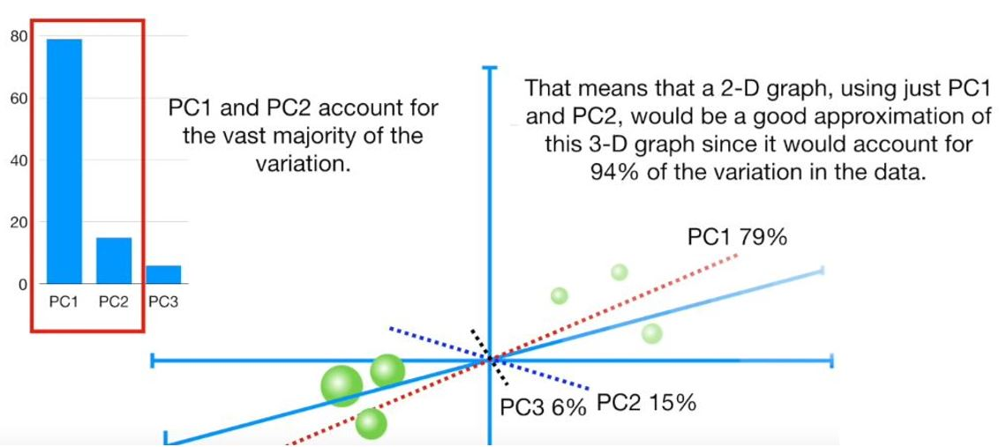</div>
<div>&nbsp;</div>
<div>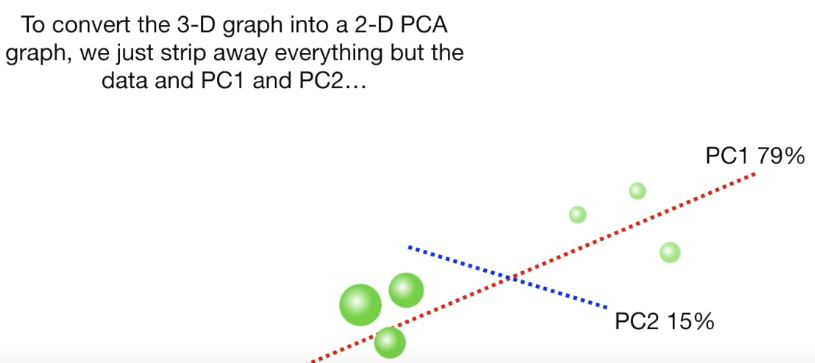</div>
<div>&nbsp;</div>
<div>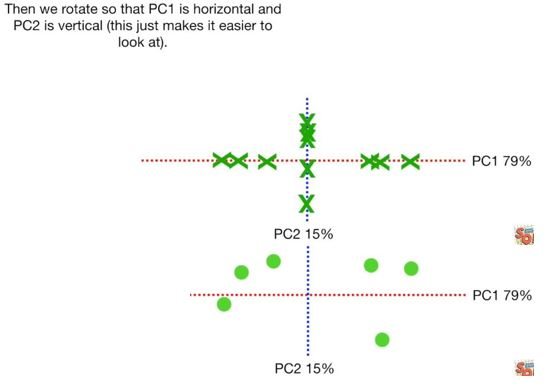</div>
<div>&nbsp;</div>

**NOTE:** We are NOT reducing the number of features to select. Rather we will use all the features to create 2 NEW FEATURES called PC1 and PC2, and then plot from there.

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[[1 1]
 [3 3]
 [2 2]
 [1 1]
 [2 2]
 [1 2]
 [1 1]
 [3 3]]
[[14  0  0]
 [ 1 15  0]
 [ 0  0  6]] 0.9722222222222222


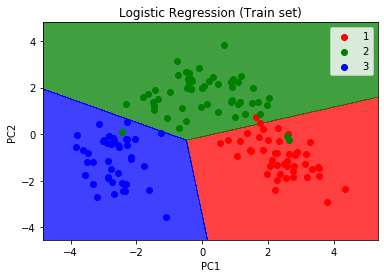

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


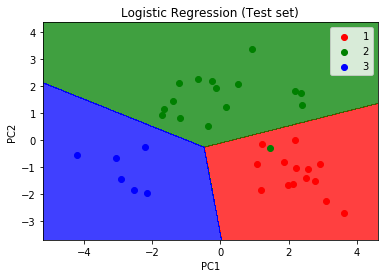

In [7]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd

### 2. Dataset

data = pd.read_csv("zzDatasets/Wine.csv")
X = data.iloc[:,:-1].values 
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Apply PCA

from sklearn.decomposition import PCA
pca = PCA(n_components=2) # no. of final extracted features
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

### 4. Modelling (we use LogReg here but can use any classifier)

from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state=0)
classifier.fit(X_train, Y_train) # smaller the C, stronger the regularisation, lesser the overfitting

### 5. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 6. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 7. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = X_train, Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green','blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Train set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = X_test, Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green', 'blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Test set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

# Chapter 24 - Linear Discriminant Analysis (LDA)

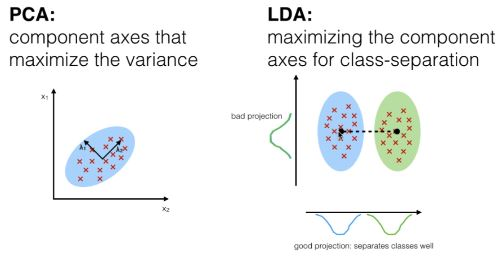

LDA is similar to PCA, but it differs because in addition to finding the component axes with LDA, we are also interested in the axes that **maximise the separation between multiple classes**. The goal of LDA is to project a feature space of n-dimensions onto a smaller subspace of k-dimensions while maintaining the class-discriminatory information.

PCA is unsupervised by LDA is supervised because of the relation to the dependent variable.

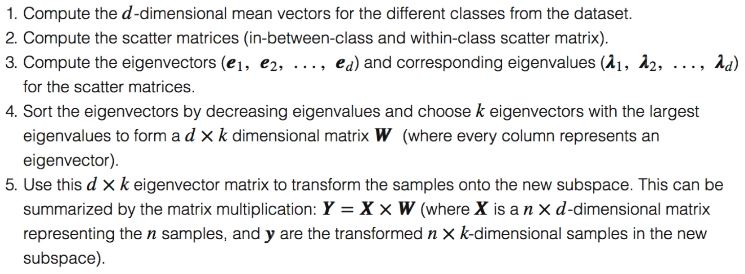

[[1 1]
 [3 3]
 [2 2]
 [1 1]
 [2 2]
 [2 2]
 [1 1]
 [3 3]]
[[14  0  0]
 [ 0 16  0]
 [ 0  0  6]] 1.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


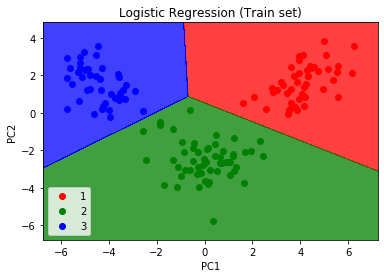

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


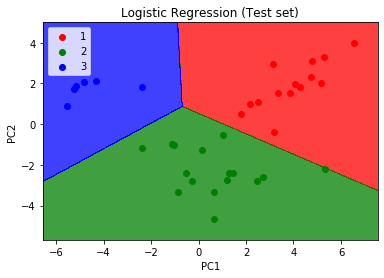

In [9]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd

### 2. Dataset

data = pd.read_csv("zzDatasets/Wine.csv")
X = data.iloc[:,:-1].values 
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Apply LDA

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda = LinearDiscriminantAnalysis(n_components=2)
X_train = lda.fit_transform(X_train, Y_train) # remember need the Y!
X_test = lda.transform(X_test)

### 4. Modelling (we use LogReg here but can use any classifier)

from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state=0)
classifier.fit(X_train, Y_train) # smaller the C, stronger the regularisation, lesser the overfitting

### 5. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 6. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 7. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = X_train, Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green','blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Train set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = X_test, Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green', 'blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Test set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

# Chapter 25 - Kernel PCA

Basically PCA but with kernel trick: we map the data to a higher dimension to extract new principal components. Remember that at this higher dimension, our dataset is now linearly separable (previously was not - imagine green data surrounded by red data in a circle). Better at dealing with nonlinear datasets.

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[[1 1]
 [3 3]
 [2 2]
 [1 1]
 [2 2]
 [2 2]
 [1 1]
 [3 3]]
[[14  0  0]
 [ 0 16  0]
 [ 0  0  6]] 1.0


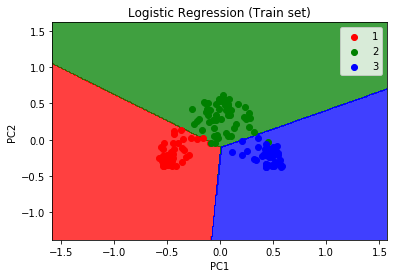

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


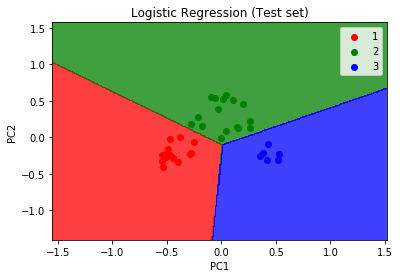

In [11]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd

### 2. Dataset

data = pd.read_csv("zzDatasets/Wine.csv")
X = data.iloc[:,:-1].values 
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Apply PCA

from sklearn.decomposition import KernelPCA
kpca = KernelPCA(n_components=2, kernel='rbf') # no. of final extracted features
X_train = kpca.fit_transform(X_train)
X_test = kpca.transform(X_test)

### 4. Modelling (we use LogReg here but can use any classifier)

from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state=0)
classifier.fit(X_train, Y_train) # smaller the C, stronger the regularisation, lesser the overfitting

### 5. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 6. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 7. Visualisations

from matplotlib.colors import ListedColormap
X_set, y_set = X_train, Y_train
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green','blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Train set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

from matplotlib.colors import ListedColormap
X_set, y_set = X_test, Y_test
X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 1, stop = X_set[:, 0].max() + 1, step = 0.01),
                     np.arange(start = X_set[:, 1].min() - 1, stop = X_set[:, 1].max() + 1, step = 0.01))
plt.contourf(X1, X2, classifier.predict(np.array([X1.ravel(), X2.ravel()]).T).reshape(X1.shape),
             alpha = 0.75, cmap = ListedColormap(('red', 'green', 'blue')))
plt.xlim(X1.min(), X1.max())
plt.ylim(X2.min(), X2.max())
for i, j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1], c = ListedColormap(('red', 'green', 'blue'))(i), label = j)
plt.title('Logistic Regression (Test set)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

# Chapter 26 - Model Selection

## K-Fold Cross Validation

<div>&nbsp;</div>
<div>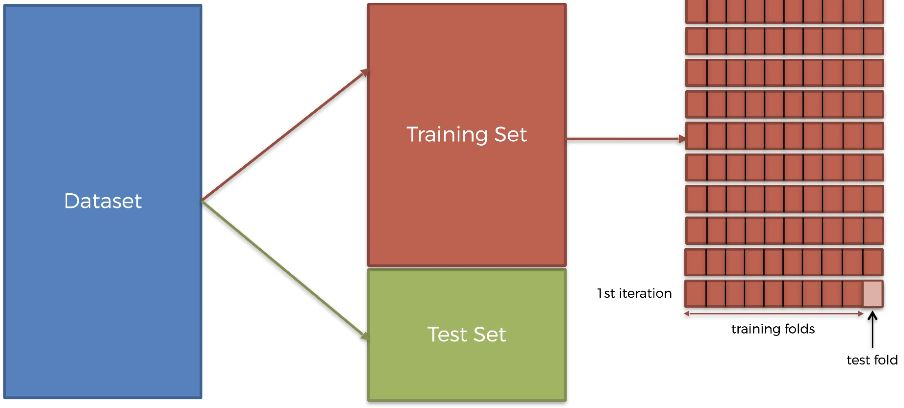</div>

The best way to measure the performance of your model either via accuracy (classification) or RMSE (regression).

It creates a certain number of trained test folds (default 10) on which you will train your ML model on each of the trained fold and at the same time test it separately on the test fold.

Since you have 10 trained test folds, you will end up with 10 different accuracies on different test sets. The end result will be the average of these tests. This is better as it ensures you don't get lucky on one test set.

## Grid Search

To find the best hyperparameters.

Note that for EACH run of the hyperparameters, we will apply K-fold CV each time.

In [18]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("C:/Users/jrado/Desktop/Hackwagon/Udemy Course/SuperDataScienceML/03 Classification/Social_Network_Ads.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.25, random_state=0)

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

### 3. Modelling

from sklearn.svm import SVC
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train,Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Applying K-Fold Cross Validation

from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator=classifier, X=X_train, y=Y_train, cv=10) # estimator is the model name; cv is the no. of folds you want
print(accuracies)
print("Accuracy: {:.2f}%".format(accuracies.mean()*100))
print("Standard Deviation: {:.2f}%".format(accuracies.std()*100)) # get std deviation becos getting results like 84,98,83,97 vs 94,93,94,93 is v different 

### 7. Grid Search
# go to sklearn website to see what parameters even exist

from sklearn.model_selection import GridSearchCV
parameters = [
    {'C': [0.25, 0.5, 0.75, 1], 'kernel': ['linear']},
    {'C': [0.25, 0.5, 0.75, 1], 'kernel': ['rbf'], 'gamma': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]}
              ] # the ones you want to test. 2 dicts becos the linear version cannot use gamma, if not usually just 1 dict
grid_search = GridSearchCV(estimator = classifier, # estimator is your model
                          param_grid = parameters,
                          scoring = 'accuracy', # scoring is the metric used to evaluate the model performance for each of the combinations of hyperparameter values, accuracy since classification
                          cv = 10,
                          n_jobs = -1) # use all your processors since if not it'll take too long 
grid_search.fit(X_train, Y_train)
best_accuracy = grid_search.best_score_ # to see which is best accuracy
best_parameters = grid_search.best_params_ # and best parameters
print("Accuracy: {:.2f}%".format(best_accuracy*100))
print("Best Parameters:", best_parameters)

[[0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [0 0]
 [1 1]]
[[64  4]
 [ 3 29]] 0.93
[0.8        0.96666667 0.8        0.96666667 0.86666667 0.86666667
 0.9        0.93333333 1.         0.93333333]
Accuracy: 90.33%
Standard Deviation: 6.57%
Accuracy: 90.67%
Best Parameters: {'C': 0.5, 'gamma': 0.6, 'kernel': 'rbf'}


# Chapter 27 - XGBoost

Can be used for both regression and classification.

In [25]:
### 1. Libraries

import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv("zzDatasets/Data.csv")
X = data.iloc[:,:-1].values
Y = data.iloc[:,-1].values 

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)

### 3. Modelling

from xgboost import XGBClassifier # if regression use XGBRegression
classifier = XGBClassifier() # actually not much to tune since the defaults usually works well
classifier.fit(X_train, Y_train)

### 4. Predictions

y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), Y_test.reshape(len(Y_test),1)),1)[:8])

### 5. Confusion Matrix

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(Y_test, y_pred)

from sklearn.metrics import accuracy_score
ac = accuracy_score(Y_test, y_pred)
print(cm,ac)

### 6. Applying K-Fold Cross Validation

from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator=classifier, X=X_train, y=Y_train, cv=10)
print(accuracies)
print("Accuracy: {:.2f}%".format(accuracies.mean()*100))
print("Standard Deviation: {:.2f}%".format(accuracies.std()*100)) 

[[2 2]
 [2 2]
 [4 4]
 [4 4]
 [2 2]
 [2 2]
 [2 2]
 [4 4]]
[[84  3]
 [ 0 50]] 0.9781021897810219
[0.92727273 0.96363636 0.96363636 0.98181818 0.94545455 0.98181818
 0.94444444 0.98148148 1.         0.96296296]
Accuracy: 96.53%
Standard Deviation: 2.07%


# Back to Deep Learning
<div>&nbsp;</div>
<div>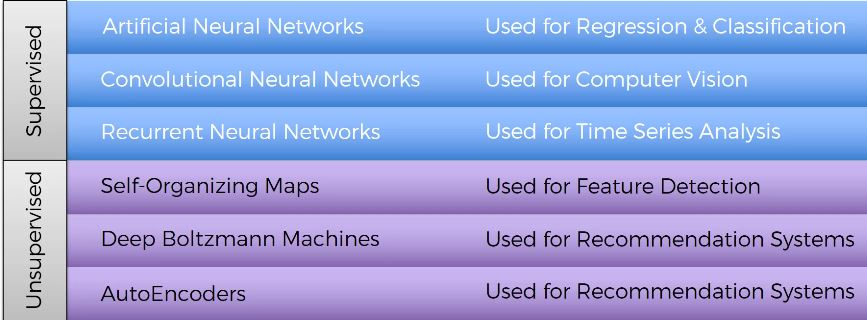</div>

# Chapter 28 - Recurrent Neural Network (RNN)

Probably can read [here](https://www.superdatascience.com/blogs/the-ultimate-guide-to-recurrent-neural-networks-rnn).

The key thing about ANN are the weights that represent long-term memory, where the weights are memorised forever and no matter when you run it, it'll always be the same. OTOH, **RNNs are about short-term memory**.

For general ANNs, it is assumed that [successive inputs are independent of each other. This is not true for RNN's sequential data](https://towardsdatascience.com/understanding-neural-networks-from-neuron-to-rnn-cnn-and-deep-learning-cd88e90e0a90).

So as below, we take the original ANN, squash it into a single line, flip it to vertical, and then change the middle part to feedback into itself. 

<div>&nbsp;</div>
<div>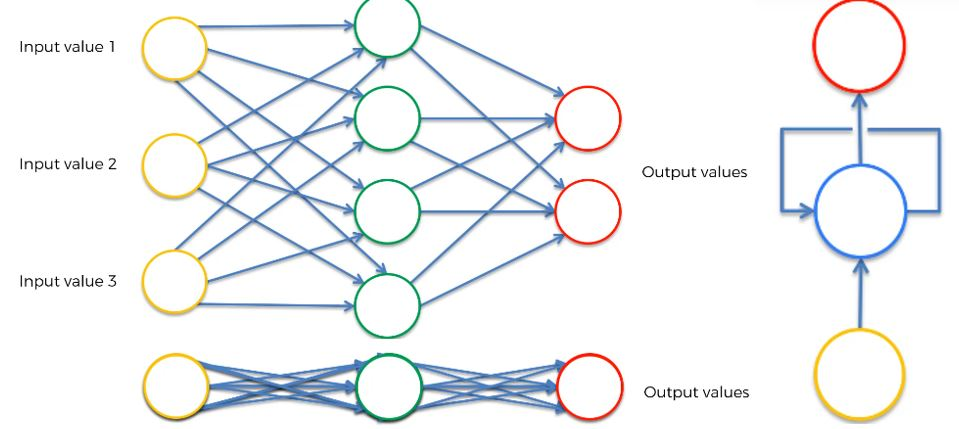</div>

As below, the RNN is normally represented on the left, but actually is the one on the right. Each circle is actually a whole layer of neurons. But we want to visualise simplicity. Hence, the neurons are connecting to themselves through time; they have some sort of memory (short-term memory) that remembers what was in that neuron just previously. This allows them to pass information to themselves in the future and analyse things. See [here for more information](https://machinelearningmastery.com/rnn-unrolling/) and also [here for beginner version](https://towardsdatascience.com/rnn-simplified-a-beginners-guide-cf3ae1a8895b) or a [simplified video version](https://www.youtube.com/watch?v=UNmqTiOnRfg). Also **important to note that the sequential units are the same unit at different points of time and are not cascading units**.

**BIG NOTE:** Remember prof drew that picture with the squares? Each layer in the Udemy picture is each square / layer in prof's pic.

<div>&nbsp;</div>
<div>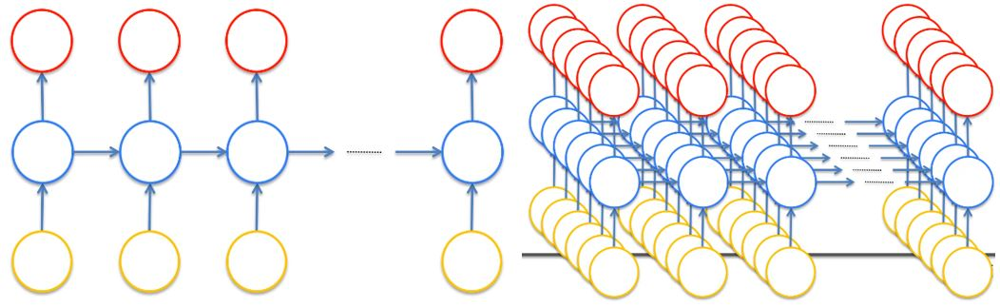</div>

<div>&nbsp;</div>
<div>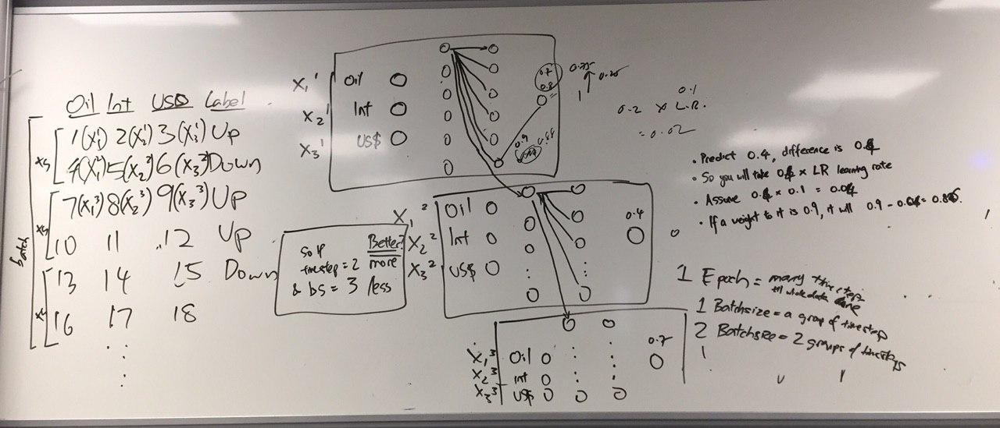</div>

<div>&nbsp;</div>
<div>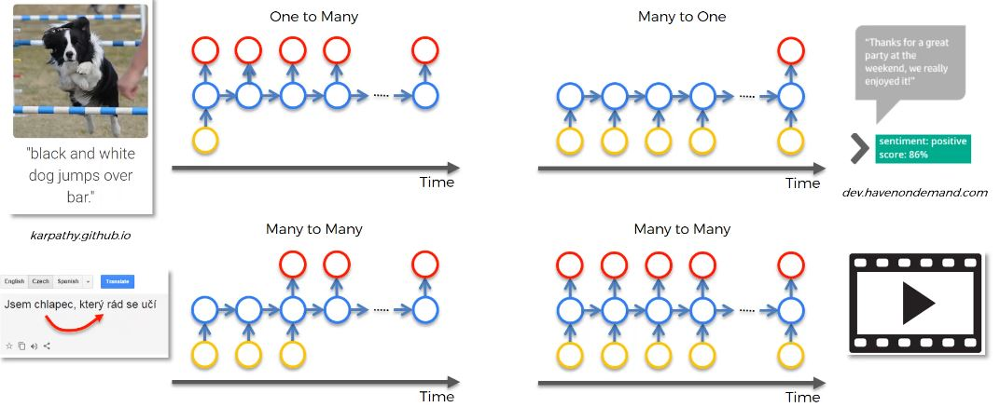</div>

As above, there are one-to-many relationships (one input multiple outputs, ie one picture many words describing it), many-to-one relationships (many inputs to one output, ie many texts to one binary outcome), and many-to-many (many inputs to many outputs, ie translate many words to many words).

### Vanishing Gradient

This is a problem inherent in RNNs.

During training, each layer will calculate the error / cost function. How do you backpropagate then? Also the more **time steps** you take the longer.

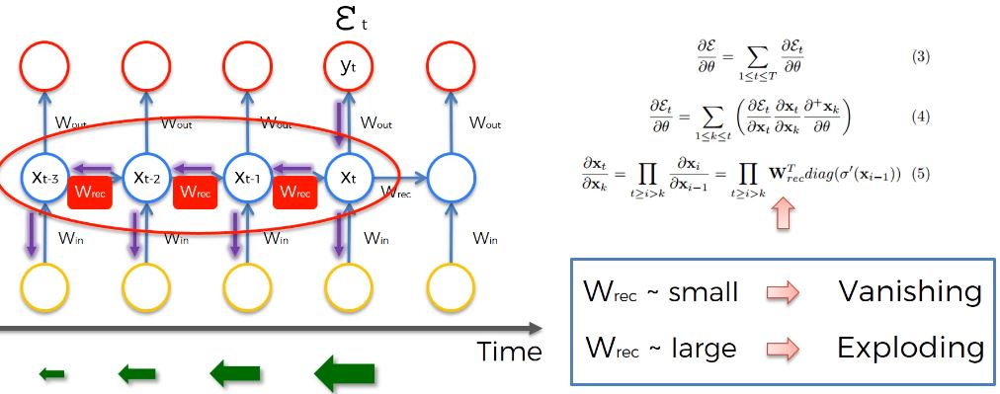

Ignore the math. But the **Wrec** connects the hidden layers to themselves  in the unrolled temporal loop. To get from X(t-3) to X(t-2), we must multiply by Wrec. And because we keep multiplying many times by this small number, the value decreases very quickly. This means the gradient becomes lesser and this vanishing gradient, the harder it is for the network to update the weights, it is slower. Basically the weights in the earlier layers are updated slower, and therefore by the end of 1000 epochs you may not have the final results there and the nodes are left not very trained. But remember when you front propagate back, the untrained layers have to train the future layers so it becomes a vicious cycle. *Not sure what is happening? Me too.*

Some solutions are:
- Exploding Gradient
    - Truncated Backpropagation (stop backpropagating after a while - but not good)
    - Penalties 
    - Gradient Clipping (a limit)
    
- Vanishing Gradient
    - Weight Initialisation
    - Echo State Networks
    - Long Short-Term Memory Networks (LSTMs) <<< this!
    
### LSTMs

Read [here](https://colah.github.io/posts/2015-08-Understanding-LSTMs/). Read more [here](http://karpathy.github.io/2015/05/21/rnn-effectiveness/).

RECAP: For the vanishing gradient problem, as we propagate the error through the network it has to go through the unrolled temporal loop and as it does that, it goes through these hidden layers of neurons connected to themselves with a Wrec (recurrent weight), and because this is a weight that is applied many times on top of itself, that causes the gradient to decline rapidly, leading to weights on the very far left to be updated much slower than the weights on the far right. This creates a domino effect because the weights on the far left are important as they dictate the output of those layers which are the inputs of the far right layers. The whole training suffers.

<div>&nbsp;</div>
<div>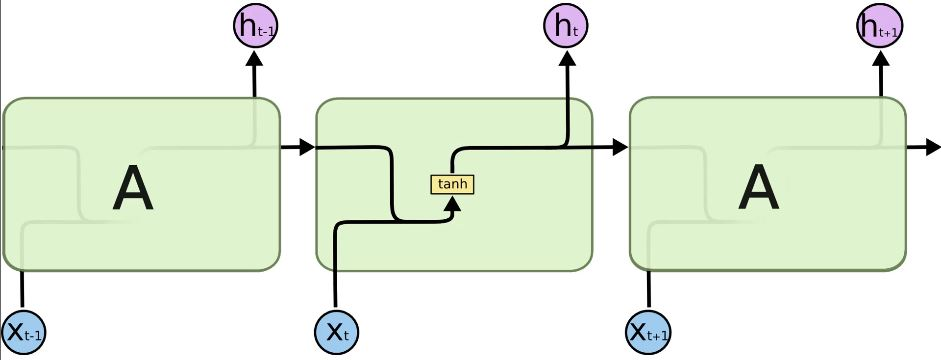</div>
<div>&nbsp;</div>
<div>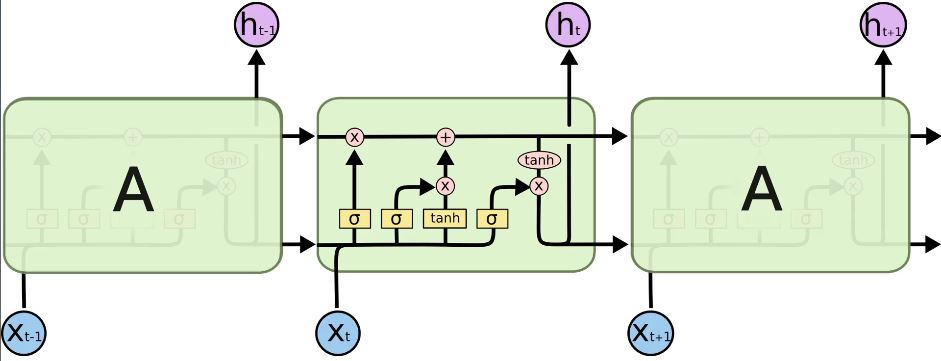</div>

In simplified information, to solve this we make Wrec = 1 (there is more to this actually). The first picture is a normal RNN. The problem lies with that tanh - as backpropagation, it is where the weights are applied / where Wrec is sitting. The second picture is the LSTM. When we say "Wrec=1", that is the top horizontal line which is also called the **memory cell**. It can go through time (time represented as per node) very freely, where sometimes it can be removed / erased with the X button and sometimes things may be added to it with the + button. That is why when you backpropagate you don't have the vanishing gradient.

Let us rephrase our picture. C is memory cell, h is output, X is input. These are all vectors of many numbers. The pointwise operations are called **valves**, with the top left X as forget valve, the middle X as memory valve, and right X as output valve (in literature will see as F / V / O respectively).

<div>&nbsp;</div>
<div>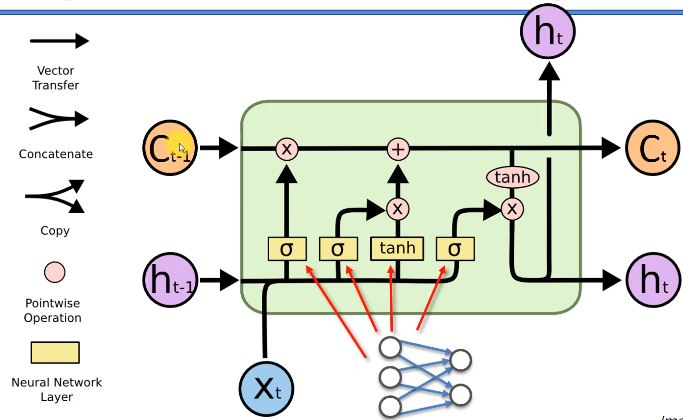</div>

To take it step by step:
- New value Xt coming in. Previous output's value h(t-1) coming in. Together they decide if the first sigmoid should output a value or not.
- Those two combine again to decide if the second sigmoid and tanh should output a value or not and to what extent.
- The C(t-1) flows on top and interacts with the two new results.
- Finally, the two inputs goes through the last sigmoid, and some fuck happens.



Epoch 1/100
38/38 [==============================] - 2s 44ms/step - loss: 0.0330
Epoch 2/100
38/38 [==============================] - 2s 42ms/step - loss: 0.0067
Epoch 3/100
38/38 [==============================] - 2s 43ms/step - loss: 0.0053
Epoch 4/100
38/38 [==============================] - 2s 45ms/step - loss: 0.0051
Epoch 5/100
38/38 [==============================] - 2s 45ms/step - loss: 0.0053
Epoch 6/100
38/38 [==============================] - 2s 45ms/step - loss: 0.0045
Epoch 7/100
38/38 [==============================] - 2s 45ms/step - loss: 0.0052: 0s - loss: 0.
Epoch 8/100
38/38 [==============================] - 2s 47ms/step - loss: 0.0047
Epoch 9/100
38/38 [==============================] - 2s 52ms/step - loss: 0.0046
Epoch 10/100
38/38 [==============================] - 2s 52ms/step - loss: 0.0047
Epoch 11/100
38/38 [==============================] - 2s 52ms/step - loss: 0.0047
Epoch 12/100
38/38 [==============================] - 2s 51ms/step - loss: 0.0043
Epoch 13/1

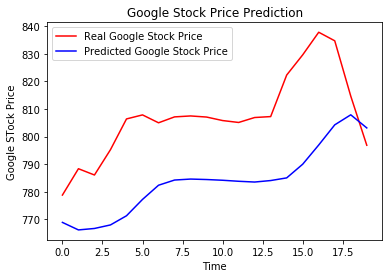

In [2]:
### 1. Libraries

# Normal
import numpy as np # only can read arrays and not DFs
import matplotlib.pyplot as plt
import pandas as pd

# RNN
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout

### 2. Dataset

# Data
dataset_train = pd.read_csv('zzDatasets/Google_Stock_Price_Train.csv')
training_set = dataset_train.iloc[:,1:2].values

# Feature Scaling
from sklearn.preprocessing import MinMaxScaler # RNN always apply normalisation, especially if anytime theres sigmoid, better with normalisation than stdisation
sc = MinMaxScaler(feature_range=(0,1)) # 0,1 because we want it btw 0-1
training_set_scaled = sc.fit_transform(training_set)

# Making Timesteps (if timestep=60, means at time T, model will look at 60 stock prices before T, and use that to predict T)
# we want to make X_train of 60 stock prices, and Y_train the prediction
X_train = []
Y_train = []
for i in range(60,1258):
    X_train.append(training_set_scaled[i-60:i])
    Y_train.append(training_set_scaled[i,0])
X_train, Y_train = np.array(X_train), np.array(Y_train)

# Reshaping the Data (read RNN documentation - input needs to be 3D with shape (batch_size, timesteps, input_dim); batchsize can be len(X) if one by one or some batchsize; inputdim is no. of predictors
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))

### 3. Modelling

# Initialise the RNN
regressor = Sequential()

# Add first LSTM layer + Dropout
regressor.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1],1))) # no. of cells; since got another layer so return=True; input_shape = shape of X_train but just the timestep and no. of indicators
regressor.add(Dropout(0.2)) # dropout rate. 20% is good rate

# Second LSTM layer
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.2))

# Third LSTM layer
regressor.add(LSTM(units=50, return_sequences=True))
regressor.add(Dropout(0.2))

# Fourth LSTM layer (penultimate before output)
regressor.add(LSTM(units=50)) # return_seq=False is default
regressor.add(Dropout(0.2))

# Output layer
regressor.add(Dense(units=1))

# Compiling
regressor.compile(optimizer='adam', loss='mean_squared_error') # good ones are RMSprop or adam

# Fitting the RNN to the Training Set
regressor.fit(X_train, Y_train, epochs=100, batch_size=32)

### 4. Predictions

dataset_test = pd.read_csv('zzDatasets/Google_Stock_Price_Test.csv')
real_stock_price = dataset_test.iloc[:,1:2].values # rea; stock price 2017

dataset_total = pd.concat((dataset_train['Open'], dataset_test['Open']), axis=0) # axis=0 for vertical concat
inputs = dataset_total[len(dataset_total) - len(dataset_test) - 60:].values
inputs = inputs.reshape(-1,1)
inputs = sc.transform(inputs)

X_test = []
for i in range(60,80):
    X_test.append(inputs[i-60:i,0])
X_test = np.array(X_test)
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

predicted_stock_price = regressor.predict(X_test)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)

### 5. Visualisations
plt.plot(real_stock_price, color='red', label='Real Google Stock Price')
plt.plot(predicted_stock_price, color='blue', label='Predicted Google Stock Price')
plt.title('Google Stock Price Prediction')
plt.xlabel('Time')
plt.ylabel('Google STock Price')
plt.legend()
plt.show()

# Chapter 29 - Self Organising Maps

Best for reducing dimensionality. Like the picture below, you transform millions of columns into a 2D representation map. The second picture shows an example where many countries are clustered into groups based on prosperty / poverty indicators (top left best bottom right worst). Third picture uses those colours and put on world map, quite fitting general knowledge.

<div>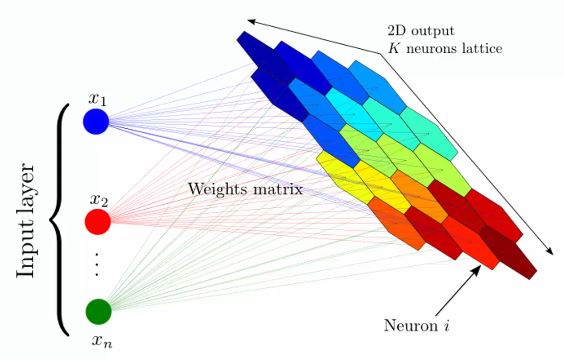</div>
<div>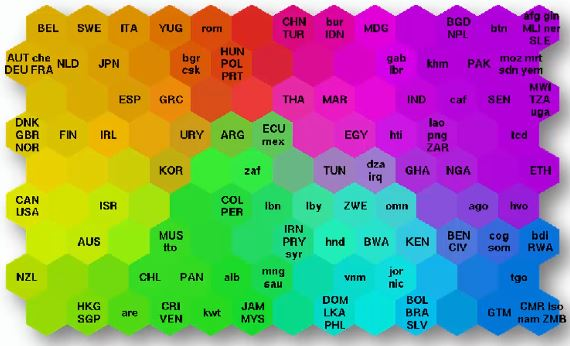</div> 
<div>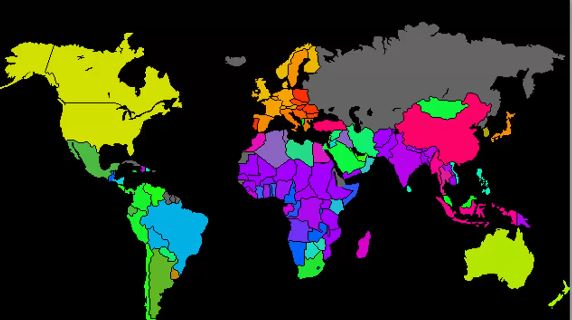</div> 

### Learning Mechanic

We have 3 input nodes and 9 output nodes. It might look simple but don't let it fool you. The input has 3 columns and millions of rows and is actually 3D. The output is 2D.

<div>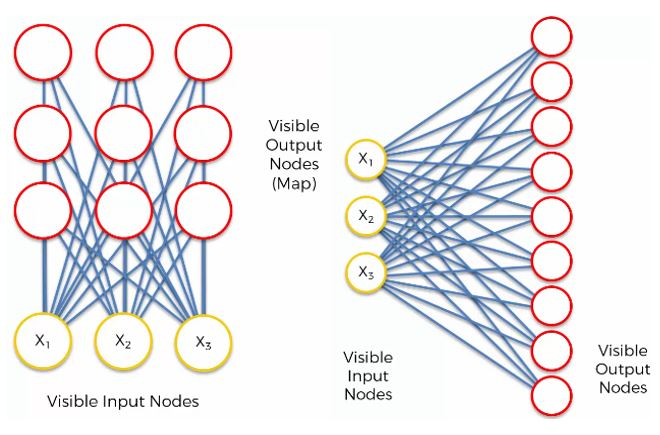</div> 

**NOTE:** The jargon below might have seen before, but actually different meaning in SOMs!

picture

**Weights** have different meaning. They are actually coordinates for the output node. So if there are 3 columns there are 3 input nodes and if 20 columns there are 20 input nodes, but that output node represents a point in the input space which has 3 or 20 weights respectively. These weights are assigned randomly but close to 0 but not 0 (just like KNNs!).

<div>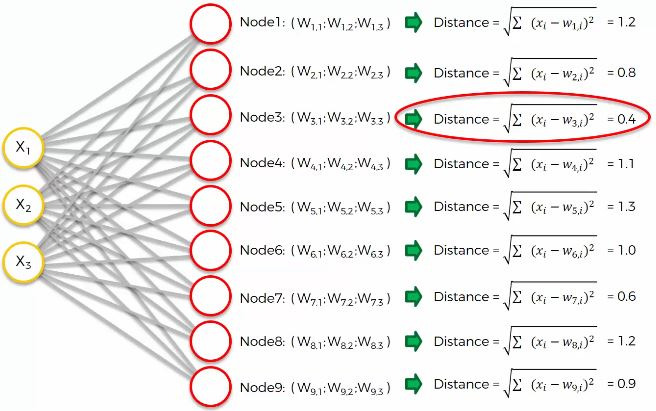</div> 

Now we will have a competition: we are going to go through the rows in the dataset and find out which of the output nodes is closest to each of ours in the dataset. Take each row and calculate it against every output node to get the distance, and choose the smallest distance and that is our **best matching unit (BMU)**.

<div>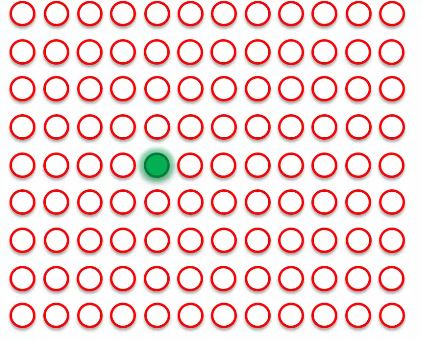</div> 
<div>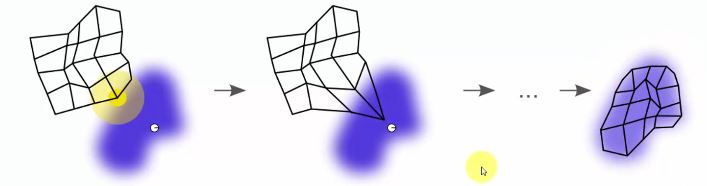</div> 

After finding the BMU for the first row, this BMU's weights will get updated to be even closer to the first row in the dataset (like centroid moving towards). In other words, the SOM is moving closer to the data point. The map self-organises to our input data. Note that some of the closer output nodes are also dragged closer as well.

<div>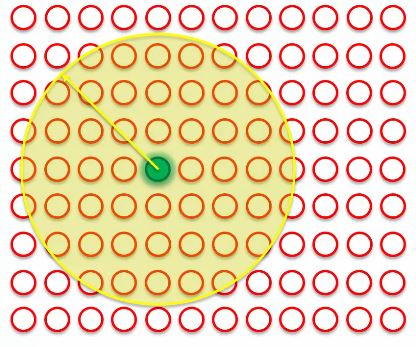</div> 

That is not all - there will be a radius around that BMU, and all these nodes will have their weights updated - the closer they are to the BMU, the bigger the change. AKA the closer you are to the BMU, the harder you get pulled to that row.

<div>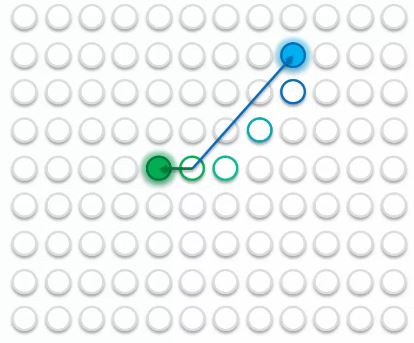</div> 

Repeat. Remember that the closer a node is to a BMU, the harder it gets pulled to that BMU's direction.

After each epoch, the radius become smaller. Hence only the closer nodes to each BMU get pulled only. Thus the process becomes more accurate per epoch.

<ins>Pointers</ins>
- SOMs retain topology of the input set (same shape as inputs)
- SOMs reveal correlations that are not easily identified
- SOMs classify data without supervision
- No target vector = no backpropagation
- No lateral connections between ouput nodes (no connections between output nodes like you see in ANNs, no activation functions etc.)

### Interpretation

Below are SOM of voting results of US Congress members (over 500+ members). Each picture is a Y/N vote on a question they were voting on. The maps then discovered which members of Congress are close and which are dissimilar in voting patterns.

<div>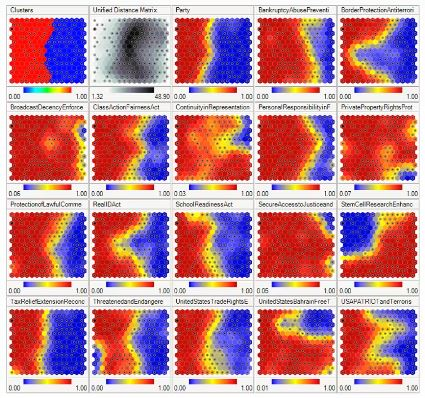</div> 

Watch [video](https://www.udemy.com/course/deeplearning/learn/lecture/6905328#overview).

### Others

<div>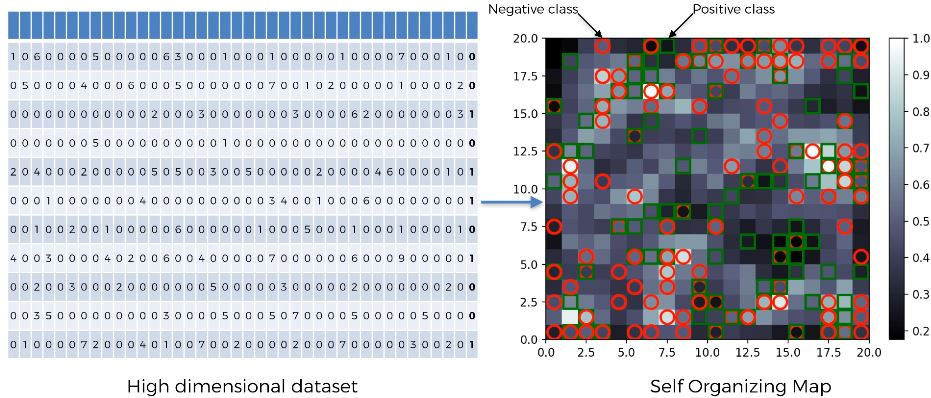</div> 
<div>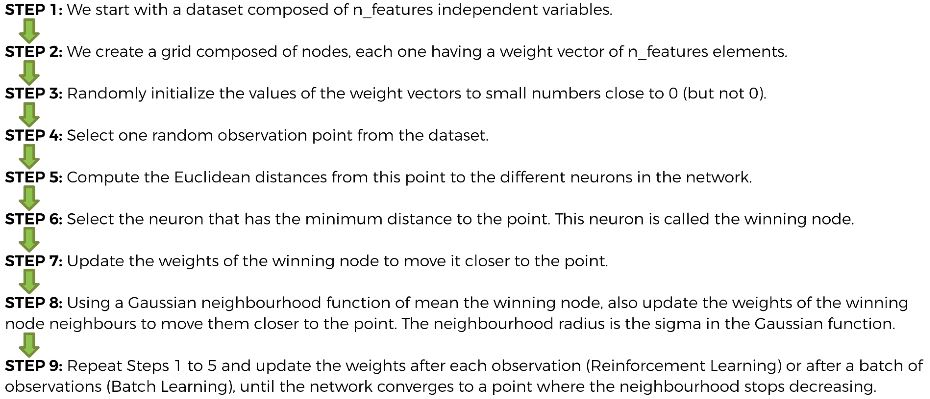</div> 










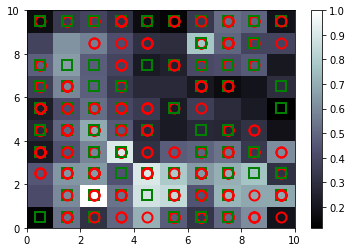

array([[3.91985210e+12, 0.00000000e+00, 2.11315500e+03, 4.20000000e+01,
        5.00000000e+00, 1.40000000e+01, 9.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.00000000e+00, 1.34000000e+02, 1.00000000e+00,
        5.00000000e+00, 4.00000000e+05, 1.06000010e+07],
       [3.92588755e+12, 1.00000000e+00, 1.41557000e+03, 1.15500000e+02,
        3.00000000e+00, 4.00000000e+01, 6.50000000e+01, 1.14000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        5.00000000e+00, 2.80000000e+05, 1.01000010e+07],
       [3.92574046e+12, 0.00000000e+00, 2.35255500e+03, 1.05000000e+02,
        5.00000000e+00, 1.40000000e+01, 9.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.00000000e+00, 4.02000000e+02, 0.00000000e+00,
        5.00000000e+00, 0.00000000e+00, 2.01000010e+07],
       [3.92584360e+12, 1.00000000e+00, 1.31050000e+03, 8.12000000e+00,
        5.00000000e+00, 5.30000000e+01, 3.30000000e+01, 8.26500000e+00,
        0.00000000e+00, 0.00000000e+0

In [16]:
### 1. Libraries

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset

data = pd.read_csv('zzDatasets/Credit_Card_Applications.csv')
X = data.iloc[:, :-1].values
Y = data.iloc[:,-1].values

from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0,1))
sc.fit_transform(X)

### 3. Modelling

from minisom import MiniSom
som = MiniSom(x=10, y=10, input_len=15, sigma=1.0, learning_rate=0.5) # x&y are dimensions of our SOM and are arbitrary; input_len=no of features of X; sigma is radius; decay_f to improve convergence (not used here)
som.random_weights_init(X) # initialise weights
som.train_random(data=X, num_iteration=100) # the method for step 4 to 9 and for iterations

### 4. Visualisation
# MID = mean interneuron distance -> higher it is the more it is outlier cos it's far from general rule
from pylab import bone, pcolor, colorbar, plot, show
bone()
pcolor(som.distance_map().T)
colorbar()
markers = ['o','s']
colors = ['r','g']
for i,x in enumerate(X):
    w = som.winner(x)
    plot(w[0]+0.5,
        w[1]+0.5,
        markers[Y[i]],
        markeredgecolor=colors[Y[i]],
        markerfacecolor='None',
        markersize=10,
        markeredgewidth=2)
show()

### 5. Finding the Frauds
mappings = som.win_map(X)
frauds = np.concatenate((mappings[(8,1)], mappings[(6,8)]), axis=0)
frauds = sc.inverse_transform(frauds)
frauds

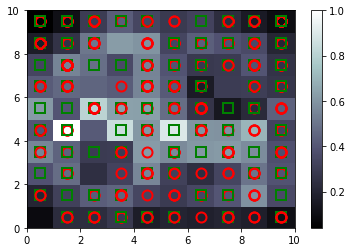

Epoch 1/2
690/690 [==============================] - 1s 793us/step - loss: 0.4316 - accuracy: 0.9971
Epoch 2/2
690/690 [==============================] - 0s 715us/step - loss: 0.1379 - accuracy: 1.0000


array([[1.56430560e+07, 5.57094812e-03],
       [1.56009750e+07, 6.38449192e-03],
       [1.57139830e+07, 6.48319721e-03],
       ...,
       [1.56577780e+07, 3.03799868e-01],
       [1.56825760e+07, 3.03799868e-01],
       [1.56214230e+07, 3.03799868e-01]])

In [10]:
##### Hybrid Deep Learning Model (ANN + SOM)

#### SOM

### 1. Libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

### 2. Dataset
data = pd.read_csv('zzDatasets/Credit_Card_Applications.csv')
X = data.iloc[:, :-1].values
Y = data.iloc[:,-1].values

from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler(feature_range = (0,1))
sc.fit_transform(X)

### 3. Modelling
from minisom import MiniSom
som = MiniSom(x=10, y=10, input_len=15, sigma=1.0, learning_rate=0.5) 
som.random_weights_init(X) 
som.train_random(data=X, num_iteration=100) 

### 4. Visualisation
from pylab import bone, pcolor, colorbar, plot, show
bone()
pcolor(som.distance_map().T)
colorbar()
markers = ['o','s']
colors = ['r','g']
for i,x in enumerate(X):
    w = som.winner(x)
    plot(w[0]+0.5,
        w[1]+0.5,
        markers[Y[i]],
        markeredgecolor=colors[Y[i]],
        markerfacecolor='None',
        markersize=10,
        markeredgewidth=2)
show()

### 5. Finding the Frauds
mappings = som.win_map(X)
frauds = np.concatenate((mappings[(8,1)], mappings[(6,8)]), axis=0)
frauds = sc.inverse_transform(frauds)

#### ANN

### 1. Dataset

customers = data.iloc[:,1:].values # the X

is_fraud = np.zeros(len(data)) # the Y
for i in range(len(data)):
    if data.iloc[i,0] in frauds:
        is_fraud[i] = 1

from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
customers = sc.fit_transform(customers)

### 3. Modelling

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

classifier = Sequential()
classifier.add(Dense(units=2, kernel_initializer='uniform', activation='relu', input_dim=15))
classifier.add(Dense(units=1, kernel_initializer='uniform', activation='sigmoid'))

classifier.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

classifier.fit(customers, is_fraud, batch_size=1, epochs=2)

### 4. Predictions

y_pred = classifier.predict(customers)
y_pred = np.concatenate((data.iloc[:, 0:1].values, y_pred), axis=1)
y_pred = y_pred[y_pred[:,1].argsort()]
y_pred